In [1]:
import os
import pickle
import torch
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import json
import sys
sys.path.append("/Users/yufanxia/Documents/GitHub")
from perturbgene.data_utils import GeneTokenizer, read_h5ad_file
import scanpy as sc

/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
adata = sc.read_h5ad("/Users/yufanxia/Downloads/chunk3562_processed3.h5ad")
adata

/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 10000 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status', 'RBX1_embedding_status', 'FBXO7_embedding_status', 'CUL1_embedding_status', 'PINK1_embedding_status', 'PARK7_embedding_status', 'GIGYF2_embedding_status', 'ATP13A2_embedding_status', 'PRKN_embedding_status', 'PLA2G6_embedding_status', 'SKP1_embedding_status', 'LONP2_embedding_status', 'CNTNAP2_embe

In [20]:
sc.pp.highly_variable_genes(adata,n_top_genes=1000)

In [25]:
var_genes = adata[:,adata.var['highly_variable']].var["feature_name"].to_list()
left = [gene for gene in var_genes if not (gene.startswith("MT") or gene.startswith("RPS") or gene.startswith("RPL"))]
[gene for gene in left if gene.startswith("IG")]

['IGHG2',
 'IGKV1-5',
 'IGLC3',
 'IGKV4-1',
 'IGLV1-51',
 'IGHG4',
 'IGHM',
 'IGLC2',
 'IGLL5',
 'IGKV3-20',
 'IGKV3-11',
 'IGHG1',
 'IGLV3-21',
 'IGLV2-14',
 'IGHV4-59',
 'IGKV3-15',
 'IGHV1-18',
 'IGHV3-7',
 'IGLV1-44',
 'IGLV3-1',
 'IGLV2-11',
 'IGHA1',
 'IGHV3-21',
 'IGKV2D-28',
 'IGLV3-25',
 'IGHG3',
 'IGKV1-17',
 'IGKV3D-20',
 'IGHV3-11',
 'IGLV2-23',
 'IGKC',
 'IGLV8-61',
 'IGHV1-3',
 'IGLV4-69',
 'IGHV4-39',
 'IGLV1-47',
 'IGHA2',
 'IGLV6-57',
 'IGKV1-9',
 'IGHV2-5',
 'IGKV1-12',
 'IGHV5-10-1',
 'IGHV2-26',
 'IGLV3-19',
 'IGLV7-46',
 'IGHV3-15',
 'IGHV3-48',
 'IGHV1-2',
 'IGLV3-10',
 'IGKV1D-33',
 'IGHV1-24',
 'IGHV3-30',
 'IGHV3-23',
 'IGHV3-73',
 'IGHV4-34',
 'IGKV2-28',
 'IGHV5-51',
 'IGHV1-46',
 'IGHV4-61',
 'IGLV3-9',
 'IGHV4-4',
 'IGHV3-66',
 'IGHD',
 'IGLV1-36',
 'IGKV1D-43',
 'IGHV4-28',
 'IGHV3-33',
 'IGKV1-33',
 'IGHV4-31',
 'IGHV3-53',
 'IGHV3-13',
 'IGKV1-8',
 'IGKV6D-21',
 'IGKV1D-8',
 'IGLV7-43',
 'IGHGP',
 'IGLV3-16',
 'IGFBP5',
 'IGLV5-52',
 'IGF2',
 'IGDCC3']

In [36]:
expression_mask = adata.X > 0.1
gene_counts = np.sum(expression_mask, axis=0)
genes_to_keep = gene_counts >= 100
gene_names = adata.var["feature_name"]
exclude_genes = gene_names.str.startswith(('RP', 'MT'))
genes_to_keep &= (~exclude_genes).tolist()
filtered_adata = adata[:, genes_to_keep].copy()
filtered_adata

AnnData object with n_obs × n_vars = 10000 × 17114
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'FBXL19_embeddings', 'GSK3A_embeddings', 'TRAF5_embeddi

### RBX1, FBX07, CUL1, SKP1, PINK1, PARK7, GIGYF2, ATP13A2, PRKN, PLA2G6

In [49]:
"CUL1" in filtered_adata.var["feature_name"].to_list()

True

In [2]:
with open('/Users/yufanxia/Downloads/chunk3562_10000_age.pkl', 'rb') as f:
    age_embs = pickle.load(f)
len(age_embs)

10000

In [3]:
#predicted age labels
with open('/Users/yufanxia/Downloads/chunk3562_age.json', 'r') as f:
    loaded_mapping = json.load(f)

In [4]:
expected_tokenizer_path = "/Users/yufanxia/Downloads/checkpoint-1060000/tokenizer.pkl"
with open(expected_tokenizer_path, "rb") as f:
    tokenizer = pickle.load(f)
config = tokenizer.config
validation_data = read_h5ad_file("/Users/yufanxia/Downloads/cxg_chunk3562.h5ad", config.num_top_genes)
validation_data

/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


View of AnnData object with n_obs × n_vars = 10000 × 58604
    obs: 'soma_joinid', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'

In [51]:
validation_data.obs["development_stage"]

soma_joinid
27387386                     29-year-old human stage
46492259                      6-year-old human stage
53966434                     49-year-old human stage
3060050                     11-month-old human stage
39447246    17th week post-fertilization human stage
                              ...                   
40379221                     7-month-old human stage
32787844                     67-year-old human stage
3739413                      76-year-old human stage
56242973    17th week post-fertilization human stage
49468748                     28-year-old human stage
Name: development_stage, Length: 10000, dtype: category
Categories (136, object): ['1-month-old human stage', '1-year-old human stage', '2-5 year-old child stage', '2-month-old human stage', ..., 'sixth decade human stage', 'third decade human stage', 'unknown', 'young adult stage']

In [52]:
validation_data.obs["disease"]

soma_joinid
27387386                                 normal
46492259                               COVID-19
53966434                                 normal
3060050     B-cell acute lymphoblastic leukemia
39447246                                 normal
                           ...                 
40379221                                 normal
32787844                         adenocarcinoma
3739413                       Parkinson disease
56242973                                 normal
49468748                                 normal
Name: disease, Length: 10000, dtype: category
Categories (44, object): ['Alzheimer disease', 'B-cell acute lymphoblastic leukemia', 'COVID-19', 'Crohn disease', ..., 'systemic lupus erythematosus', 'temporal lobe epilepsy', 'trisomy 18', 'type 2 diabetes mellitus']

In [4]:
def label_to_float(label):
    label = label.replace("_"," ").replace("-",' ')
    if 'year' in label:
        if "-" in label:
            return float(label.split(' ')[0])
        elif label == "under 1 year old human stage":
            return 1.0
        else:
            return float(label.split(' ')[0])
    elif 'month' in label:
        # Convert month to weeks (approximate)
        if "LMP" not in label:
            return float(label.split(' ')[0])/12
        elif label == "eighth LMP month human stage":
            return 8/12
        elif label == "fifth LMP month human stage":
            return 5/12
        # Add more cases as needed
    elif 'week' in label:
        return float(label.split(" ")[0].replace("th",'').replace("st",""))/52
    return -1.0

In [54]:
label_to_float('80 year')

80.0

In [6]:
ground_truth = [label_to_float(label) for label in loaded_mapping["ground_truth"]]
prediction = [label_to_float(label) for label in loaded_mapping["predictions"]]

### Age prediction

In [56]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import pearsonr

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/3791227439.py:24: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.96


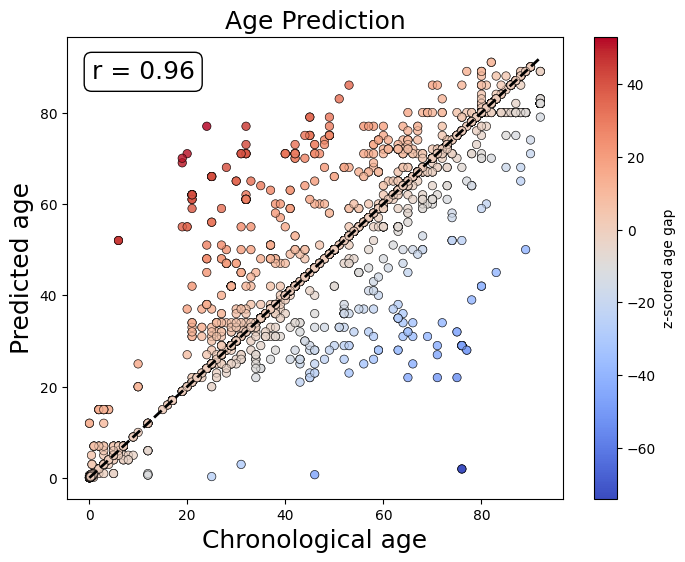

In [57]:
y_test, y_pred = zip(*[(x, y) for x, y in zip(ground_truth, prediction) if x != -1.0 and y != -1.0])

y_test = np.array(list(y_test))
y_pred = np.array(list(y_pred))

# Calculate Pearson correlation
r, _ = pearsonr(y_test, y_pred)
print(f'Pearson correlation (r): {r:.2f}')

# Calculate the z-scored age gap (difference between predicted and true age)
age_gap = y_pred - y_test

# Plot results using seaborn
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_pred, hue=age_gap, palette='coolwarm', edgecolor='k', alpha=0.6, legend=False)  # legend=False to remove legend

# Plot the identity line (y = x)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)

# Add color bar for age gap
norm = plt.Normalize(age_gap.min(), age_gap.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
plt.colorbar(sm, label='z-scored age gap')

# Add labels and title
plt.xlabel('Chronological age',fontsize=18)
plt.ylabel('Predicted age',fontsize=18)
plt.title(f'Age Prediction',fontsize=18)

# Add Pearson correlation (r) as text on the plot
plt.text(0.05, 0.95, f'r = {r:.2f}', transform=plt.gca().transAxes, 
         fontsize=18, verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

plt.show()

### r2 scores for different tissues

In [58]:
tissue_r = {}
for tissue in set(validation_data.obs["tissue"].to_list()):
    filtered_pairs = [
        (ground_truth[i], prediction[i]) 
        for i in range(len(ground_truth)) 
        if ground_truth[i] != -1.0 and prediction[i] != -1.0 and validation_data.obs["tissue"].to_list()[i] == tissue
    ]

    # Check if there are any valid pairs before unpacking
    if not filtered_pairs:
        print(f"tissue: {tissue}, No valid data after filtering.")
        tissue_r[tissue] = -100.0
    else:
        y_test, y_pred = zip(*filtered_pairs)
        if len(set(y_test)) == 1 or len(set(y_pred)) == 1:
            print(f"tissue: {tissue}, An input array is constant.")
            tissue_r[tissue] = -100.0
        else:
            y_test = np.array(list(y_test))
            y_pred = np.array(list(y_pred))
            
            # Calculate Pearson correlation
            r, _ = pearsonr(y_test, y_pred)
            print(f'tissue: {tissue}, Pearson correlation (r): {r:.2f}')
            tissue_r[tissue] = r

tissue: liver, No valid data after filtering.
tissue: parietal cortex, Pearson correlation (r): 1.00
tissue: lung parenchyma, Pearson correlation (r): 1.00
tissue: cornea, Pearson correlation (r): 0.94
tissue: bone marrow, No valid data after filtering.
tissue: isthmus of fallopian tube, An input array is constant.
tissue: temporal cortex, An input array is constant.
tissue: colonic epithelium, No valid data after filtering.
tissue: hippocampal formation, Pearson correlation (r): 1.00
tissue: heart left ventricle, No valid data after filtering.
tissue: lamina propria of small intestine, Pearson correlation (r): 1.00
tissue: transition zone of prostate, An input array is constant.


KeyboardInterrupt: 

In [ ]:
for tissue, r in tissue_r.items():
    if r == 1.0 :
        print(tissue, validation_data.obs["tissue"].to_list().count(tissue))

parietal cortex 52
primary auditory cortex 4
peripheral region of retina 19
prefrontal cortex 20
duodenum 4
lung parenchyma 26
iris 20
lamina propria of small intestine 63


In [ ]:
validation_data[validation_data.obs["tissue"] == "spleen"]

View of AnnData object with n_obs × n_vars = 119 × 58604
    obs: 'soma_joinid', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'

In [ ]:
output_folder = "tissue_plots"
os.makedirs(output_folder, exist_ok=True)

# Get unique tissues
unique_tissues = validation_data.obs["tissue"].unique()

for tissue in unique_tissues:
    filtered_data = [
        (ground_truth[i], prediction[i]) 
        for i in range(len(ground_truth)) 
        if ground_truth[i] != -1.0 and prediction[i] != -1.0 and validation_data.obs["tissue"].to_list()[i] == tissue
    ]

    # Check if there is enough data
    if len(filtered_data) == 0:
        print(f"No data available for tissue: {tissue}. No plot will be generated.")
        continue

    # Unzip filtered data into y_test and y_pred
    y_test, y_pred = zip(*filtered_data)
    y_test = np.array(list(y_test))
    y_pred = np.array(list(y_pred))

    # Calculate Pearson correlation
    r, _ = pearsonr(y_test, y_pred)
    print(f'Pearson correlation (r): {r:.2f}')

    # Calculate the z-scored age gap (difference between predicted and true age)
    age_gap = y_pred - y_test

    # Plot results using seaborn
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=y_test, y=y_pred, hue=age_gap, palette='coolwarm', edgecolor='k', alpha=0.6, legend=False)  # legend=False to remove legend

    # Plot the identity line (y = x)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)

    # Add color bar for age gap
    norm = plt.Normalize(age_gap.min(), age_gap.max())
    sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
    sm.set_array([])
    plt.colorbar(sm, label='z-scored age gap')

    # Add labels and title
    plt.xlabel('Chronological age',fontsize=18)
    plt.ylabel('Predicted age',fontsize=18)
    plt.title(f'Age Prediction for {tissue}', fontsize=18)

    # Add Pearson correlation (r) as text on the plot
    plt.text(0.05, 0.95, f'r = {r:.2f}', transform=plt.gca().transAxes, 
            fontsize=18, verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

    output_path = os.path.join(output_folder, f'{tissue.replace(" ", "_")}_age_prediction.png')
    plt.savefig(output_path)
    plt.close()

Pearson correlation (r): 0.94


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.87


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: spleen. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: lamina propria of mucosa of colon. No plot will be generated.
Pearson correlation (r): 0.94


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.20


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: esophagus muscularis mucosa. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.89


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.91


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): -0.17


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: bone marrow. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.74


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.50


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.62


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.62


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.83


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label=

Pearson correlation (r): nan
No data available for tissue: skin of leg. No plot will be generated.
Pearson correlation (r): 0.98


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.89


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.91


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: yolk sac. No plot will be generated.
Pearson correlation (r): 0.99


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.99


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: placenta. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
Pearson correlation (r): 0.61


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): -0.15


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: forebrain. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
No data available for tissue: small intestine. No plot will be generated.
No data available for tissue: brain. No plot will be generated.
Pearson correlation (r): 0.58


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: interventricular septum. No plot will be generated.
Pearson correlation (r): 0.89


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.94


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.72


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: caudate lobe of liver. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label=

Pearson correlation (r): nan
Pearson correlation (r): 0.26


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: jejunal epithelium. No plot will be generated.
No data available for tissue: liver. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
No data available for tissue: heart left ventricle. No plot will be generated.
No data available for tissue: renal medulla. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label=

Pearson correlation (r): nan
Pearson correlation (r): 0.10


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: left colon. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
No data available for tissue: nasal cavity. No plot will be generated.
No data available for tissue: colon. No plot will be generated.
No data available for tissue: lamina propria. No plot will be generated.
No data available for tissue: right colon. No plot will be generated.
No data available for tissue: frontal lobe. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.90


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: ileal epithelium. No plot will be generated.
No data available for tissue: prostate gland. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label=

Pearson correlation (r): nan
No data available for tissue: basal ganglion. No plot will be generated.
Pearson correlation (r): 0.71


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: heart right ventricle. No plot will be generated.
Pearson correlation (r): 1.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: decidua. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): nan
No data available for tissue: sigmoid colon. No plot will be generated.
Pearson correlation (r): 0.98


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label=

Pearson correlation (r): 0.00


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.00
Pearson correlation (r): -0.15


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


No data available for tissue: left cardiac atrium. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.00
No data available for tissue: apex of heart. No plot will be generated.
No data available for tissue: transverse colon. No plot will be generated.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:25: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, _ = pearsonr(y_test, y_pred)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/2522464419.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


Pearson correlation (r): 0.00
No data available for tissue: colonic epithelium. No plot will be generated.
No data available for tissue: right cardiac atrium. No plot will be generated.


In [ ]:
min_tissue = [i for i in tissue_r.values() if i != -100.0]
min = np.array(min_tissue).min() 
print(min, list(tissue_r.keys())[list(tissue_r.values()).index(min)])

-0.17486722552629014 cortex of kidney


Pearson correlation (r): -0.17


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1068/2714639028.py:28: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


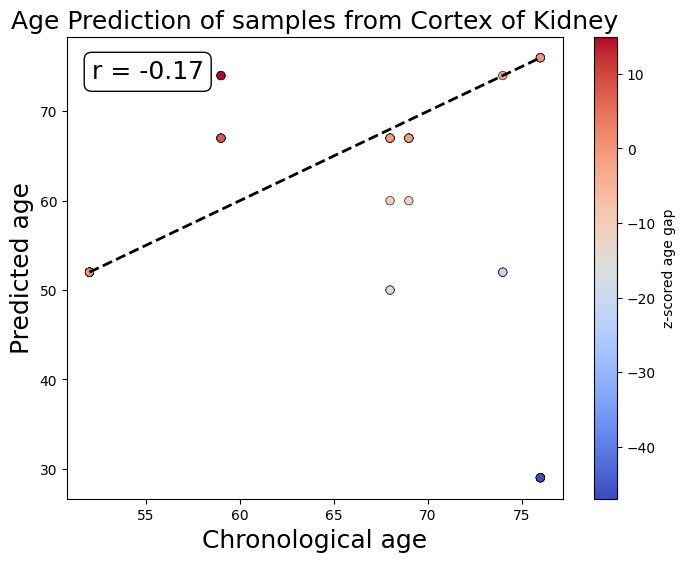

In [ ]:
y_test, y_pred = zip(*[
    (ground_truth[i], prediction[i]) 
    for i in range(len(ground_truth)) 
    if ground_truth[i] != -1.0 and prediction[i] != -1.0 and validation_data.obs["tissue"].to_list()[i] == "cortex of kidney"
])

y_test = np.array(list(y_test))
y_pred = np.array(list(y_pred))

# Calculate Pearson correlation
r, _ = pearsonr(y_test, y_pred)
print(f'Pearson correlation (r): {r:.2f}')

# Calculate the z-scored age gap (difference between predicted and true age)
age_gap = y_pred - y_test

# Plot results using seaborn
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_pred, hue=age_gap, palette='coolwarm', edgecolor='k', alpha=0.6, legend=False)  # legend=False to remove legend

# Plot the identity line (y = x)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)

# Add color bar for age gap
norm = plt.Normalize(age_gap.min(), age_gap.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
plt.colorbar(sm, label='z-scored age gap')

# Add labels and title
plt.xlabel('Chronological age',fontsize=18)
plt.ylabel('Predicted age',fontsize=18)
plt.title(f'Age Prediction of samples from Cortex of Kidney',fontsize=18)

# Add Pearson correlation (r) as text on the plot
plt.text(0.05, 0.95, f'r = {r:.2f}', transform=plt.gca().transAxes, 
         fontsize=18, verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

plt.show()

### only healthy samples

Pearson correlation (r): 0.96


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1068/1801171650.py:28: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


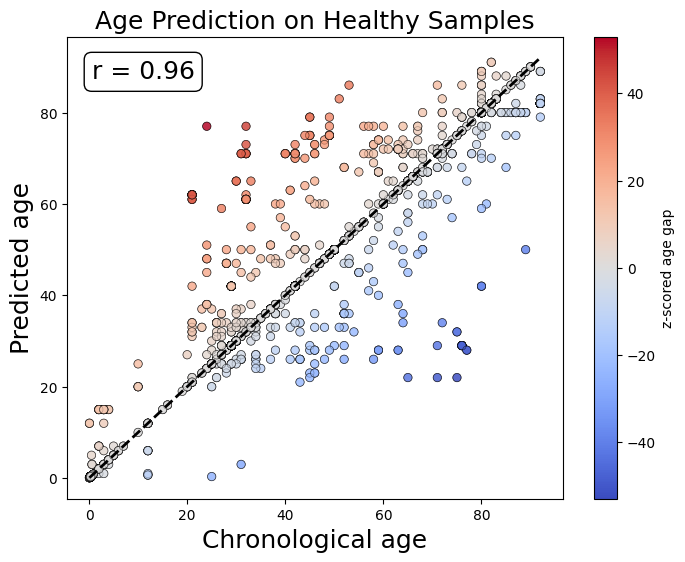

In [ ]:
y_test, y_pred = zip(*[
    (ground_truth[i], prediction[i]) 
    for i in range(len(ground_truth)) 
    if ground_truth[i] != -1.0 and prediction[i] != -1.0 and validation_data.obs["disease"].to_list()[i] == "normal"
])

y_test = np.array(list(y_test))
y_pred = np.array(list(y_pred))

# Calculate Pearson correlation
r, _ = pearsonr(y_test, y_pred)
print(f'Pearson correlation (r): {r:.2f}')

# Calculate the z-scored age gap (difference between predicted and true age)
age_gap = y_pred - y_test

# Plot results using seaborn
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_pred, hue=age_gap, palette='coolwarm', edgecolor='k', alpha=0.6, legend=False)  # legend=False to remove legend

# Plot the identity line (y = x)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)

# Add color bar for age gap
norm = plt.Normalize(age_gap.min(), age_gap.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
plt.colorbar(sm, label='z-scored age gap')

# Add labels and title
plt.xlabel('Chronological age',fontsize=18)
plt.ylabel('Predicted age',fontsize=18)
plt.title(f'Age Prediction on Healthy Samples',fontsize=18)

# Add Pearson correlation (r) as text on the plot
plt.text(0.05, 0.95, f'r = {r:.2f}', transform=plt.gca().transAxes, 
         fontsize=18, verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

plt.show()

### only unhealthy diseases

Pearson correlation (r): 0.95


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/1661724047.py:28: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='z-scored age gap')


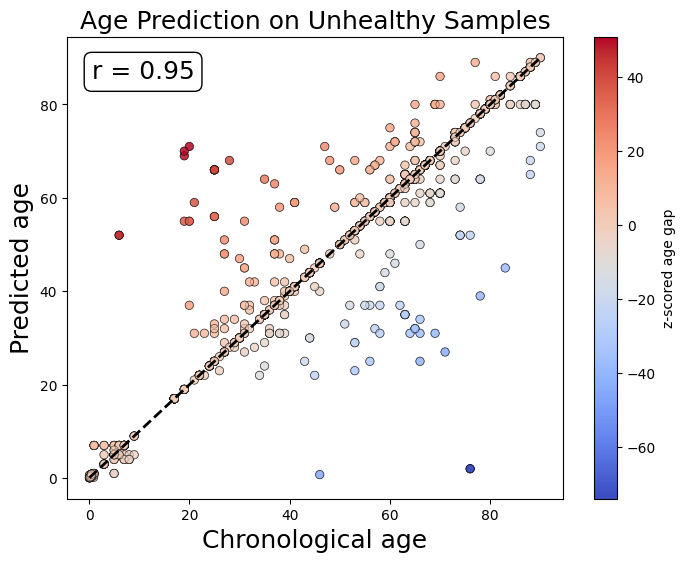

In [ ]:
y_test, y_pred = zip(*[
    (ground_truth[i], prediction[i]) 
    for i in range(len(ground_truth)) 
    if ground_truth[i] != -1.0 and prediction[i] != -1.0 and validation_data.obs["disease"].to_list()[i] != "normal"
])

y_test = np.array(list(y_test))
y_pred = np.array(list(y_pred))

# Calculate Pearson correlation
r, _ = pearsonr(y_test, y_pred)
print(f'Pearson correlation (r): {r:.2f}')

# Calculate the z-scored age gap (difference between predicted and true age)
age_gap = y_pred - y_test

# Plot results using seaborn
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_pred, hue=age_gap, palette='coolwarm', edgecolor='k', alpha=0.6, legend=False)  # legend=False to remove legend

# Plot the identity line (y = x)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)

# Add color bar for age gap
norm = plt.Normalize(age_gap.min(), age_gap.max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
plt.colorbar(sm, label='z-scored age gap')

# Add labels and title
plt.xlabel('Chronological age',fontsize=18)
plt.ylabel('Predicted age',fontsize=18)
plt.title(f'Age Prediction on Unhealthy Samples',fontsize=18)

# Add Pearson correlation (r) as text on the plot
plt.text(0.05, 0.95, f'r = {r:.2f}', transform=plt.gca().transAxes, 
         fontsize=18, verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="black"))

plt.show()

### Age gap (difference) analysis

In [ ]:
from collections import defaultdict
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
ground_truth = loaded_mapping["ground_truth"]
predictions = loaded_mapping["predictions"]
# Get unique labels in ground truth
unique_labels = set(ground_truth)

# Calculate accuracy for each label
label_accuracy = {}
for label in unique_labels:
    total = sum(1 for gt in ground_truth if gt == label)
    correct = sum(1 for gt, pred in zip(ground_truth, predictions) if gt == label and pred == label)
    accuracy = correct / total
    label_accuracy[label] = [accuracy, sum(1 for element in ground_truth if element == label)]

low_acc = []
# Print out each label and its accuracy
for label, accuracy in label_accuracy.items():
    print(f'Label: {label}, Accuracy: {accuracy[0]:.2f}')
    if accuracy[0] <= 0.5 and accuracy[1] > 50:
        low_acc.append(label)
print(low_acc)

Label: sixth_decade_human_stage, Accuracy: 0.85
Label: 10th_week_post-fertilization_human_stage, Accuracy: 0.00
Label: fifth_LMP_month_human_stage, Accuracy: 1.00
Label: 22-year-old_human_stage, Accuracy: 1.00
Label: 70-year-old_human_stage, Accuracy: 0.59
Label: 76-year-old_human_stage, Accuracy: 0.39
Label: 12-year-old_human_stage, Accuracy: 0.48
Label: 52-year-old_human_stage, Accuracy: 0.47
Label: eighth_LMP_month_human_stage, Accuracy: 1.00
Label: 17th_week_post-fertilization_human_stage, Accuracy: 0.65
Label: eighth_decade_human_stage, Accuracy: 0.67
Label: 83-year-old_human_stage, Accuracy: 0.81
Label: 75-year-old_human_stage, Accuracy: 0.78
Label: 58-year-old_human_stage, Accuracy: 0.23
Label: 3-year-old_human_stage, Accuracy: 0.55
Label: 2-year-old_human_stage, Accuracy: 0.42
Label: 9th_week_post-fertilization_human_stage, Accuracy: 0.90
Label: adolescent_stage, Accuracy: 0.33
Label: embryonic_human_stage, Accuracy: 0.00
Label: 41-year-old_human_stage, Accuracy: 0.80
Label: 61

In [ ]:
ordered_labels = [
    '12th week post-fertilization human stage',  # Youngest
    '6-month-old human stage',
    '21-year-old human stage',
    '27-year-old human stage',
    '32-year-old human stage',
    '38-year-old human stage',
    '63-year-old human stage',
    '65-year-old human stage',
    '68-year-old human stage',
    '73-year-old human stage',
    '76-year-old human stage',
    '92-year-old human stage'  # Oldest
]

In [ ]:
df_filtered[df_filtered.Label == '12th week post-fertilization human stage']

,Ground Truth,Prediction,Age Gap,Z-Score,Label
49,0.230769,0.288462,0.057692,0.018238,12th week post-fertilization human stage
59,0.230769,0.230769,0.000000,0.014158,12th week post-fertilization human stage
79,0.230769,0.326923,0.096154,0.020957,12th week post-fertilization human stage
162,0.230769,0.230769,0.000000,0.014158,12th week post-fertilization human stage
191,0.230769,0.307692,0.076923,0.019597,12th week post-fertilization human stage
...,...,...,...,...,...
9746,0.230769,0.326923,0.096154,0.020957,12th week post-fertilization human stage
9798,0.230769,0.307692,0.076923,0.019597,12th week post-fertilization human stage
9820,0.230769,0.230769,0.000000,0.014158,12th week post-fertilization human stage
9919,0.230769,0.326923,0.096154,0.020957,12th week post-fertilization human stage


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/4011003829.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']


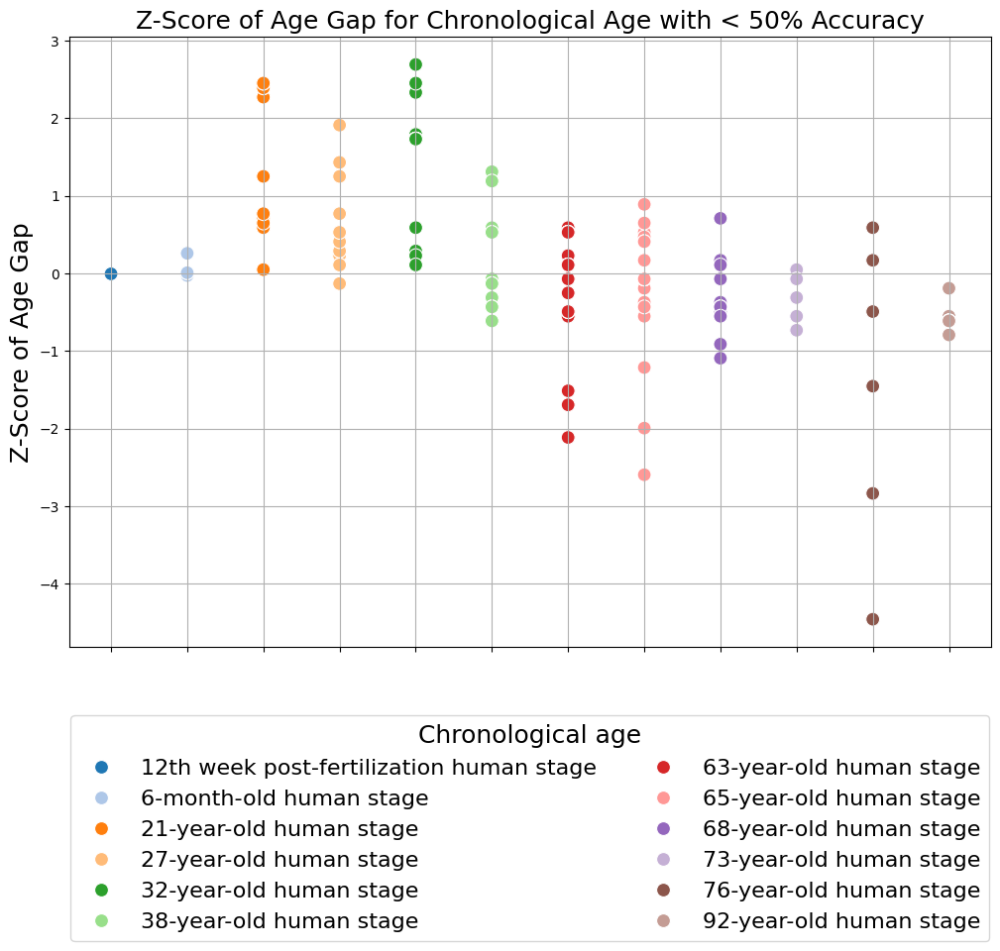

In [ ]:
ground_truth = [label_to_float(label) for label in loaded_mapping["ground_truth"]]
predictions = [label_to_float(label) for label in loaded_mapping["predictions"]]
labels_with_low_accuracy = [label_to_float(label) for label in low_acc if label_to_float(label) != -1.0] # Labels with low accuracy
map_idx = {}
for i in range(len(low_acc)):
    map_idx[labels_with_low_accuracy[i]] = low_acc[i].replace("_"," ")

df = pd.DataFrame({
    'Ground Truth': ground_truth,
    'Prediction': predictions
})

df = df[df['Prediction'] != -1]


# Filter the DataFrame to only include rows where the ground truth matches the labels with low accuracy
df_filtered = df[df['Ground Truth'].isin(labels_with_low_accuracy)]

# Calculate age gaps for the filtered labels
df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']
df_filtered = df_filtered[df_filtered['Age Gap'] != 0]

# Calculate z-scores
mean_gap = df_filtered['Age Gap'].mean()
std_gap = df_filtered['Age Gap'].std()
df_filtered['Z-Score'] = (df_filtered['Age Gap'] - mean_gap) / std_gap

df_filtered['Label'] = df_filtered['Ground Truth'].map(map_idx)

df_filtered['Label'] = pd.Categorical(df_filtered['Label'], categories=[label for label in ordered_labels], ordered=True)

# Create a DataFrame for plotting
df_plot = pd.DataFrame({
    'Label': df_filtered['Label'],
    'Z-Score': df_filtered['Z-Score']
})

plt.figure(figsize=(12, 8))
ax = sns.scatterplot(data=df_plot, x='Label', y='Z-Score', hue='Label', palette='tab20', legend="full",s=100)
ax.set(xticklabels=[])
sns.move_legend(ax, "lower center", bbox_to_anchor=(0.5, -0.5), ncol=2, title="Chronological age", title_fontsize = 18, fontsize=16)

# Adjust x-axis labels
plt.xlabel('')
plt.ylabel('Z-Score of Age Gap',fontsize=18)
plt.title('Z-Score of Age Gap for Chronological Age with < 50% Accuracy',fontsize=18)
plt.grid(True)
plt.show()

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1136/3237755599.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(data=df_plot, x='Label', y='Z-Score', palette='tab20')


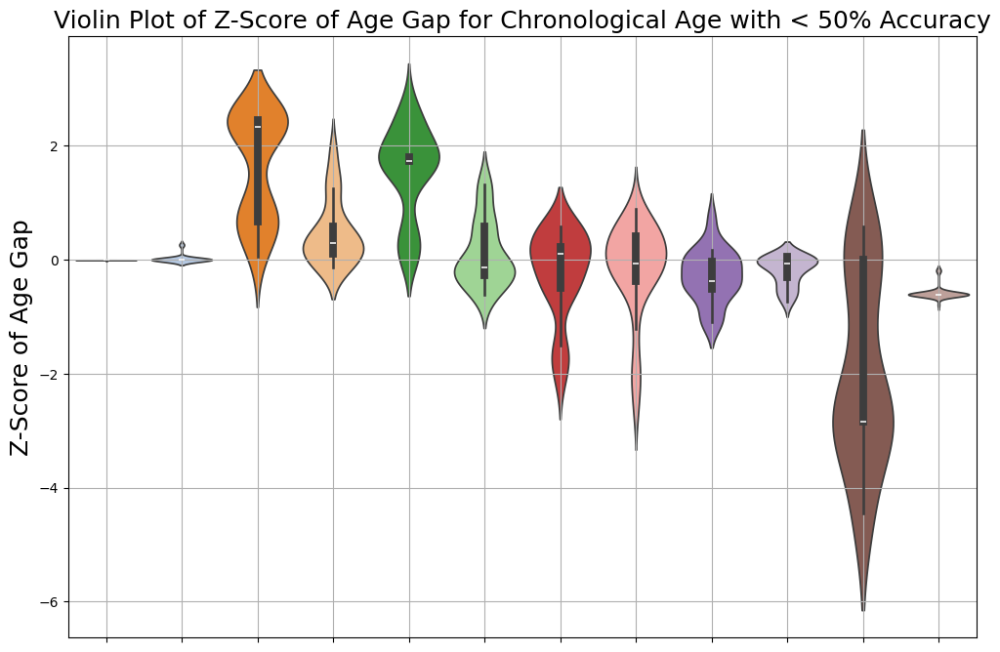

In [ ]:
df_plot = pd.DataFrame({
    'Label': df_filtered['Label'],
    'Z-Score': df_filtered['Z-Score']
})

plt.figure(figsize=(12, 8))
ax = sns.violinplot(data=df_plot, x='Label', y='Z-Score', palette='tab20')

# Adjust the x-axis labels
ax.set(xticklabels=[])
plt.xlabel('')
plt.ylabel('Z-Score of Age Gap', fontsize=18)
plt.title('Violin Plot of Z-Score of Age Gap for Chronological Age with < 50% Accuracy', fontsize=18)

# Add grid and show plot
plt.grid(True)
plt.show()


In [ ]:
df_filtered[df_filtered.Label == "12th week post-fertilization human stage"].sort_values(by=['Z-Score'])

,Ground Truth,Prediction,Age Gap,Z-Score,Label
668,0.230769,0.269231,0.038462,-2.797946,12th week post-fertilization human stage
5395,0.230769,0.269231,0.038462,-2.797946,12th week post-fertilization human stage
49,0.230769,0.288462,0.057692,-1.605922,12th week post-fertilization human stage
6693,0.230769,0.288462,0.057692,-1.605922,12th week post-fertilization human stage
6664,0.230769,0.288462,0.057692,-1.605922,12th week post-fertilization human stage
...,...,...,...,...,...
5415,0.230769,0.326923,0.096154,0.778127,12th week post-fertilization human stage
5334,0.230769,0.326923,0.096154,0.778127,12th week post-fertilization human stage
5192,0.230769,0.326923,0.096154,0.778127,12th week post-fertilization human stage
6892,0.230769,0.326923,0.096154,0.778127,12th week post-fertilization human stage


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1136/601139094.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']


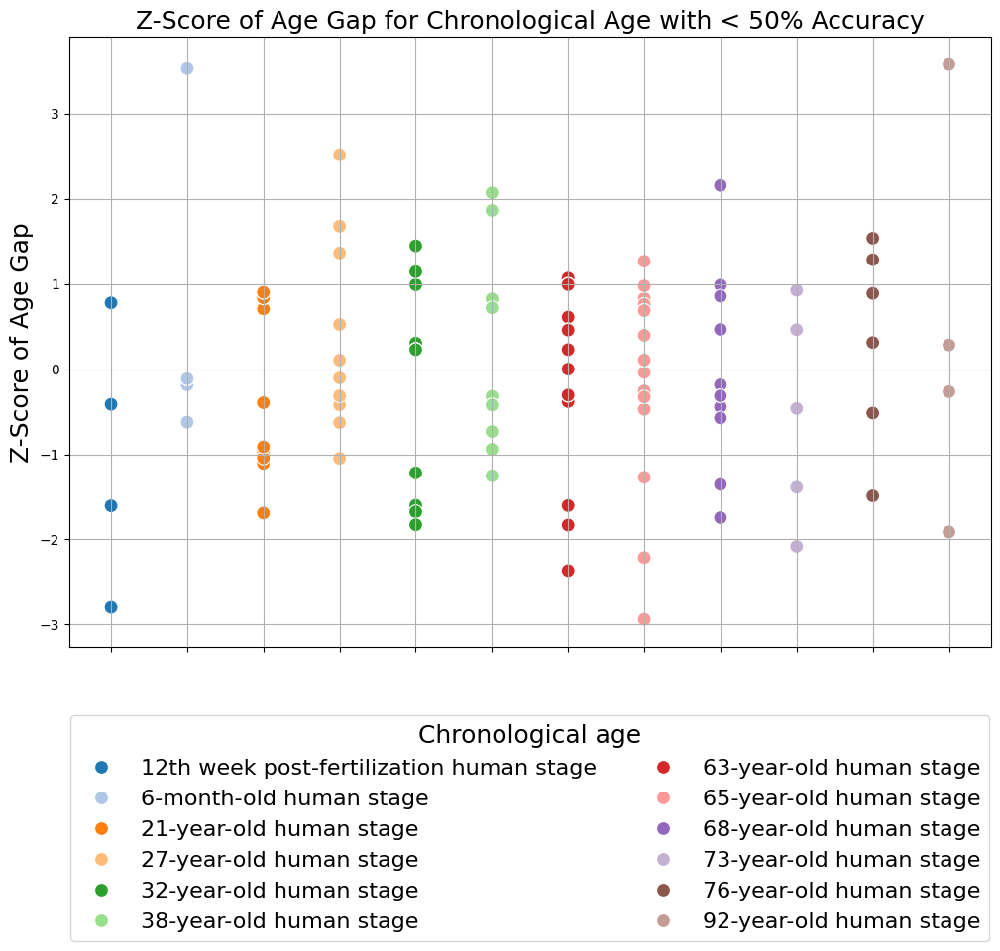

In [ ]:
ground_truth = [label_to_float(label) for label in loaded_mapping["ground_truth"]]
predictions = [label_to_float(label) for label in loaded_mapping["predictions"]]
labels_with_low_accuracy = [label_to_float(label) for label in low_acc if label_to_float(label) != -1.0] # Labels with low accuracy
map_idx = {}
for i in range(len(low_acc)):
    map_idx[labels_with_low_accuracy[i]] = low_acc[i].replace("_"," ")

df = pd.DataFrame({
    'Ground Truth': ground_truth,
    'Prediction': predictions
})

df = df[df['Prediction'] != -1]


# Filter the DataFrame to only include rows where the ground truth matches the labels with low accuracy
df_filtered = df[df['Ground Truth'].isin(labels_with_low_accuracy)]

# Calculate age gaps for the filtered labels
df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']
df_filtered = df_filtered[df_filtered['Age Gap'] != 0]

df_filtered['Z-Score'] = df_filtered.groupby('Ground Truth')['Age Gap'].transform(
    lambda x: (x - x.mean()) / x.std()
)


df_filtered['Label'] = df_filtered['Ground Truth'].map(map_idx)

df_filtered['Label'] = pd.Categorical(df_filtered['Label'], categories=[label for label in ordered_labels], ordered=True)


# Create a DataFrame for plotting
df_plot = pd.DataFrame({
    'Label': df_filtered['Label'],
    'Z-Score': df_filtered['Z-Score']
})

# Plotting the data with the new Z-scores
plt.figure(figsize=(12, 8))
ax = sns.scatterplot(data=df_plot, x='Label', y='Z-Score', hue='Label', palette='tab20', legend="full",s=100)

# Adjust x-axis labels
ax.set(xticklabels=[])
sns.move_legend(ax, "lower center", bbox_to_anchor=(0.5, -0.5), ncol=2, title="Chronological age", title_fontsize = 18, fontsize=16)


# Adjust x-axis labels
plt.xlabel('')
plt.ylabel('Z-Score of Age Gap',fontsize=18)
plt.title('Z-Score of Age Gap for Chronological Age with < 50% Accuracy',fontsize=18)
plt.grid(True)
plt.show()

### tissue with lowest r score

In [ ]:
map = {}
for label in set(loaded_mapping["predictions"]):
    map[label_to_float(label)] = label.replace("_"," ")
map

{-1.0: 'ninth LMP month human stage',
 0.19230769230769232: '10th week post-fertilization human stage',
 0.4166666666666667: 'fifth LMP month human stage',
 22.0: '22-year-old human stage',
 70.0: '70-year-old human stage',
 76.0: '76-year-old human stage',
 12.0: '12-year-old human stage',
 52.0: '52-year-old human stage',
 0.6666666666666666: 'eighth LMP month human stage',
 0.3269230769230769: '17th week post-fertilization human stage',
 83.0: '83-year-old human stage',
 75.0: '75-year-old human stage',
 58.0: '58-year-old human stage',
 3.0: '3-year-old human stage',
 0.17307692307692307: '9th week post-fertilization human stage',
 2.0: '2-5 year-old child stage',
 41.0: '41-year-old human stage',
 61.0: '61-year-old human stage',
 63.0: '63-year-old human stage',
 46.0: '46-year-old human stage',
 85.0: '85-year-old human stage',
 43.0: '43-year-old human stage',
 74.0: '74-year-old human stage',
 24.0: '24-year-old human stage',
 42.0: '42-year-old human stage',
 55.0: '55-year-o

In [ ]:
# old
def save_z_score_tissue(tissue, ground_truth, predictions, tissue_labels, age_labels):
    output_folder = "tissue_z_score_age_gap"
    os.makedirs(output_folder, exist_ok=True)
    
    # Step 1: Filter out rows with -1 in ground_truth or predictions
    filtered_data = [
        (ground_truth[i], predictions[i], age_labels[i]) 
        for i in range(len(ground_truth)) 
        if ground_truth[i] != -1.0 and predictions[i] != -1.0 and tissue_labels[i] == tissue
    ]
    
    if len(filtered_data) == 0:
        print(f"No data available for tissue: {tissue}. No plot will be generated.")
        return

    print(f"Generating for {tissue}")

    # Step 2: Unzip filtered data into y_test (ground truth), y_pred (predictions), and age_labels
    y_test, y_pred, ages = zip(*filtered_data)
    y_test = np.array(y_test)
    y_pred = np.array(y_pred)
    ages = np.array(ages)

    # Step 3: Calculate prediction accuracy for each age label
    age_accuracy = {}
    unique_ages = np.unique(ages)
    
    for age in unique_ages:
        age_indices = np.where(ages == age)[0]
        age_accuracy[age] = np.mean(y_test[age_indices] == y_pred[age_indices])

    # Step 4: Sort age labels by accuracy and select top 10 worst predicted age labels
    worst_ages = sorted(age_accuracy, key=age_accuracy.get)[:10] if len(age_accuracy) > 10 else age_accuracy.keys()

    # Step 5: Aggregate Z-scores for the top 10 worst predicted age labels
    z_score_data = []
    
    for age in worst_ages:
        age_indices = np.where(ages == age)[0]
        age_ground_truth = y_test[age_indices]
        age_predictions = y_pred[age_indices]

        df_filtered = pd.DataFrame({
            'Ground Truth': age_ground_truth,
            'Prediction': age_predictions
        })

        df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']

        # Filter out cases where predictions are exactly correct (gap = 0)
        df_filtered = df_filtered[df_filtered['Age Gap'] != 0]

        if df_filtered.empty:
            print(f"All predictions correct for age label {age} in {tissue}")
            continue

        # Calculate Z-score for the current age label
        df_filtered['Z-Score'] = (df_filtered['Age Gap'] - df_filtered['Age Gap'].mean()) / df_filtered['Age Gap'].std()
        df_filtered = df_filtered.dropna(subset=['Z-Score'])
        
        df_filtered['Label'] = age

        # Append the data for plotting later
        z_score_data.append(df_filtered[['Label', 'Z-Score']])

    if len(z_score_data) == 0:
        print(f"No data available for plotting after filtering for tissue {tissue}")
        return


    # Combine all the Z-scores into a single DataFrame
    df_plot = pd.concat(z_score_data)
    
    if df_plot.empty:
        print(f"No data available for plotting after filtering for tissue {tissue}")
        return
    # Step 6: Plot the combined Z-scores for the top 10 worst predicted age labels
    plt.figure(figsize=(12, 8))
    ax = sns.scatterplot(data=df_plot, x='Label', y='Z-Score', hue="Label", palette='tab20')
    ax.set(xticklabels=[])
    plt.legend(title="Chronological age", bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize = 18, fontsize=16)
    # Adjust labels and title
    plt.xlabel('')
    plt.ylabel('Z-Score of Age Gap', fontsize=18)
    plt.title(f'Z-Score of Age Gap for Top 10 Worst Predicted Age Labels in {tissue}', fontsize=18)
    plt.grid(True)

    # Save the plot
    output_path = os.path.join(output_folder, f'{tissue.replace(" ","_").replace("/","_")}_z_score_top10.png')
    plt.savefig(output_path, bbox_inches='tight')
    plt.close()

# Example usage
unique_tissue_types = set(validation_data.obs["tissue"].to_list())
for tissue in unique_tissue_types:
    save_z_score_tissue(tissue, ground_truth, predictions, validation_data.obs["tissue"].to_list(), validation_data.obs["development_stage"].to_list())

No data available for tissue: liver. No plot will be generated.
Generating for parietal cortex
All predictions correct for age label 18th week post-fertilization human stage in parietal cortex
All predictions correct for age label 19th week post-fertilization human stage in parietal cortex
All predictions correct for age label 20th week post-fertilization human stage in parietal cortex
No data available for plotting after filtering for tissue parietal cortex
Generating for lung parenchyma
All predictions correct for age label 25-year-old human stage in lung parenchyma
All predictions correct for age label 37-year-old human stage in lung parenchyma
No data available for plotting after filtering for tissue lung parenchyma
Generating for cornea
All predictions correct for age label 47-year-old human stage in cornea
All predictions correct for age label 65-year-old human stage in cornea
All predictions correct for age label 66-year-old human stage in cornea
No data available for plotting a

In [ ]:
def save_z_score_tissue(tissue, ground_truth, predictions, tissue_labels, age_labels):
    output_folder = "tissue_z_score_age_gap"
    os.makedirs(output_folder, exist_ok=True)
    
    # Step 1: Filter out rows with -1 in ground_truth or predictions
    filtered_data = [
        (ground_truth[i], predictions[i], age_labels[i]) 
        for i in range(len(ground_truth)) 
        if ground_truth[i] != -1.0 and predictions[i] != -1.0 and tissue_labels[i] == tissue
    ]
    
    if len(filtered_data) == 0:
        print(f"No data available for tissue: {tissue}. No plot will be generated.")
        return

    print(f"Generating for {tissue}")

    # Step 2: Unzip filtered data into y_test (ground truth), y_pred (predictions), and age_labels
    y_test, y_pred, ages = zip(*filtered_data)
    y_test = np.array(y_test)
    y_pred = np.array(y_pred)
    ages = np.array(ages)

    # Step 3: Calculate prediction accuracy for each age label
    age_accuracy = {}
    unique_ages = np.unique(ages)
    
    for age in unique_ages:
        age_indices = np.where(ages == age)[0]
        age_accuracy[age] = np.mean(y_test[age_indices] == y_pred[age_indices])

    # Step 4: Sort age labels by accuracy and select top 10 worst predicted age labels
    worst_ages = sorted(age_accuracy, key=age_accuracy.get)[:10] if len(age_accuracy) > 10 else age_accuracy.keys()

    # Step 5: Aggregate Z-scores for the top 10 worst predicted age labels
    z_score_data = []
    
    for age in worst_ages:
        age_indices = np.where(ages == age)[0]
        age_ground_truth = y_test[age_indices]
        age_predictions = y_pred[age_indices]

        df_filtered = pd.DataFrame({
            'Ground Truth': age_ground_truth,
            'Prediction': age_predictions
        })

        df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']

        # Filter out cases where predictions are exactly correct (gap = 0)
        df_filtered = df_filtered[df_filtered['Age Gap'] != 0]

        if df_filtered.empty:
            print(f"All predictions correct for age label {age} in {tissue}")
            continue

        # Calculate Z-score for the current age label
        df_filtered['Z-Score'] = (df_filtered['Age Gap'] - df_filtered['Age Gap'].mean()) / df_filtered['Age Gap'].std()
        df_filtered = df_filtered.dropna(subset=['Z-Score'])
        
        df_filtered['Label'] = age

        # Append the data for plotting later
        z_score_data.append(df_filtered[['Label', 'Z-Score']])

    if len(z_score_data) == 0:
        print(f"No data available for plotting after filtering for tissue {tissue}")
        return


    # Combine all the Z-scores into a single DataFrame
    df_plot = pd.concat(z_score_data)
    
    if df_plot.empty:
        print(f"No data available for plotting after filtering for tissue {tissue}")
        return
    # Step 6: Plot the combined Z-scores for the top 10 worst predicted age labels
    plt.figure(figsize=(12, 8))
    ax = sns.scatterplot(data=df_plot, x='Label', y='Z-Score', hue="Label", palette='tab20')
    ax.set(xticklabels=[])
    plt.legend(title="Chronological age", bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=18, fontsize=16)

    # Adjust labels and title
    plt.xlabel('')
    plt.ylabel('Z-Score of Age Gap', fontsize=18)
    plt.title(f'Z-Score of Age Gap for Top 10 Worst Predicted Age Labels in {tissue}', fontsize=18)
    plt.grid(True)

    # Define the inset axes for the violin plot (right bottom corner)
    inset_ax = plt.axes([1, 0.1, 0.2, 0.2])  # Adjust these values to position and size the inset
    sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')

    # Remove the x-axis labels of the inset for clarity
    inset_ax.set_xlabel('')
    inset_ax.set_xticks([])

    # Save the plot with the inset
    output_path = os.path.join(output_folder, f'{tissue.replace(" ","_").replace("/","_")}_z_score_top10.png')
    plt.savefig(output_path, bbox_inches='tight')
    plt.close()

# Example usage
unique_tissue_types = set(validation_data.obs["tissue"].to_list())
for tissue in unique_tissue_types:
    save_z_score_tissue(tissue, ground_truth, predictions, validation_data.obs["tissue"].to_list(), validation_data.obs["development_stage"].to_list())

No data available for tissue: liver. No plot will be generated.
Generating for parietal cortex
All predictions correct for age label 18th week post-fertilization human stage in parietal cortex
All predictions correct for age label 19th week post-fertilization human stage in parietal cortex
All predictions correct for age label 20th week post-fertilization human stage in parietal cortex
No data available for plotting after filtering for tissue parietal cortex
Generating for lung parenchyma
All predictions correct for age label 25-year-old human stage in lung parenchyma
All predictions correct for age label 37-year-old human stage in lung parenchyma
No data available for plotting after filtering for tissue lung parenchyma
Generating for cornea
All predictions correct for age label 47-year-old human stage in cornea
All predictions correct for age label 65-year-old human stage in cornea
All predictions correct for age label 66-year-old human stage in cornea
No data available for plotting a

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


Generating for ascending colon
All predictions correct for age label 54-year-old human stage in ascending colon
All predictions correct for age label 67-year-old human stage in ascending colon
No data available for plotting after filtering for tissue ascending colon
Generating for thalamic complex
All predictions correct for age label 42-year-old human stage in thalamic complex
All predictions correct for age label 50-year-old human stage in thalamic complex
No data available for plotting after filtering for tissue thalamic complex
Generating for primary somatosensory cortex
No data available for plotting after filtering for tissue primary somatosensory cortex
Generating for rectum
No data available for plotting after filtering for tissue rectum
Generating for frontal cortex
All predictions correct for age label eighth LMP month human stage in frontal cortex
All predictions correct for age label fifth LMP month human stage in frontal cortex
Generating for white matter of cerebellum
All

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


Generating for primary auditory cortex
All predictions correct for age label 43-year-old human stage in primary auditory cortex
All predictions correct for age label 50-year-old human stage in primary auditory cortex
No data available for plotting after filtering for tissue primary auditory cortex
Generating for hypothalamus
All predictions correct for age label 50-year-old human stage in hypothalamus
No data available for plotting after filtering for tissue hypothalamus
Generating for occipital lobe
All predictions correct for age label 53-year-old human stage in occipital lobe
No data available for plotting after filtering for tissue occipital lobe
Generating for cerebral cortex
All predictions correct for age label 42-year-old human stage in cerebral cortex
All predictions correct for age label 50-year-old human stage in cerebral cortex
No data available for plotting after filtering for tissue cerebral cortex
Generating for middle temporal gyrus
Generating for left frontal lobe
All 

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


Generating for primary visual cortex
All predictions correct for age label 7-month-old human stage in primary visual cortex
No data available for plotting after filtering for tissue primary visual cortex
No data available for tissue: right cardiac atrium. No plot will be generated.
Generating for cerebellum
All predictions correct for age label 15th week post-fertilization human stage in cerebellum
All predictions correct for age label 42-year-old human stage in cerebellum
No data available for tissue: esophagus muscularis mucosa. No plot will be generated.
Generating for primary motor cortex
All predictions correct for age label 18th week post-fertilization human stage in primary motor cortex
No data available for plotting after filtering for tissue primary motor cortex
No data available for tissue: forebrain. No plot will be generated.
No data available for tissue: lamina propria. No plot will be generated.
Generating for thymus
All predictions correct for age label 10-month-old huma

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


No data available for tissue: ileal epithelium. No plot will be generated.
Generating for ampulla of uterine tube
All predictions correct for age label 30-year-old human stage in ampulla of uterine tube
No data available for plotting after filtering for tissue ampulla of uterine tube
Generating for iris
All predictions correct for age label 47-year-old human stage in iris
All predictions correct for age label 65-year-old human stage in iris
No data available for plotting after filtering for tissue iris
Generating for parietal lobe
All predictions correct for age label 7-month-old human stage in parietal lobe
No data available for plotting after filtering for tissue parietal lobe
Generating for nose
All predictions correct for age label 24-year-old human stage in nose
All predictions correct for age label 25-year-old human stage in nose
All predictions correct for age label 27-year-old human stage in nose
All predictions correct for age label 29-year-old human stage in nose
All predicti

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


Generating for alveolus of lung
All predictions correct for age label 60-year-old human stage in alveolus of lung
All predictions correct for age label 65-year-old human stage in alveolus of lung
All predictions correct for age label 73-year-old human stage in alveolus of lung
No data available for plotting after filtering for tissue alveolus of lung
Generating for dorsolateral prefrontal cortex
No data available for tissue: lamina propria of mucosa of colon. No plot will be generated.
Generating for gonad
No data available for plotting after filtering for tissue gonad
Generating for cingulate cortex


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


No data available for tissue: right colon. No plot will be generated.
Generating for kidney
All predictions correct for age label 14th week post-fertilization human stage in kidney
All predictions correct for age label 64-year-old human stage in kidney
Generating for cortex of kidney
All predictions correct for age label 52-year-old human stage in cortex of kidney


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


No data available for tissue: left colon. No plot will be generated.
No data available for tissue: heart right ventricle. No plot will be generated.
No data available for tissue: small intestine. No plot will be generated.
Generating for fimbria of uterine tube
No data available for plotting after filtering for tissue fimbria of uterine tube
No data available for tissue: left cardiac atrium. No plot will be generated.
No data available for tissue: nasal cavity. No plot will be generated.
No data available for tissue: basal ganglion. No plot will be generated.
Generating for macula lutea
All predictions correct for age label 79-year-old human stage in macula lutea
No data available for plotting after filtering for tissue macula lutea
Generating for adrenal gland
No data available for tissue: apex of heart. No plot will be generated.
No data available for tissue: spleen. No plot will be generated.
No data available for tissue: placenta. No plot will be generated.
No data available for ti

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


No data available for tissue: renal medulla. No plot will be generated.
No data available for tissue: colon. No plot will be generated.
Generating for telencephalon
Generating for cerebral nuclei
All predictions correct for age label 42-year-old human stage in cerebral nuclei
All predictions correct for age label 50-year-old human stage in cerebral nuclei
No data available for plotting after filtering for tissue cerebral nuclei
Generating for myelencephalon
All predictions correct for age label 42-year-old human stage in myelencephalon
No data available for plotting after filtering for tissue myelencephalon
No data available for tissue: interventricular septum. No plot will be generated.
Generating for pons
All predictions correct for age label 29-year-old human stage in pons
All predictions correct for age label 42-year-old human stage in pons


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/18494083.py:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_plot, x='Label', y='Z-Score', ax=inset_ax, palette='tab20')


Generating for jejunum
All predictions correct for age label 53-year-old human stage in jejunum
No data available for plotting after filtering for tissue jejunum
Generating for respiratory airway
All predictions correct for age label 12-year-old human stage in respiratory airway
All predictions correct for age label 15-year-old human stage in respiratory airway
All predictions correct for age label 16-year-old human stage in respiratory airway
All predictions correct for age label 2-year-old human stage in respiratory airway
No data available for plotting after filtering for tissue respiratory airway
Generating for peripheral region of retina
All predictions correct for age label 54-year-old human stage in peripheral region of retina
All predictions correct for age label 79-year-old human stage in peripheral region of retina
No data available for plotting after filtering for tissue peripheral region of retina
No data available for tissue: brain. No plot will be generated.
No data avail

### only normal samples, healthy

In [ ]:
ground_truth = loaded_mapping["ground_truth"]
predictions = loaded_mapping["predictions"]
disease = validation_data.obs["disease"].to_list()

filtered_ground_truth = [gt for gt, d in zip(ground_truth, disease) if d != "normal"]
filtered_predictions = [pred for pred, d in zip(predictions, disease) if d != "normal"]

# Get unique labels in ground truth
unique_labels = set(filtered_ground_truth)

# Calculate accuracy for each label
label_accuracy = {}
for label in unique_labels:
    total = sum(1 for gt in ground_truth if gt == label)
    correct = sum(1 for gt, pred in zip(ground_truth, predictions) if gt == label and pred == label)
    accuracy = correct / total
    label_accuracy[label] = [accuracy, sum(1 for element in ground_truth if element == label)]

filtered_low_acc = []
# Print out each label and its accuracy
for label, accuracy in label_accuracy.items():
    print(f'Label: {label}, Accuracy: {accuracy[0]:.2f}')
    if accuracy[0] < 0.5 and accuracy[1] > 20:
        low_acc.append(label)
print(filtered_low_acc)

Label: sixth_decade_human_stage, Accuracy: 0.85
Label: 22-year-old_human_stage, Accuracy: 1.00
Label: 70-year-old_human_stage, Accuracy: 0.59
Label: 76-year-old_human_stage, Accuracy: 0.39
Label: 52-year-old_human_stage, Accuracy: 0.47
Label: 17th_week_post-fertilization_human_stage, Accuracy: 0.65
Label: eighth_decade_human_stage, Accuracy: 0.67
Label: 83-year-old_human_stage, Accuracy: 0.81
Label: 75-year-old_human_stage, Accuracy: 0.78
Label: 58-year-old_human_stage, Accuracy: 0.23
Label: 3-year-old_human_stage, Accuracy: 0.55
Label: adolescent_stage, Accuracy: 0.33
Label: 41-year-old_human_stage, Accuracy: 0.80
Label: 61-year-old_human_stage, Accuracy: 0.35
Label: 63-year-old_human_stage, Accuracy: 0.40
Label: 46-year-old_human_stage, Accuracy: 0.68
Label: 43-year-old_human_stage, Accuracy: 0.36
Label: 74-year-old_human_stage, Accuracy: 0.29
Label: 24-year-old_human_stage, Accuracy: 0.64
Label: human_adult_stage, Accuracy: 0.99
Label: 55-year-old_human_stage, Accuracy: 0.63
Label: 

In [ ]:
ground_truth = loaded_mapping["ground_truth"]
predictions = loaded_mapping["predictions"]
disease = validation_data.obs["disease"].to_list()
# Filter the lists based on the condition that disease is not "normal"
filtered_ground_truth = [gt for gt, d in zip(ground_truth, disease) if d != "normal"]
filtered_predictions = [pred for pred, d in zip(predictions, disease) if d != "normal"]

# Get unique labels in ground truth
unique_labels = set(filtered_ground_truth)

# Calculate accuracy for each label
label_accuracy = {}
for label in unique_labels:
    total = sum(1 for gt in filtered_ground_truth if gt == label)
    correct = sum(1 for gt, pred in zip(filtered_ground_truth, filtered_predictions) if gt == label and pred == label)
    accuracy = correct / total
    label_accuracy[label] = [accuracy, sum(1 for element in filtered_ground_truth if element == label)]

filtered_low_acc = []
# Print out each label and its accuracy
for label, accuracy in label_accuracy.items():
    print(f'Label: {label}, Accuracy: {accuracy[0]:.2f}')
    if accuracy[0] <= 0.5 and accuracy[1] > 20:
        filtered_low_acc.append(label)
print(filtered_low_acc)

Label: sixth_decade_human_stage, Accuracy: 0.84
Label: 22-year-old_human_stage, Accuracy: 1.00
Label: 70-year-old_human_stage, Accuracy: 0.63
Label: 76-year-old_human_stage, Accuracy: 0.58
Label: 52-year-old_human_stage, Accuracy: 0.89
Label: 17th_week_post-fertilization_human_stage, Accuracy: 1.00
Label: eighth_decade_human_stage, Accuracy: 0.53
Label: 83-year-old_human_stage, Accuracy: 0.00
Label: 75-year-old_human_stage, Accuracy: 0.93
Label: 58-year-old_human_stage, Accuracy: 0.35
Label: 3-year-old_human_stage, Accuracy: 0.68
Label: adolescent_stage, Accuracy: 0.33
Label: 41-year-old_human_stage, Accuracy: 0.90
Label: 61-year-old_human_stage, Accuracy: 0.42
Label: 63-year-old_human_stage, Accuracy: 0.35
Label: 46-year-old_human_stage, Accuracy: 0.93
Label: 43-year-old_human_stage, Accuracy: 0.64
Label: 74-year-old_human_stage, Accuracy: 0.36
Label: 24-year-old_human_stage, Accuracy: 1.00
Label: human_adult_stage, Accuracy: 0.98
Label: 55-year-old_human_stage, Accuracy: 0.70
Label: 

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/280920238.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/280920238.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Z-Score'] = df_filtered.groupby('Ground Truth')['Age Gap'].transform(lambda x: (x - x.mean()) / x.std())
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_

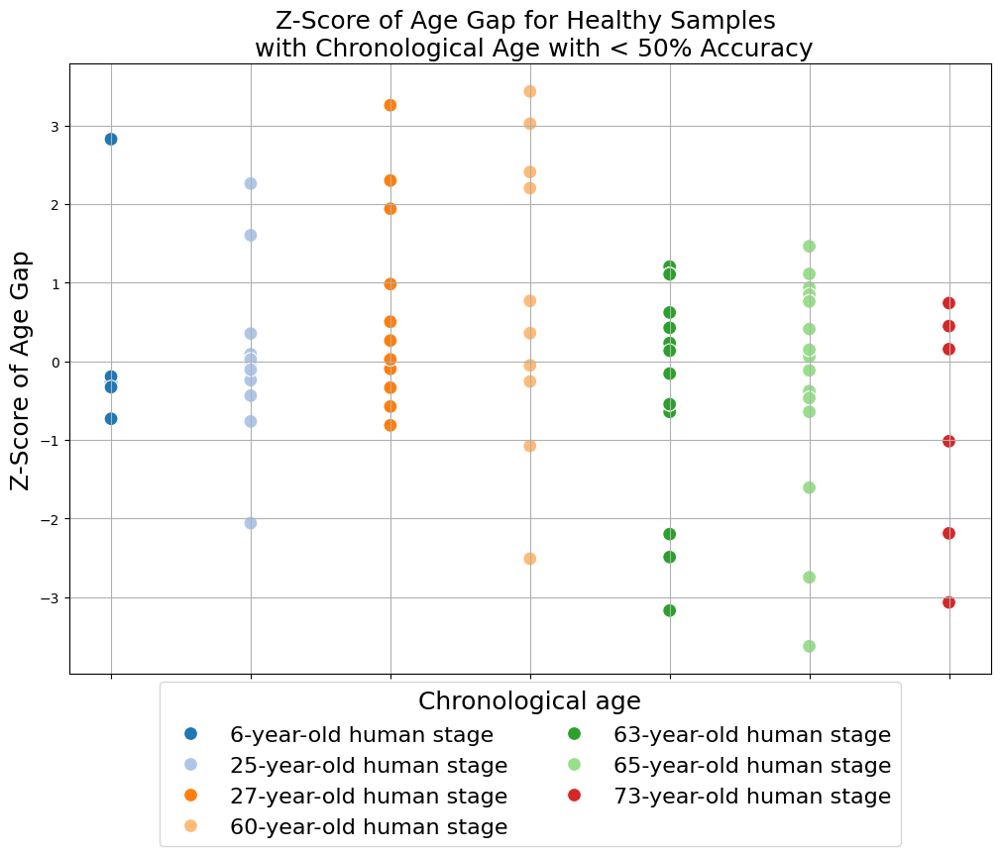

In [ ]:
ground_truth = [label_to_float(label) for label in loaded_mapping["ground_truth"]]
predictions = [label_to_float(label) for label in loaded_mapping["predictions"]]
labels_with_low_accuracy = [label_to_float(label) for label in filtered_low_acc if label_to_float(label) != -1.0] # Labels with low accuracy
filtered_low_acc = [x for x in filtered_low_acc if x not in ['adolescent_stage', 'ninth_decade_human_stage', 'fourth_decade_human_stage']]
map_idx = {}
for i in range(len(filtered_low_acc)):
    map_idx[labels_with_low_accuracy[i]] = filtered_low_acc[i].replace("_"," ")

filtered_age_order = [ 
    "6-year-old human stage", # Youngest
    "25-year-old human stage",
    "27-year-old human stage",
    "60-year-old human stage",
    "63-year-old human stage",
    "65-year-old human stage",
    "73-year-old human stage"   # Oldest
]

df = pd.DataFrame({
    'Ground Truth': ground_truth,
    'Prediction': predictions
})

# Filter DataFrame to only include rows where the ground truth matches the labels with low accuracy
df_filtered = df[df['Ground Truth'].isin(labels_with_low_accuracy)]

# Calculate the age gap for the filtered labels
df_filtered['Age Gap'] = df_filtered['Prediction'] - df_filtered['Ground Truth']

# Group by label (chronological age) and calculate the z-scores within each group
df_filtered['Z-Score'] = df_filtered.groupby('Ground Truth')['Age Gap'].transform(lambda x: (x - x.mean()) / x.std())

# Map ground truth labels to their descriptive names
df_filtered['Label'] = df_filtered['Ground Truth'].map(map_idx)

# Ensure the labels are ordered according to chronological age
df_filtered['Label'] = pd.Categorical(df_filtered['Label'], categories=filtered_age_order, ordered=True)

# Create a DataFrame for plotting
df_plot = pd.DataFrame({
    'Label': df_filtered['Label'],
    'Z-Score': df_filtered['Z-Score']
})

# Plotting
plt.figure(figsize=(12, 8))
ax = sns.scatterplot(data=df_plot, x='Label', y='Z-Score', hue='Label', palette='tab20', legend="full", s=100)
ax.set(xticklabels=[])
sns.move_legend(ax, "lower center", bbox_to_anchor=(0.5, -0.3), ncol=2, title="Chronological age", title_fontsize=18, fontsize=16)

# Adjust x-axis labels and plot details
plt.xlabel('')
plt.ylabel('Z-Score of Age Gap', fontsize=18)
plt.title('Z-Score of Age Gap for Healthy Samples \n with Chronological Age with < 50% Accuracy', fontsize=18)
plt.grid(True)
plt.show()


### Age - tissue relationship

In [ ]:
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
from collections import Counter
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
tissue_data = np.load('/Users/yufanxia/Downloads/chunk3562_10000_tissue.npz')  # Replace with the correct file path

tissue_embeddings = []

# Loop through each array (each representing a tissue embedding)
for key in tissue_data.files:
    # Append each array (embeddings for a tissue) to the list
    tissue_embeddings.append(tissue_data[key])

tissue_emb = torch.stack([torch.tensor(arr, dtype=torch.float32) for arr in tissue_embeddings]).squeeze(1)

tissue_types = validation_data.obs["tissue"].to_list()

In [ ]:
def plot_2d_projection(embeddings, labels, method="PCA", focus=False):
    """
    Plot 2D projections using the specified dimensionality reduction method.
    
    Args:
    embeddings: numpy array of shape (n_samples, n_features), the high-dimensional data.
    labels: list or numpy array of shape (n_samples,), the tissue labels for coloring.
    method: str, the dimensionality reduction method, one of "PCA", "t-SNE", or "UMAP".
    """
    output_folder = "tissue_embedding"
    os.makedirs(output_folder, exist_ok=True)
    
    if method == "PCA":
        reducer = PCA(n_components=2)
    elif method == "t-SNE":
        reducer = TSNE(n_components=2, random_state=42)
    elif method == "UMAP":
        reducer = umap.UMAP(n_components=2, random_state=42)
    else:
        raise ValueError(f"Unknown method: {method}")
    
    # Fit and transform the embeddings into 2D
    reduced_embeddings = reducer.fit_transform(embeddings)
    
    # Create a DataFrame for easier plotting with seaborn
    data = np.column_stack((reduced_embeddings, labels))
    df = pd.DataFrame(data, columns=["x", "y", "tissue"])
    df[["x", "y"]] = df[["x", "y"]].apply(pd.to_numeric)

    if focus:
        major_tissues = [key for key, value in Counter(labels).items() if value > 100]
        df = df[df["tissue"].isin(major_tissues)]
        custom_palette = sns.color_palette([
            "#e6194b", "#3cb44b", "#ffe119", "#4363d8", "#f58231", 
            "#911eb4", "#46f0f0", "#f032e6", "#bcf60c", "#c3c3c3", 
            "#ffcc99", "#c2c2f0", "#ffb3e6", "#c2f0c2", "#ff6666", 
            "#c2f0e6", "#6a5acd", "#ff0000", "#008000", "#00ffff", 
            "#ffd700", "#ff00ff", "#800080", "#a52a2a", "#00ff00", 
            "#ff6347", "#ff4500", "#8a2be2", "#deb887", "#ff1493", 
            "#ff69b4", "#f4a460", "#d2b48c", "#ff8c00", "#d2691e", 
        ])


        plt.figure(figsize=(10, 6))
        sns.scatterplot(x="x", y="y", hue="tissue", data=df, palette=custom_palette, s=60, edgecolor="k", alpha=0.7)
        plt.title(f'{method} of Tissue Embeddings of Tissue Samples > 100', fontsize=16)
        plt.xlabel(f'{method} 1')
        plt.ylabel(f'{method} 2')
        plt.legend(title='Tissue Type', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        output_path = os.path.join(output_folder, f'{method}_tissue_embedding_2D_>100.png')
        plt.savefig(output_path, bbox_inches='tight')
        plt.close()

    else:
        palette = sns.color_palette("husl", len(validation_data.obs["tissue"].unique()))
        # Plot the data using seaborn
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x="x", y="y", hue="tissue", data=df, palette=palette, s=60, edgecolor="k", alpha=0.7)
        plt.title(f'{method} of Tissue Embeddings', fontsize=16)
        plt.xlabel(f'{method} 1')
        plt.ylabel(f'{method} 2')
        plt.legend(title='Tissue Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol = 5)
        plt.tight_layout()
        output_path = os.path.join(output_folder, f'{method}_tissue_embedding_2D.png')
        plt.savefig(output_path, bbox_inches='tight')
        plt.close()

In [ ]:
plot_2d_projection(tissue_emb, tissue_types, method="PCA")

plot_2d_projection(tissue_emb, tissue_types, method="t-SNE")

plot_2d_projection(tissue_emb, tissue_types, method="UMAP")

plot_2d_projection(tissue_emb, tissue_types, method="PCA", focus=True)

plot_2d_projection(tissue_emb, tissue_types, method="t-SNE", focus=True)

plot_2d_projection(tissue_emb, tissue_types, method="UMAP", focus=True)

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/1936955113.py:45: UserWarning: The palette list has more values (35) than needed (23), which may not be intended.
  sns.scatterplot(x="x", y="y", hue="tissue", data=df, palette=custom_palette, s=60, edgecolor="k", alpha=0.7)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/1936955113.py:45: UserWarning: The palette list has more values (35) than needed (23), which may not be intended.
  sns.scatterplot(x="x", y="y", hue="tissue", data=df, palette=custom_palette, s=60, edgecolor="k", alpha=0.7)
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1530/1936955113.py:45: UserWarning: The palette list has m

In [ ]:
tissue_emb.shape

torch.Size([10000, 768])

In [ ]:
features = tissue_emb
tissue_labels = validation_data.obs["tissue"].to_list()

cosine_sim_matrix = cosine_similarity(features, features)

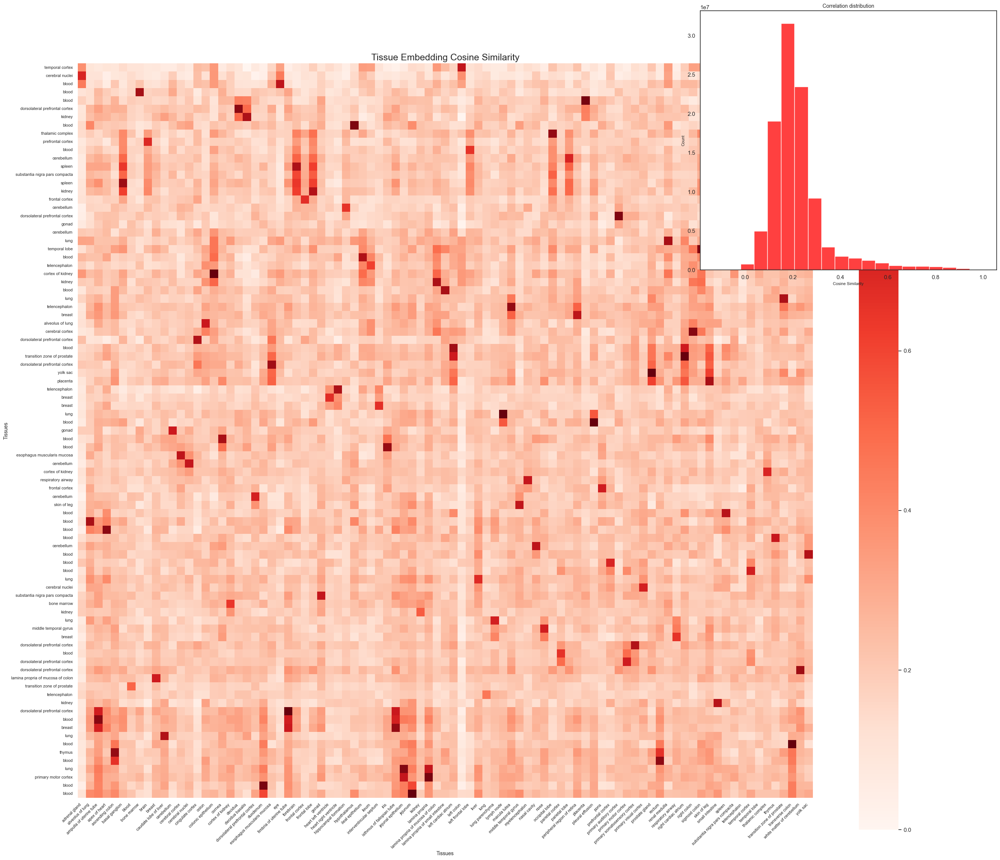

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list
from scipy.spatial.distance import pdist

# Create a DataFrame from your cosine similarity matrix
df_cosine_sim = pd.DataFrame(cosine_sim_matrix, index=tissue_labels, columns=tissue_labels)

# Compute the mean similarities
mean_similarities = df_cosine_sim.groupby(level=0).mean().groupby(level=0, axis=1).mean()

# Compute the linkage matrix for row (y-axis) clustering
distance_matrix = pdist(mean_similarities, metric='cosine')
linkage_matrix = linkage(distance_matrix, method='average')

# Get the order of rows (tissues) from the hierarchical clustering
dendro = dendrogram(linkage_matrix, no_plot=True)
row_order = leaves_list(linkage_matrix)

# Reorder the DataFrame according to the clustering result
ordered_similarities = mean_similarities.iloc[row_order, :]

# Create the heatmap with reordered rows
plt.figure(figsize=(32, 28))

# Create a heatmap with the reordered DataFrame
sns.heatmap(ordered_similarities, annot=False, cmap='Reds', vmin=0, vmax=1, cbar=True, square=True)

# Customize the plot
plt.title("Tissue Embedding Cosine Similarity", fontsize=18)
plt.xlabel("Tissues", fontsize=10)  # Make the text smaller
plt.ylabel("Tissues", fontsize=10)  # Make the text smaller
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate tissue labels and make smaller
plt.yticks(ticks=np.arange(len(row_order)) + 0.5, labels=np.array(tissue_labels)[row_order], rotation=0, fontsize=8)  # Make y-labels smaller and horizontal

# Optional: Add a small correlation distribution inset plot
ax = plt.gca()
inset_ax = plt.axes([0.65, 0.65, 0.25, 0.25])  # Set location and size of inset
sns.histplot(cosine_sim_matrix.flatten(), bins=20, kde=False, color='red', ax=inset_ax)
inset_ax.set_title('Correlation distribution', fontsize=10)
inset_ax.set_xlabel('Cosine Similarity', fontsize=8)
inset_ax.set_ylabel('Count', fontsize=8)

plt.show()


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/seaborn/matrix.py:1124: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


[Text(1, 0.5, 'left colon'),
 Text(1, 1.5, 'adrenal gland'),
 Text(1, 2.5, 'eye'),
 Text(1, 3.5, 'bone marrow'),
 Text(1, 4.5, 'placenta'),
 Text(1, 5.5, 'decidua'),
 Text(1, 6.5, 'decidua basalis'),
 Text(1, 7.5, 'hypothalamus'),
 Text(1, 8.5, 'occipital lobe'),
 Text(1, 9.5, 'brain'),
 Text(1, 10.5, 'left frontal lobe'),
 Text(1, 11.5, 'parietal lobe'),
 Text(1, 12.5, 'forebrain'),
 Text(1, 13.5, 'temporal lobe'),
 Text(1, 14.5, 'basal ganglion'),
 Text(1, 15.5, 'frontal lobe'),
 Text(1, 16.5, 'frontal cortex'),
 Text(1, 17.5, 'hippocampal formation'),
 Text(1, 18.5, 'primary auditory cortex'),
 Text(1, 19.5, 'telencephalon'),
 Text(1, 20.5, 'substantia nigra pars compacta'),
 Text(1, 21.5, 'renal medulla'),
 Text(1, 22.5, 'sigmoid colon'),
 Text(1, 23.5, 'ileal epithelium'),
 Text(1, 24.5, 'ileum'),
 Text(1, 25.5, 'colonic epithelium'),
 Text(1, 26.5, 'lamina propria of mucosa of colon'),
 Text(1, 27.5, 'lamina propria of small intestine'),
 Text(1, 28.5, 'transition zone of prostat

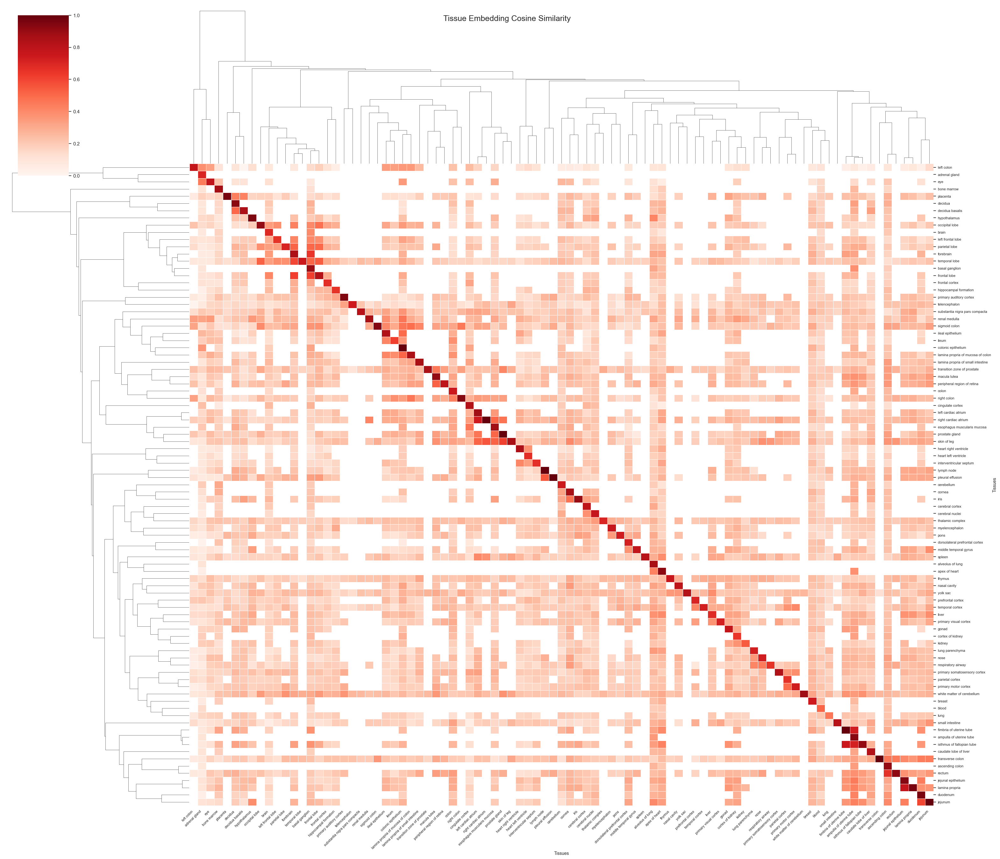

In [ ]:
df_cosine_sim = pd.DataFrame(cosine_sim_matrix, index=tissue_labels, columns=tissue_labels)
mean_similarities = df_cosine_sim.groupby(level=0).mean().groupby(level=0, axis=1).mean()

mask = np.triu(np.ones_like(mean_similarities, dtype=bool))  # Mask for the upper triangle
mask[np.diag_indices_from(mask)] = False

# Compute the mean similarities
mean_similarities = df_cosine_sim.groupby(level=0).mean().groupby(level=0, axis=1).mean()

# Create a clustermap
sns.set(style="white")  # Optional: Set a white background style
g = sns.clustermap(mean_similarities, 
                   mask=mask,
                   cmap='Reds', 
                   vmin=0, vmax=1, 
                   figsize=(32, 28),
                   annot=False,
                   square=True, 
                   cbar=True,
                   linewidths=0.5,
                   method='average',  # Clustering method
                   metric='cosine')  # Distance metric

# Customize the plot
g.fig.suptitle("Tissue Embedding Cosine Similarity", fontsize=18)
g.ax_heatmap.set_xlabel("Tissues", fontsize=10)  # Adjust label font size
g.ax_heatmap.set_ylabel("Tissues", fontsize=10)  # Adjust label font size
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=45, ha='right', fontsize=8)  # Rotate tissue labels and make smaller
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0, fontsize=8)  # Make y-labels smaller and horizontal

# Optional: Add a small correlation distribution inset plot
# Note: Inset plots are not automatically supported in clustermap
# Instead, you can add a separate distribution plot if needed


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/seaborn/matrix.py:1113: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(**tight_params)


Text(0, 0.5, 'Count')

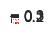

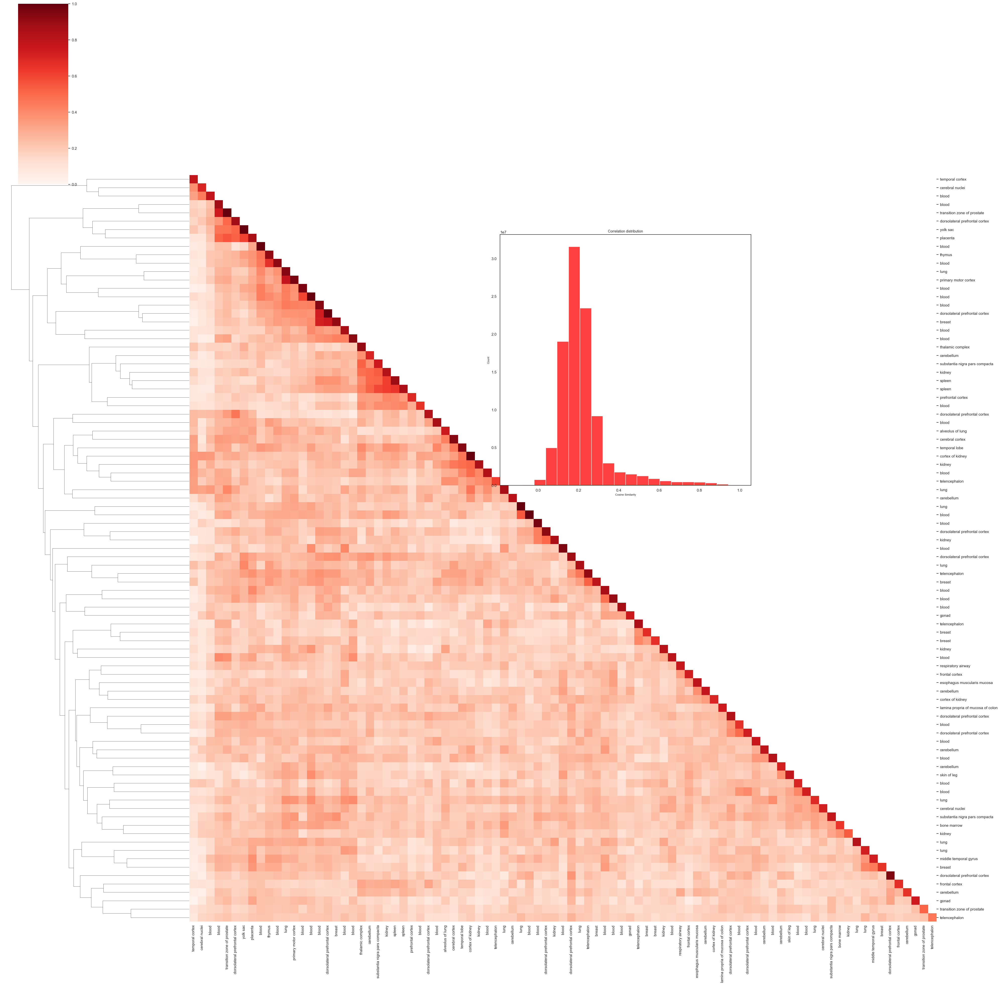

In [ ]:
df_cosine_sim = pd.DataFrame(cosine_sim_matrix, index=tissue_labels, columns=tissue_labels)

mean_similarities = df_cosine_sim.groupby(level=0).mean().groupby(level=0, axis=1).mean()

corr = mean_similarities
mask = np.ones_like(corr)
mask[np.triu_indices_from(mask)] = False
mask = mask.T
g = sns.clustermap(corr, mask=mask, vmax=.3, figsize=(0.1,0.1))
mask = mask[np.argsort(g.dendrogram_row.reordered_ind),:]
mask = mask[:,np.argsort(g.dendrogram_col.reordered_ind)]
plotty = sns.clustermap(corr,figsize=(40,40),mask=mask, cmap='Reds', vmin=0, vmax=1,
                        xticklabels=df_cosine_sim.columns, yticklabels=df_cosine_sim.columns)
plotty.ax_col_dendrogram.set_visible(False)
ax = plt.gca()
inset_ax = plt.axes([0.5, 0.5, 0.25, 0.25])  # Set location and size of inset
sns.histplot(cosine_sim_matrix.flatten(), bins=20, kde=False, color='red', ax=inset_ax)
inset_ax.set_title('Correlation distribution', fontsize=10)
inset_ax.set_xlabel('Cosine Similarity', fontsize=8)
inset_ax.set_ylabel('Count', fontsize=8)


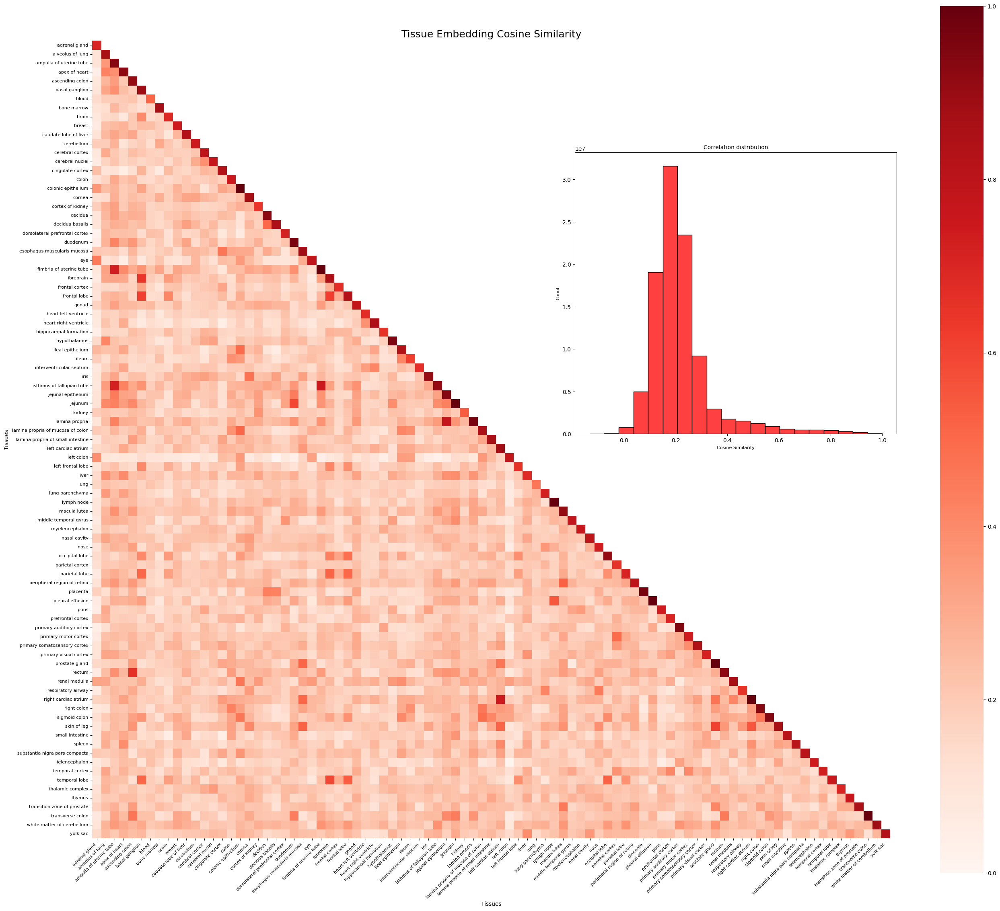

In [ ]:
df_cosine_sim = pd.DataFrame(cosine_sim_matrix, index=tissue_labels, columns=tissue_labels)

mean_similarities = df_cosine_sim.groupby(level=0).mean().groupby(level=0, axis=1).mean()

mask = np.triu(np.ones_like(mean_similarities, dtype=bool))  # Mask for the upper triangle
mask[np.diag_indices_from(mask)] = False
plt.figure(figsize=(32, 28))  # Adjust size as needed
sns.heatmap(mean_similarities, mask=mask, annot=False, cmap='Reds', vmin=0, vmax=1, cbar=True, square=True)

# Customize the plot
plt.title("Tissue Embedding Cosine Similarity", fontsize=18)
plt.xlabel("Tissues", fontsize=10)  # Make the text smaller
plt.ylabel("Tissues", fontsize=10)  # Make the text smaller
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate tissue labels and make smaller
plt.yticks(rotation=0, fontsize=8)  # Make y-labels smaller and horizontal

# Optional: Add a small correlation distribution inset plot
ax = plt.gca()
inset_ax = plt.axes([0.5, 0.5, 0.25, 0.25])  # Set location and size of inset
sns.histplot(cosine_sim_matrix.flatten(), bins=20, kde=False, color='red', ax=inset_ax)
inset_ax.set_title('Correlation distribution', fontsize=10)
inset_ax.set_xlabel('Cosine Similarity', fontsize=8)
inset_ax.set_ylabel('Count', fontsize=8)

plt.show()

### Age - cell type relationship

In [6]:
import torch
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

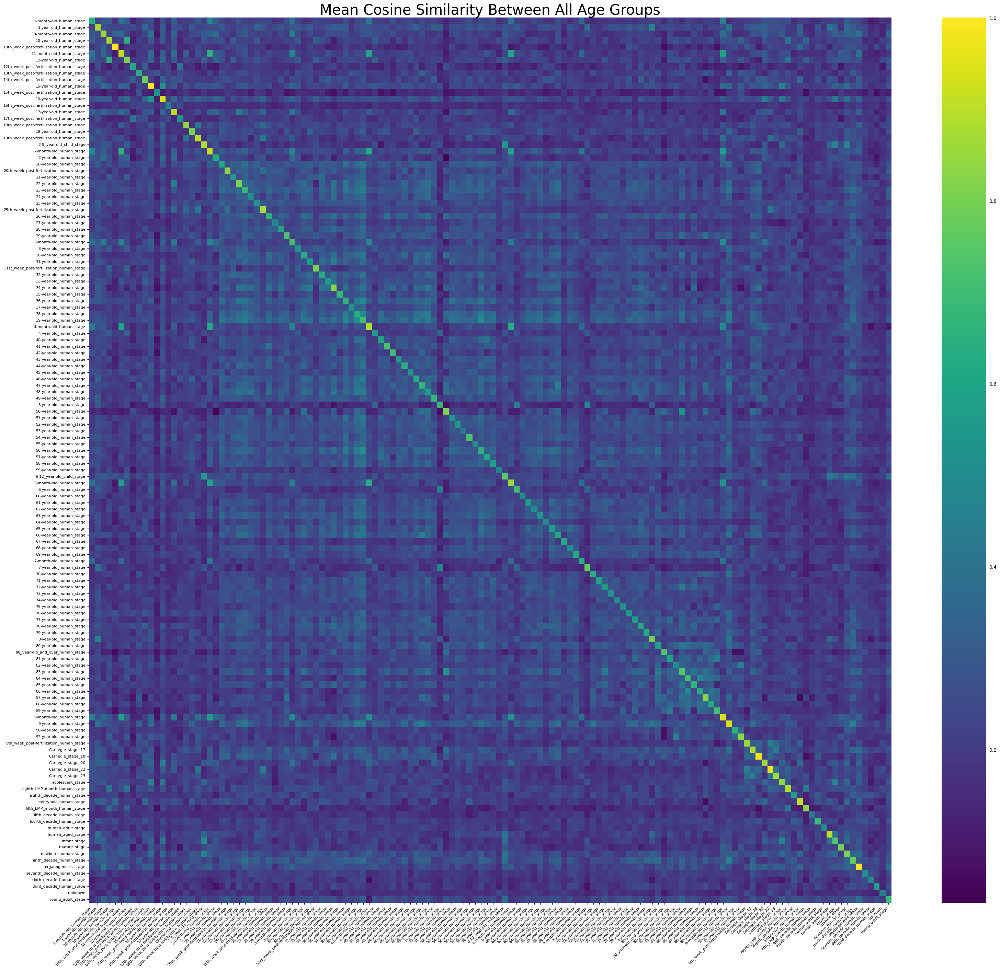

In [ ]:
features = torch.Tensor(age_embs).squeeze()
ages = loaded_mapping["ground_truth"]

cosine_sim_matrix = cosine_similarity(features, features)

# Convert labels to numpy arrays for easier indexing
labels_1 = ages
labels_2 = ages

# Create a DataFrame to hold the similarities and labels
similarity_df = pd.DataFrame(cosine_sim_matrix, index=labels_1, columns=labels_2)

# Group by label pairs and calculate mean similarity for each pair
mean_similarities = similarity_df.groupby(level=0).mean().groupby(level=0, axis=1).mean()

plt.figure(figsize=(32, 28))  # Adjust size as needed
ax = sns.heatmap(mean_similarities, cmap='viridis')

# Rotate and adjust font size
plt.xticks(rotation=45, ha='right', fontsize=8)
plt.yticks(rotation=0, fontsize=8)

# Adjust spacing between labels if needed
plt.tight_layout()  # Automatically adjust subplot parameters to fit labels

plt.title('Mean Cosine Similarity Between All Age Groups', fontsize = 30)

plt.show()


### for different tissues

In [ ]:
output_folder = 'age_embedding_similarity'
os.makedirs(output_folder, exist_ok=True)

# Define the function to generate and save heatmaps
def generate_and_save_heatmap(cell_type_name, features, ages, cell_type):
    mask = cell_type == cell_type_name
    cosine_sim_matrix = cosine_similarity(features[mask], features[mask])

    # Convert labels to numpy arrays for easier indexing
    labels_1 = ages[mask]
    labels_2 = ages[mask]

    # Create a DataFrame to hold the similarities and labels
    similarity_df = pd.DataFrame(cosine_sim_matrix, index=labels_1, columns=labels_2)

    # Group by label pairs and calculate mean similarity for each pair
    mean_similarities = similarity_df.groupby(level=0).mean().groupby(level=0, axis=1).mean()

    # Create and save the heatmap
    plt.figure(figsize=(10, 6))  # Adjust size as needed
    ax = sns.heatmap(mean_similarities, cmap='viridis')

    # Rotate and adjust font size
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)

    # Adjust spacing between labels if needed
    plt.tight_layout()  # Automatically adjust subplot parameters to fit labels

    plt.title(f'Mean Cosine Similarity Between Age Groups \n from {cell_type_name}')

    # Save the heatmap to a file
    file_path = os.path.join(output_folder, f'{cell_type_name.replace(" ","_").replace("/","_")}_mean_cosine_similarity.png')
    plt.savefig(file_path,  bbox_inches='tight')
    plt.close()

# Example data
features = np.array(torch.Tensor(age_embs).squeeze())
ages = np.array(loaded_mapping["ground_truth"])
cell_type = np.array(validation_data.obs["cell_type"].to_list())

# Iterate over unique cell types
unique_cell_types = np.unique(cell_type)
for cell_type_name in unique_cell_types:
    generate_and_save_heatmap(cell_type_name, features, ages, cell_type)

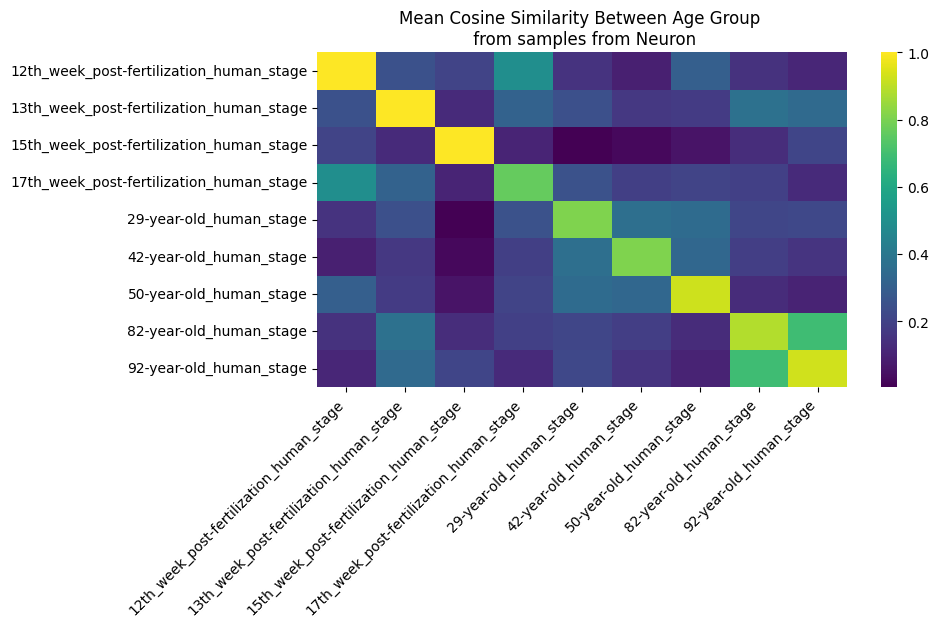

In [ ]:
features = np.array(torch.Tensor(age_embs).squeeze())
ages = np.array(loaded_mapping["ground_truth"])
cell_type = np.array(validation_data.obs["cell_type"].to_list())
mask = cell_type == "neuron"
cosine_sim_matrix = cosine_similarity(features[mask], features[mask])

# Convert labels to numpy arrays for easier indexing
labels_1 = ages[mask]
labels_2 = ages[mask]

# Create a DataFrame to hold the similarities and labels
similarity_df = pd.DataFrame(cosine_sim_matrix, index=labels_1, columns=labels_2)

# Group by label pairs and calculate mean similarity for each pair
mean_similarities = similarity_df.groupby(level=0).mean().groupby(level=0, axis=1).mean()

plt.figure(figsize=(10, 6))  # Adjust size as needed
ax = sns.heatmap(mean_similarities, cmap='viridis')

# Rotate and adjust font size
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)

# Adjust spacing between labels if needed
plt.tight_layout()  # Automatically adjust subplot parameters to fit labels

plt.title('Mean Cosine Similarity Between Age Group \n from samples from Neuron')

plt.show()

### Age - cell type relationship

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
data = pd.DataFrame({
    'Predicted Age': prediction,
    'Ground Truth Age': ground_truth,
    'Cell Type': validation_data.obs["cell_type"].to_list()
})

# Filter out invalid values
data = data[(data['Predicted Age'] != -1) & (data['Ground Truth Age'] != -1)]

# Ensure output directory exists
output_dir = 'cell_type_age_prediction'
os.makedirs(output_dir, exist_ok=True)

# Loop over each unique cell type
unique_cell_types = data['Cell Type'].unique()
for cell_type in unique_cell_types:
    subset = data[data['Cell Type'] == cell_type]
    if len(subset) > 30:  # Filter for sufficient data
        plt.figure(figsize=(12, 8))
        sns.regplot(x="Ground Truth Age", y="Predicted Age", data=subset, ci=None, scatter_kws={"s": 20, "color": "blue"}, line_kws={"color": "black"})
        
        # Calculate correlation
        correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]
        if pd.notna(correlation):
            plt.text(0.1, 0.9, f'R = {correlation:.2f}', transform=plt.gca().transAxes, fontsize=18, verticalalignment='top')
        
        # Set labels and titles
        plt.xlabel("Chronological age",fontsize=18)
        plt.ylabel("Predicted chronological age",fontsize=18)
        plt.title(f'Age Prediction vs Ground Truth for Cell Type: {cell_type}',fontsize=18)
        
        # Save plot
        plt.savefig(os.path.join(output_dir, f'{cell_type.replace(" ","_").replace("/","_")}_plot.png'), bbox_inches='tight')
        plt.close()  # Close the plot to avoid display

print("Plots saved in the 'cell_type_plots' directory.")

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1136/1737858680.py:23: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]


Plots saved in the 'cell_type_plots' directory.


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_3110/2827777876.py:20: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_3110/2827777876.py:34: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]


<Figure size 1200x800 with 0 Axes>

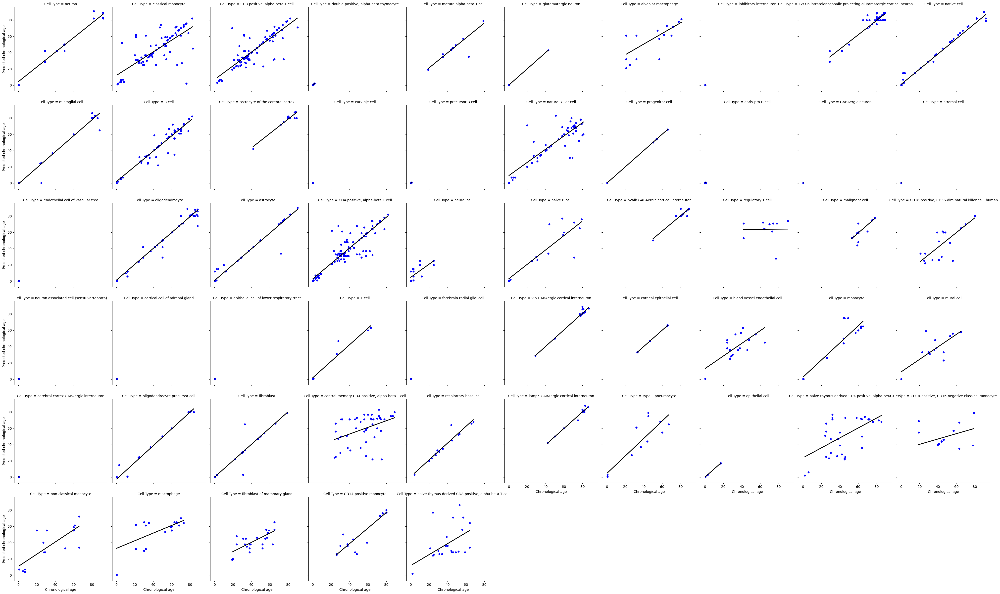

In [ ]:
# Create a DataFrame
data = pd.DataFrame({
    'Predicted Age': prediction,
    'Ground Truth Age': ground_truth,
    'Cell Type': validation_data.obs["cell_type"].to_list()
})

# Filter out invalid values
data = data[(data['Predicted Age'] != -1) & (data['Ground Truth Age'] != -1)]

# Set up the matplotlib figure
plt.figure(figsize=(12, 8))

# Initialize a grid of plots, one for each cell type
unique_cell_types = data['Cell Type'].unique()
valid_cell_types = []

for cell in unique_cell_types:
    subset = data[data['Cell Type'] == cell]
    correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]
    if pd.notna(correlation) and len(subset) > 30:
        valid_cell_types.append(cell)

# Only include valid cell types where correlation is not NaN and have less than 5 samples 
g = sns.FacetGrid(data[data['Cell Type'].isin(valid_cell_types)], col="Cell Type", col_wrap=10, height=4, aspect=1)

# Add a scatter plot with a regression line for each valid cell type
g.map(sns.regplot, "Ground Truth Age", "Predicted Age", ci=None, scatter_kws={"s": 20, "color": "blue"}, line_kws={"color": "black"})

# Add correlation coefficients to the plots
for ax in g.axes.flat:
    cell_type = ax.get_title().split(" : ")[-1]
    subset = data[data["Cell Type"] == cell_type]
    correlation = subset.corr().loc["Ground Truth Age", "Predicted Age"]
    if pd.notna(correlation):
        ax.text(0.1, 0.9, f'R = {correlation:.2f}', transform=ax.transAxes, fontsize=12, verticalalignment='top')

# Set labels and titles
g.set_axis_labels("Chronological age", "Predicted chronological age")

# Display the plot
plt.show()

### Aging pace in organs

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.patches as mpatches

In [ ]:
age_label_mapping_50 = {'1-month-old human stage':"young",
 '1-year-old human stage':"young",
 '10-month-old human stage':"young",
 '10-year-old human stage':"young",
 '10th week post-fertilization human stage':"young",
 '11-month-old human stage':"young",
 '12-year-old human stage':"young",
 '12th week post-fertilization human stage':"young",
 '13th week post-fertilization human stage':"young",
 '14th week post-fertilization human stage':"young",
 '15-year-old human stage':"young",
 '15th week post-fertilization human stage':"young",
 '16-year-old human stage':"young",
 '16th week post-fertilization human stage':"young",
 '17-year-old human stage':"young",
 '17th week post-fertilization human stage':"young",
 '18th week post-fertilization human stage':"young",
 '19-year-old human stage':"young",
 '19th week post-fertilization human stage':"young",
 '2-5 year-old child stage':"young",
 '2-month-old human stage':"young",
 '2-year-old human stage':"young",
 '20-year-old human stage':"young",
 '20th week post-fertilization human stage':"young",
 '21-year-old human stage':"young",
 '22-year-old human stage':"young",
 '23-year-old human stage':"young",
 '24-year-old human stage':"young",
 '25-year-old human stage':"young",
 '25th week post-fertilization human stage':"young",
 '26-year-old human stage':"young",
 '27-year-old human stage':"young",
 '28-year-old human stage':"young",
 '29-year-old human stage':"young",
 '3-month-old human stage':"young",
 '3-year-old human stage':"young",
 '30-year-old human stage':"young",
 '31-year-old human stage':"young",
 '31st week post-fertilization human stage':"young",
 '32-year-old human stage':"young",
 '33-year-old human stage':"young",
 '34-year-old human stage':"young",
 '35-year-old human stage':"young",
 '36-year-old human stage':"young",
 '37-year-old human stage':"young",
 '38-year-old human stage':"young",
 '39-year-old human stage':"young",
 '4-month-old human stage':"young",
 '4-year-old human stage':"young",
 '40-year-old human stage':"young",
 '41-year-old human stage':"young",
 '42-year-old human stage':"young",
 '43-year-old human stage':"young",
 '44-year-old human stage':"young",
 '45-year-old human stage':"young",
 '46-year-old human stage':"young",
 '47-year-old human stage':"young",
 '48-year-old human stage':"young",
 '49-year-old human stage':"young",
 '5-year-old human stage':"young",
 '50-year-old human stage':"old",
 '51-year-old human stage':"old",
 '52-year-old human stage':"old",
 '53-year-old human stage':"old",
 '54-year-old human stage':"old",
 '55-year-old human stage':"old",
 '56-year-old human stage':"old",
 '57-year-old human stage':"old",
 '58-year-old human stage':"old",
 '59-year-old human stage':"old",
 '6-12 year-old child stage':"young",
 '6-month-old human stage':"young",
 '6-year-old human stage':"young",
 '60-year-old human stage':"old",
 '61-year-old human stage':"old",
 '62-year-old human stage':"old",
 '63-year-old human stage':"old",
 '64-year-old human stage':"old",
 '65-year-old human stage':"old",
 '66-year-old human stage':"old",
 '67-year-old human stage':"old",
 '68-year-old human stage':"old",
 '69-year-old human stage':"old",
 '7-month-old human stage':"young",
 '7-year-old human stage':"young",
 '70-year-old human stage':"old",
 '71-year-old human stage':"old",
 '72-year-old human stage':"old",
 '73-year-old human stage':"old",
 '74-year-old human stage':"old",
 '75-year-old human stage':"old",
 '76-year-old human stage':"old",
 '77-year-old human stage':"old",
 '78-year-old human stage':"old",
 '79-year-old human stage':"old",
 '8-year-old human stage':"young",
 '80 year-old and over human stage':"old",
 '80-year-old human stage':"old",
 '81-year-old human stage':"old",
 '82-year-old human stage':"old",
 '83-year-old human stage':"old",
 '84-year-old human stage':"old",
 '85-year-old human stage':"old",
 '86-year-old human stage':"old",
 '87-year-old human stage':"old",
 '88-year-old human stage':"old",
 '89-year-old human stage':"old",
 '9-month-old human stage':"young",
 '9-year-old human stage':"young",
 '90-year-old human stage':"old",
 '92-year-old human stage':"old",
 '9th week post-fertilization human stage':"young",
 'Carnegie stage 17':"young",
 'Carnegie stage 18':"young",
 'Carnegie stage 20':"young",
 'Carnegie stage 22':"young",
 'Carnegie stage 23':"young",
 'adolescent stage':"young",
 'eighth LMP month human stage':"young",
 'eighth decade human stage':"old",
 'embryonic human stage':"young",
 'fifth LMP month human stage':"young",
 'fifth decade human stage':"old",
 'fourth decade human stage':"young",
 'human adult stage':"young",
 'human aged stage':"old",
 'infant stage':"young",
 'mature stage':"young",
 'newborn human stage':"young",
 'ninth decade human stage':"old",
 'organogenesis stage':"young",
 'seventh decade human stage':"old",
 'sixth decade human stage':"old",
 'third decade human stage':"young",
 'unknown':"unknown",
 'young adult stage':"yound"}

In [ ]:
age_label_mapping_40 = {'1-month-old human stage':"young",
 '1-year-old human stage':"young",
 '10-month-old human stage':"young",
 '10-year-old human stage':"young",
 '10th week post-fertilization human stage':"young",
 '11-month-old human stage':"young",
 '12-year-old human stage':"young",
 '12th week post-fertilization human stage':"young",
 '13th week post-fertilization human stage':"young",
 '14th week post-fertilization human stage':"young",
 '15-year-old human stage':"young",
 '15th week post-fertilization human stage':"young",
 '16-year-old human stage':"young",
 '16th week post-fertilization human stage':"young",
 '17-year-old human stage':"young",
 '17th week post-fertilization human stage':"young",
 '18th week post-fertilization human stage':"young",
 '19-year-old human stage':"young",
 '19th week post-fertilization human stage':"young",
 '2-5 year-old child stage':"young",
 '2-month-old human stage':"young",
 '2-year-old human stage':"young",
 '20-year-old human stage':"young",
 '20th week post-fertilization human stage':"young",
 '21-year-old human stage':"young",
 '22-year-old human stage':"young",
 '23-year-old human stage':"young",
 '24-year-old human stage':"young",
 '25-year-old human stage':"young",
 '25th week post-fertilization human stage':"young",
 '26-year-old human stage':"young",
 '27-year-old human stage':"young",
 '28-year-old human stage':"young",
 '29-year-old human stage':"young",
 '3-month-old human stage':"young",
 '3-year-old human stage':"young",
 '30-year-old human stage':"young",
 '31-year-old human stage':"young",
 '31st week post-fertilization human stage':"young",
 '32-year-old human stage':"young",
 '33-year-old human stage':"young",
 '34-year-old human stage':"young",
 '35-year-old human stage':"young",
 '36-year-old human stage':"young",
 '37-year-old human stage':"young",
 '38-year-old human stage':"young",
 '39-year-old human stage':"young",
 '4-month-old human stage':"young",
 '4-year-old human stage':"young",
 '40-year-old human stage':"old",
 '41-year-old human stage':"old",
 '42-year-old human stage':"old",
 '43-year-old human stage':"old",
 '44-year-old human stage':"old",
 '45-year-old human stage':"old",
 '46-year-old human stage':"old",
 '47-year-old human stage':"old",
 '48-year-old human stage':"old",
 '49-year-old human stage':"old",
 '5-year-old human stage':"young",
 '50-year-old human stage':"old",
 '51-year-old human stage':"old",
 '52-year-old human stage':"old",
 '53-year-old human stage':"old",
 '54-year-old human stage':"old",
 '55-year-old human stage':"old",
 '56-year-old human stage':"old",
 '57-year-old human stage':"old",
 '58-year-old human stage':"old",
 '59-year-old human stage':"old",
 '6-12 year-old child stage':"young",
 '6-month-old human stage':"young",
 '6-year-old human stage':"young",
 '60-year-old human stage':"old",
 '61-year-old human stage':"old",
 '62-year-old human stage':"old",
 '63-year-old human stage':"old",
 '64-year-old human stage':"old",
 '65-year-old human stage':"old",
 '66-year-old human stage':"old",
 '67-year-old human stage':"old",
 '68-year-old human stage':"old",
 '69-year-old human stage':"old",
 '7-month-old human stage':"young",
 '7-year-old human stage':"young",
 '70-year-old human stage':"old",
 '71-year-old human stage':"old",
 '72-year-old human stage':"old",
 '73-year-old human stage':"old",
 '74-year-old human stage':"old",
 '75-year-old human stage':"old",
 '76-year-old human stage':"old",
 '77-year-old human stage':"old",
 '78-year-old human stage':"old",
 '79-year-old human stage':"old",
 '8-year-old human stage':"young",
 '80 year-old and over human stage':"old",
 '80-year-old human stage':"old",
 '81-year-old human stage':"old",
 '82-year-old human stage':"old",
 '83-year-old human stage':"old",
 '84-year-old human stage':"old",
 '85-year-old human stage':"old",
 '86-year-old human stage':"old",
 '87-year-old human stage':"old",
 '88-year-old human stage':"old",
 '89-year-old human stage':"old",
 '9-month-old human stage':"young",
 '9-year-old human stage':"young",
 '90-year-old human stage':"old",
 '92-year-old human stage':"old",
 '9th week post-fertilization human stage':"young",
 'Carnegie stage 17':"young",
 'Carnegie stage 18':"young",
 'Carnegie stage 20':"young",
 'Carnegie stage 22':"young",
 'Carnegie stage 23':"young",
 'adolescent stage':"young",
 'eighth LMP month human stage':"young",
 'eighth decade human stage':"old",
 'embryonic human stage':"young",
 'fifth LMP month human stage':"young",
 'fifth decade human stage':"old",
 'fourth decade human stage':"old",
 'human adult stage':"young",
 'human aged stage':"old",
 'infant stage':"young",
 'mature stage':"young",
 'newborn human stage':"young",
 'ninth decade human stage':"old",
 'organogenesis stage':"young",
 'seventh decade human stage':"old",
 'sixth decade human stage':"old",
 'third decade human stage':"young",
 'unknown':"unknown",
 'young adult stage':"yound"}

In [ ]:
age_label_mapping_60 = {'1-month-old human stage':"young",
 '1-year-old human stage':"young",
 '10-month-old human stage':"young",
 '10-year-old human stage':"young",
 '10th week post-fertilization human stage':"young",
 '11-month-old human stage':"young",
 '12-year-old human stage':"young",
 '12th week post-fertilization human stage':"young",
 '13th week post-fertilization human stage':"young",
 '14th week post-fertilization human stage':"young",
 '15-year-old human stage':"young",
 '15th week post-fertilization human stage':"young",
 '16-year-old human stage':"young",
 '16th week post-fertilization human stage':"young",
 '17-year-old human stage':"young",
 '17th week post-fertilization human stage':"young",
 '18th week post-fertilization human stage':"young",
 '19-year-old human stage':"young",
 '19th week post-fertilization human stage':"young",
 '2-5 year-old child stage':"young",
 '2-month-old human stage':"young",
 '2-year-old human stage':"young",
 '20-year-old human stage':"young",
 '20th week post-fertilization human stage':"young",
 '21-year-old human stage':"young",
 '22-year-old human stage':"young",
 '23-year-old human stage':"young",
 '24-year-old human stage':"young",
 '25-year-old human stage':"young",
 '25th week post-fertilization human stage':"young",
 '26-year-old human stage':"young",
 '27-year-old human stage':"young",
 '28-year-old human stage':"young",
 '29-year-old human stage':"young",
 '3-month-old human stage':"young",
 '3-year-old human stage':"young",
 '30-year-old human stage':"young",
 '31-year-old human stage':"young",
 '31st week post-fertilization human stage':"young",
 '32-year-old human stage':"young",
 '33-year-old human stage':"young",
 '34-year-old human stage':"young",
 '35-year-old human stage':"young",
 '36-year-old human stage':"young",
 '37-year-old human stage':"young",
 '38-year-old human stage':"young",
 '39-year-old human stage':"young",
 '4-month-old human stage':"young",
 '4-year-old human stage':"young",
 '40-year-old human stage':"young",
 '41-year-old human stage':"young",
 '42-year-old human stage':"young",
 '43-year-old human stage':"young",
 '44-year-old human stage':"young",
 '45-year-old human stage':"young",
 '46-year-old human stage':"young",
 '47-year-old human stage':"young",
 '48-year-old human stage':"young",
 '49-year-old human stage':"young",
 '5-year-old human stage':"young",
 '50-year-old human stage':"young",
 '51-year-old human stage':"young",
 '52-year-old human stage':"young",
 '53-year-old human stage':"young",
 '54-year-old human stage':"young",
 '55-year-old human stage':"young",
 '56-year-old human stage':"young",
 '57-year-old human stage':"young",
 '58-year-old human stage':"young",
 '59-year-old human stage':"young",
 '6-12 year-old child stage':"young",
 '6-month-old human stage':"young",
 '6-year-old human stage':"young",
 '60-year-old human stage':"old",
 '61-year-old human stage':"old",
 '62-year-old human stage':"old",
 '63-year-old human stage':"old",
 '64-year-old human stage':"old",
 '65-year-old human stage':"old",
 '66-year-old human stage':"old",
 '67-year-old human stage':"old",
 '68-year-old human stage':"old",
 '69-year-old human stage':"old",
 '7-month-old human stage':"young",
 '7-year-old human stage':"young",
 '70-year-old human stage':"old",
 '71-year-old human stage':"old",
 '72-year-old human stage':"old",
 '73-year-old human stage':"old",
 '74-year-old human stage':"old",
 '75-year-old human stage':"old",
 '76-year-old human stage':"old",
 '77-year-old human stage':"old",
 '78-year-old human stage':"old",
 '79-year-old human stage':"old",
 '8-year-old human stage':"young",
 '80 year-old and over human stage':"old",
 '80-year-old human stage':"old",
 '81-year-old human stage':"old",
 '82-year-old human stage':"old",
 '83-year-old human stage':"old",
 '84-year-old human stage':"old",
 '85-year-old human stage':"old",
 '86-year-old human stage':"old",
 '87-year-old human stage':"old",
 '88-year-old human stage':"old",
 '89-year-old human stage':"old",
 '9-month-old human stage':"young",
 '9-year-old human stage':"young",
 '90-year-old human stage':"old",
 '92-year-old human stage':"old",
 '9th week post-fertilization human stage':"young",
 'Carnegie stage 17':"young",
 'Carnegie stage 18':"young",
 'Carnegie stage 20':"young",
 'Carnegie stage 22':"young",
 'Carnegie stage 23':"young",
 'adolescent stage':"young",
 'eighth LMP month human stage':"young",
 'eighth decade human stage':"old",
 'embryonic human stage':"young",
 'fifth LMP month human stage':"young",
 'fifth decade human stage':"young",
 'fourth decade human stage':"young",
 'human adult stage':"young",
 'human aged stage':"old",
 'infant stage':"young",
 'mature stage':"young",
 'newborn human stage':"young",
 'ninth decade human stage':"old",
 'organogenesis stage':"young",
 'seventh decade human stage':"old",
 'sixth decade human stage':"old",
 'third decade human stage':"young",
 'unknown':"unknown",
 'young adult stage':"yound"}

In [19]:
age_label_mapping_20 = {'1-month-old human stage':"<20",
 '1-year-old human stage':"<20",
 '10-month-old human stage':"<20",
 '10-year-old human stage':"<20",
 '10th week post-fertilization human stage':"<20",
 '11-month-old human stage':"<20",
 '12-year-old human stage':"<20",
 '12th week post-fertilization human stage':"<20",
 '13th week post-fertilization human stage':"<20",
 '14th week post-fertilization human stage':"<20",
 '15-year-old human stage':"<20",
 '15th week post-fertilization human stage':"<20",
 '16-year-old human stage':"<20",
 '16th week post-fertilization human stage':"<20",
 '17-year-old human stage':"<20",
 '17th week post-fertilization human stage':"<20",
 '18th week post-fertilization human stage':"<20",
 '19-year-old human stage':"<20",
 '19th week post-fertilization human stage':"<20",
 '2-5 year-old child stage':"<20",
 '2-month-old human stage':"<20",
 '2-year-old human stage':"<20",
 '20-year-old human stage':"20-40",
 '20th week post-fertilization human stage':"<20",
 '21-year-old human stage':"20-40",
 '22-year-old human stage':"20-40",
 '23-year-old human stage':"20-40",
 '24-year-old human stage':"20-40",
 '25-year-old human stage':"20-40",
 '25th week post-fertilization human stage':"<20",
 '26-year-old human stage':"20-40",
 '27-year-old human stage':"20-40",
 '28-year-old human stage':"20-40",
 '29-year-old human stage':"20-40",
 '3-month-old human stage':"<20",
 '3-year-old human stage':"<20",
 '30-year-old human stage':"20-40",
 '31-year-old human stage':"20-40",
 '31st week post-fertilization human stage':"<20",
 '32-year-old human stage':"20-40",
 '33-year-old human stage':"20-40",
 '34-year-old human stage':"20-40",
 '35-year-old human stage':"20-40",
 '36-year-old human stage':"20-40",
 '37-year-old human stage':"20-40",
 '38-year-old human stage':"20-40",
 '39-year-old human stage':"20-40",
 '4-month-old human stage':"<20",
 '4-year-old human stage':"<20",
 '40-year-old human stage':"40-60",
 '41-year-old human stage':"40-60",
 '42-year-old human stage':"40-60",
 '43-year-old human stage':"40-60",
 '44-year-old human stage':"40-60",
 '45-year-old human stage':"40-60",
 '46-year-old human stage':"40-60",
 '47-year-old human stage':"40-60",
 '48-year-old human stage':"40-60",
 '49-year-old human stage':"40-60",
 '5-year-old human stage':"<20",
 '50-year-old human stage':"40-60",
 '51-year-old human stage':"40-60",
 '52-year-old human stage':"40-60",
 '53-year-old human stage':"40-60",
 '54-year-old human stage':"40-60",
 '55-year-old human stage':"40-60",
 '56-year-old human stage':"40-60",
 '57-year-old human stage':"40-60",
 '58-year-old human stage':"40-60",
 '59-year-old human stage':"40-60",
 '6-12 year-old child stage':"<20",
 '6-month-old human stage':"<20",
 '6-year-old human stage':"<20",
 '60-year-old human stage':"60-80",
 '61-year-old human stage':"60-80",
 '62-year-old human stage':"60-80",
 '63-year-old human stage':"60-80",
 '64-year-old human stage':"60-80",
 '65-year-old human stage':"60-80",
 '66-year-old human stage':"60-80",
 '67-year-old human stage':"60-80",
 '68-year-old human stage':"60-80",
 '69-year-old human stage':"60-80",
 '7-month-old human stage':"<20",
 '7-year-old human stage':"<20",
 '70-year-old human stage':"60-80",
 '71-year-old human stage':"60-80",
 '72-year-old human stage':"60-80",
 '73-year-old human stage':"60-80",
 '74-year-old human stage':"60-80",
 '75-year-old human stage':"60-80",
 '76-year-old human stage':"60-80",
 '77-year-old human stage':"60-80",
 '78-year-old human stage':"60-80",
 '79-year-old human stage':"60-80",
 '8-year-old human stage':"<20",
 '80 year-old and over human stage':">80",
 '80-year-old human stage':">80",
 '81-year-old human stage':">80",
 '82-year-old human stage':">80",
 '83-year-old human stage':">80",
 '84-year-old human stage':">80",
 '85-year-old human stage':">80",
 '86-year-old human stage':">80",
 '87-year-old human stage':">80",
 '88-year-old human stage':">80",
 '89-year-old human stage':">80",
 '9-month-old human stage':"<20",
 '9-year-old human stage':"<20",
 '90-year-old human stage':">80",
 '92-year-old human stage':">80",
 '9th week post-fertilization human stage':"<20",
 'Carnegie stage 17':"<20",
 'Carnegie stage 18':"<20",
 'Carnegie stage 20':"<20",
 'Carnegie stage 22':"<20",
 'Carnegie stage 23':"<20",
 'adolescent stage':"<20",
 'eighth LMP month human stage':"<20",
 'eighth decade human stage':">80",
 'embryonic human stage':"<20",
 'fifth LMP month human stage':"<20",
 'fifth decade human stage':"40-60",
 'fourth decade human stage':"40-60",
 'human adult stage':"unknown",
 'human aged stage':"unknown",
 'infant stage':"<20",
 'mature stage':"unknown",
 'newborn human stage':"<20",
 'ninth decade human stage':">80",
 'organogenesis stage':"<20",
 'seventh decade human stage':"60-80",
 'sixth decade human stage':"60-80",
 'third decade human stage':"20-40",
 'unknown':"unknown",
 'young adult stage':"unknown"}

In [18]:
filtered_age_label_mapping_20 = {'1-month-old human stage':"unknown",
 '1-year-old human stage':"unknown",
 '10-month-old human stage':"unknown",
 '10-year-old human stage':"<20",
 '10th week post-fertilization human stage':"unknown",
 '11-month-old human stage':"unknown",
 '12-year-old human stage':"<20",
 '12th week post-fertilization human stage':"unknown",
 '13th week post-fertilization human stage':"unknown",
 '14th week post-fertilization human stage':"unknown",
 '15-year-old human stage':"<20",
 '15th week post-fertilization human stage':"unknown",
 '16-year-old human stage':"<20",
 '16th week post-fertilization human stage':"unknown",
 '17-year-old human stage':"<20",
 '17th week post-fertilization human stage':"unknown",
 '18th week post-fertilization human stage':"unknown",
 '19-year-old human stage':"<20",
 '19th week post-fertilization human stage':"unknown",
 '2-5 year-old child stage':"unknown",
 '2-month-old human stage':"unknown",
 '2-year-old human stage':"unknown",
 '20-year-old human stage':"20-40",
 '20th week post-fertilization human stage':"unknown",
 '21-year-old human stage':"20-40",
 '22-year-old human stage':"20-40",
 '23-year-old human stage':"20-40",
 '24-year-old human stage':"20-40",
 '25-year-old human stage':"20-40",
 '25th week post-fertilization human stage':"unknown",
 '26-year-old human stage':"20-40",
 '27-year-old human stage':"20-40",
 '28-year-old human stage':"20-40",
 '29-year-old human stage':"20-40",
 '3-month-old human stage':"unknown",
 '3-year-old human stage':"unknown",
 '30-year-old human stage':"20-40",
 '31-year-old human stage':"20-40",
 '31st week post-fertilization human stage':"unknown",
 '32-year-old human stage':"20-40",
 '33-year-old human stage':"20-40",
 '34-year-old human stage':"20-40",
 '35-year-old human stage':"20-40",
 '36-year-old human stage':"20-40",
 '37-year-old human stage':"20-40",
 '38-year-old human stage':"20-40",
 '39-year-old human stage':"20-40",
 '4-month-old human stage':"unknown",
 '4-year-old human stage':"unknown",
 '40-year-old human stage':"40-60",
 '41-year-old human stage':"40-60",
 '42-year-old human stage':"40-60",
 '43-year-old human stage':"40-60",
 '44-year-old human stage':"40-60",
 '45-year-old human stage':"40-60",
 '46-year-old human stage':"40-60",
 '47-year-old human stage':"40-60",
 '48-year-old human stage':"40-60",
 '49-year-old human stage':"40-60",
 '5-year-old human stage':"unknown",
 '50-year-old human stage':"40-60",
 '51-year-old human stage':"40-60",
 '52-year-old human stage':"40-60",
 '53-year-old human stage':"40-60",
 '54-year-old human stage':"40-60",
 '55-year-old human stage':"40-60",
 '56-year-old human stage':"40-60",
 '57-year-old human stage':"40-60",
 '58-year-old human stage':"40-60",
 '59-year-old human stage':"40-60",
 '6-12 year-old child stage':"unknown",
 '6-month-old human stage':"unknown",
 '6-year-old human stage':"unknown",
 '60-year-old human stage':"60-80",
 '61-year-old human stage':"60-80",
 '62-year-old human stage':"60-80",
 '63-year-old human stage':"60-80",
 '64-year-old human stage':"60-80",
 '65-year-old human stage':"60-80",
 '66-year-old human stage':"60-80",
 '67-year-old human stage':"60-80",
 '68-year-old human stage':"60-80",
 '69-year-old human stage':"60-80",
 '7-month-old human stage':"unknown",
 '7-year-old human stage':"unknown",
 '70-year-old human stage':"60-80",
 '71-year-old human stage':"60-80",
 '72-year-old human stage':"60-80",
 '73-year-old human stage':"60-80",
 '74-year-old human stage':"60-80",
 '75-year-old human stage':"60-80",
 '76-year-old human stage':"60-80",
 '77-year-old human stage':"60-80",
 '78-year-old human stage':"60-80",
 '79-year-old human stage':"60-80",
 '8-year-old human stage':"unknown",
 '80 year-old and over human stage':">80",
 '80-year-old human stage':">80",
 '81-year-old human stage':">80",
 '82-year-old human stage':">80",
 '83-year-old human stage':">80",
 '84-year-old human stage':">80",
 '85-year-old human stage':">80",
 '86-year-old human stage':">80",
 '87-year-old human stage':">80",
 '88-year-old human stage':">80",
 '89-year-old human stage':">80",
 '9-month-old human stage':"unknown",
 '9-year-old human stage':"unknown",
 '90-year-old human stage':">80",
 '92-year-old human stage':">80",
 '9th week post-fertilization human stage':"unknown",
 'Carnegie stage 17':"unknown",
 'Carnegie stage 18':"unknown",
 'Carnegie stage 20':"unknown",
 'Carnegie stage 22':"unknown",
 'Carnegie stage 23':"unknown",
 'adolescent stage':"unknown",
 'eighth LMP month human stage':"unknown",
 'eighth decade human stage':">80",
 'embryonic human stage':"unknown",
 'fifth LMP month human stage':"unknown",
 'fifth decade human stage':"40-60",
 'fourth decade human stage':"40-60",
 'human adult stage':"unknown",
 'human aged stage':"unknown",
 'infant stage':"unknown",
 'mature stage':"unknown",
 'newborn human stage':"unknown",
 'ninth decade human stage':">80",
 'organogenesis stage':"unknown",
 'seventh decade human stage':"60-80",
 'sixth decade human stage':"60-80",
 'third decade human stage':"20-40",
 'unknown':"unknown",
 'young adult stage':"unknown"}

In [ ]:
# Load the NPZ file
#data = np.load('/Users/yufanxia/Downloads/chunk3562_10000_tissue.npz')  # Replace with the correct file path

# Load or define tissue types and age labels
tissue_types = validation_data.obs["tissue"].to_list()

# Create a DataFrame to store embeddings, age labels, and tissue types
embeddings = age_embs

def cal_cosine_sim(df, reference_label, comparsion_label):
    # Group embeddings by tissue type
    tissue_types = df['Tissue Type'].unique()
    mean_cosine_similarities = []
    tissue_sample_counts = []
    tissue_included = []
    age_labels = []

    for tissue in tissue_types:
        tissue_data = df[df['Tissue Type'] == tissue]
        
        # Check if the tissue type has both young and old age groups
        young_count = tissue_data[tissue_data['Age Label'] == reference_label].shape[0]
        
        old_labels = comparsion_label
        for i in old_labels:
            old_count = tissue_data[tissue_data['Age Label'] == i].shape[0]
            
            if young_count == 0 or old_count == 0:
                print(f"Skipping tissue type '{tissue}' because it has only {reference_label if young_count > 0 else i} age group.")
                continue

            else:
                # Separate embeddings into young and old
                young_embeddings = np.vstack(tissue_data[tissue_data['Age Label'] == reference_label]['Embedding'].values)
                old_embeddings = np.vstack(tissue_data[tissue_data['Age Label'] == i]['Embedding'].values)
                
                # Calculate cosine similarity between young and old embeddings
                if len(young_embeddings) > 0 and len(old_embeddings) > 0:
                    cosine_sim = cosine_similarity(young_embeddings, old_embeddings)
                    mean_cosine_similarity = cosine_sim.mean()
                    mean_cosine_similarities.append(mean_cosine_similarity)
                    age_labels.append(i) 
                    tissue_included.append(tissue)
                
                # Sample count percentage
                sample_count_percentage = len(tissue_data) / len(df) * 100
                tissue_sample_counts.append(sample_count_percentage)

    # Create a DataFrame for plotting, filtering out NaN similarities (if any)
    filtered_data = pd.DataFrame({
        'Tissue': tissue_included,
        'Age Label': age_labels,
        "Mean Cosine Similarity": mean_cosine_similarities,
        "Sample Percentage": tissue_sample_counts
    }).dropna()
    return filtered_data
"""
filtered_data_20 = cal_cosine_sim(pd.DataFrame({
        'Embedding': embeddings,
        'Age Label':[age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }), "<20", ['20-40', '40-60', '60-80', '>80'])

filtered_data_40 = cal_cosine_sim(pd.DataFrame({
        'Embedding': embeddings,
        'Age Label':[age_label_mapping_40[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }))


filtered_data_50 = cal_cosine_sim(pd.DataFrame({
        'Embedding': embeddings,
        'Age Label':[age_label_mapping_50[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }))

filtered_data_60 = cal_cosine_sim(pd.DataFrame({
        'Embedding': embeddings,
        'Age Label':[age_label_mapping_60[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }))"""

'\nfiltered_data_20 = cal_cosine_sim(pd.DataFrame({\n        \'Embedding\': embeddings,\n        \'Age Label\':[age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],\n        \'Tissue Type\': tissue_types\n    }), "<20", [\'20-40\', \'40-60\', \'60-80\', \'>80\'])\n\nfiltered_data_40 = cal_cosine_sim(pd.DataFrame({\n        \'Embedding\': embeddings,\n        \'Age Label\':[age_label_mapping_40[label] for label in validation_data.obs["development_stage"].to_list()],\n        \'Tissue Type\': tissue_types\n    }))\n\n\nfiltered_data_50 = cal_cosine_sim(pd.DataFrame({\n        \'Embedding\': embeddings,\n        \'Age Label\':[age_label_mapping_50[label] for label in validation_data.obs["development_stage"].to_list()],\n        \'Tissue Type\': tissue_types\n    }))\n\nfiltered_data_60 = cal_cosine_sim(pd.DataFrame({\n        \'Embedding\': embeddings,\n        \'Age Label\':[age_label_mapping_60[label] for label in validation_data.obs["development

In [60]:
with open('/Users/yufanxia/Downloads/chunk3562_10000_age.pkl', 'rb') as f:
    age_embs = pickle.load(f)
tissue_types = validation_data.obs["tissue"].to_list()


def cal_cosine_sim(df, reference_label, comparsion_label):
    # Group embeddings by tissue type
    tissue_types = df['Tissue Type'].unique()
    mean_cosine_similarities = []
    mean_reference_cosine_similarities = []  # For within reference label cosine similarity
    tissue_sample_counts = []
    tissue_included = []
    age_labels = []

    for tissue in tissue_types:
        tissue_data = df[df['Tissue Type'] == tissue]
        
        # Check if the tissue type has the reference label group
        young_count = tissue_data[tissue_data['Age Label'] == reference_label].shape[0]
        
        if young_count == 0:
            print(f"Skipping tissue type '{tissue}' because it does not have the '{reference_label}' group.")
            continue
        
        # Get the embeddings for the reference label (e.g., young group)
        young_embeddings = np.vstack(tissue_data[tissue_data['Age Label'] == reference_label]['Embedding'].values)
        
        # Calculate cosine similarity within the reference label group (young group)
        if len(young_embeddings) > 1:
            reference_cosine_sim = cosine_similarity(young_embeddings)
            mean_reference_cosine_similarity = np.mean(reference_cosine_sim[np.triu_indices_from(reference_cosine_sim, k=1)])  # Exclude diagonal
            mean_reference_cosine_similarities.append(mean_reference_cosine_similarity)
        else:
            mean_reference_cosine_similarities.append(np.nan)
        
        # Compare with the other labels
        old_labels = comparsion_label
        for i in old_labels:
            old_count = tissue_data[tissue_data['Age Label'] == i].shape[0]
            
            if old_count == 0:
                print(f"Skipping tissue type '{tissue}' for age group '{i}' because it does not have samples.")
                continue

            # Separate embeddings into reference (young) and old
            old_embeddings = np.vstack(tissue_data[tissue_data['Age Label'] == i]['Embedding'].values)
            
            # Calculate cosine similarity between young and old embeddings
            if len(young_embeddings) > 0 and len(old_embeddings) > 0:
                cosine_sim = cosine_similarity(young_embeddings, old_embeddings)
                mean_cosine_similarity = cosine_sim.mean()
                mean_cosine_similarities.append(mean_cosine_similarity)
                age_labels.append(i) 
                tissue_included.append(tissue)
                
                # Sample count percentage
                sample_count_percentage = len(tissue_data) / len(df) * 100
                tissue_sample_counts.append(sample_count_percentage)

    # Create a DataFrame for plotting, filtering out NaN similarities (if any)
    filtered_data = pd.DataFrame({
        'Tissue': tissue_included,
        'Age Label': age_labels,
        'Mean Cosine Similarity (Young vs Old)': mean_cosine_similarities,
        'Mean Cosine Similarity (Within Young)': mean_reference_cosine_similarities,
        'Sample Percentage': tissue_sample_counts
    }).dropna()
    
    return filtered_data


In [61]:
combined_df = cal_cosine_sim(pd.DataFrame({
        'Embedding': age_embs,
        'Age Label':[age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }), "<20", ['20-40', '40-60','60-80', '>80'])

Skipping tissue type 'cerebral nuclei' because it does not have the '<20' group.
Skipping tissue type 'thymus' for age group '20-40' because it does not have samples.
Skipping tissue type 'thymus' for age group '40-60' because it does not have samples.
Skipping tissue type 'thymus' for age group '60-80' because it does not have samples.
Skipping tissue type 'thymus' for age group '>80' because it does not have samples.
Skipping tissue type 'spleen' because it does not have the '<20' group.
Skipping tissue type 'transition zone of prostate' because it does not have the '<20' group.
Skipping tissue type 'prefrontal cortex' for age group '20-40' because it does not have samples.
Skipping tissue type 'prefrontal cortex' for age group '40-60' because it does not have samples.
Skipping tissue type 'prefrontal cortex' for age group '60-80' because it does not have samples.
Skipping tissue type 'prefrontal cortex' for age group '>80' because it does not have samples.
Skipping tissue type 'lami

ValueError: All arrays must be of the same length

In [ ]:
filtered_data_20

,Tissue,Age Label,Mean Cosine Similarity,Sample Percentage
0,blood,20-40,0.222649,22.92
1,blood,40-60,0.227017,22.92
2,blood,60-80,0.204658,22.92
3,blood,>80,0.230441,22.92
4,lung,20-40,0.205068,8.70
5,lung,40-60,0.190854,8.70
6,lung,60-80,0.182372,8.70
7,lung,>80,0.191895,8.70
8,cerebellum,20-40,0.232452,5.01
9,cerebellum,40-60,0.194058,5.01


In [59]:
grouped_df

,Age Label,Tissue,Mean Cosine Similarity,Sample Percentage
0,20-40,blood,0.222649,22.92
1,20-40,breast,0.533736,5.45
2,20-40,cerebellum,0.232452,5.01
3,20-40,frontal cortex,0.401593,1.16
4,20-40,lamina propria of small intestine,0.445408,0.63
5,20-40,lung,0.205068,8.70
6,20-40,respiratory airway,0.297257,0.83
7,40-60,blood,0.227017,22.92
8,40-60,breast,0.514491,5.45
9,40-60,cerebellum,0.194058,5.01


Skipping tissue type 'cerebral nuclei' because it has only 20-40 age group.
Skipping tissue type 'cerebral nuclei' because it has only 40-60 age group.
Skipping tissue type 'cerebral nuclei' because it has only 60-80 age group.
Skipping tissue type 'cerebral nuclei' because it has only >80 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'spleen' because it has only 20-40 age group.
Skipping tissue type 'spleen' because it has only 40-60 age group.
Skipping tissue type 'spleen' because it has only 60-80 age group.
Skipping tissue type 'spleen' because it has only >80 age group.
Skipping tissue type 'transition zone of prostate' because it has only 20-40 age group.
Skipping tissue type 'transition zone of prostate' because it has only 40-60 age gro

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1016/3314742947.py:36: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label='Mean Cosine Similarity')


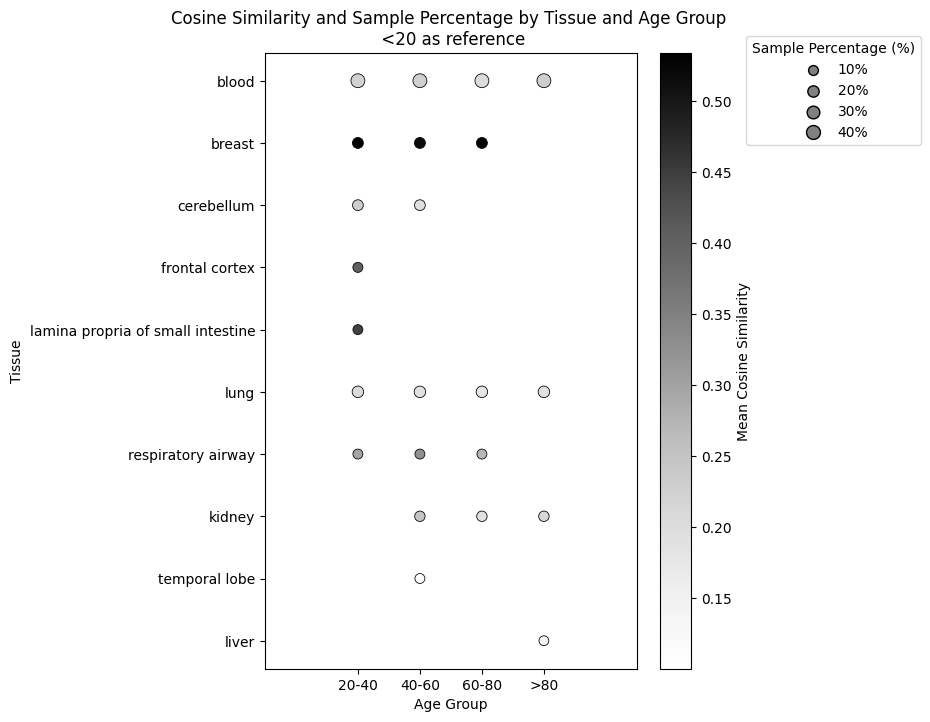

In [ ]:
combined_df = cal_cosine_sim(pd.DataFrame({
        'Embedding': age_embs,
        'Age Label':[age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],
        'Tissue Type': tissue_types
    }), "<20", ['20-40', '40-60','60-80', '>80'])

# Ensure that 'Age Group' is treated as a categorical variable
grouped_df = combined_df.groupby(['Age Label', 'Tissue']).agg({
    'Mean Cosine Similarity': 'mean',
    'Sample Percentage': 'mean'
}).reset_index()

# Plotting
plt.figure(figsize=(6, 8))

# Define the white-gray-black colormap
cmap = sns.color_palette("Greys", as_cmap=True)

# Create the scatterplot with a black edge color for visibility
scatter = sns.scatterplot(
    data=grouped_df,  # Pass the aggregated DataFrame here
    x='Age Label',  # Use Age Group for x-axis
    y='Tissue',  # Use Tissue for y-axis
    size='Sample Percentage',  # Size of the points
    hue='Mean Cosine Similarity',  # Color of the points
    sizes=(50, 100),  # Adjust the size range for better visibility
    palette=cmap,  # Use the defined colormap
    legend=False,  # Disable the default legend
    edgecolor='black'  # Black border around circles
)

# Add the colorbar for mean cosine similarity
norm = plt.Normalize(grouped_df['Mean Cosine Similarity'].min(), grouped_df['Mean Cosine Similarity'].max())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, label='Mean Cosine Similarity')

# Define specific fractions for the legend
fractions = [10, 20, 30, 40]
handles = [plt.scatter([], [], s=size, edgecolor='black', facecolor='gray')
           for size in np.linspace(50, 100, len(fractions))]

labels = [f'{frac}%' for frac in fractions]
plt.legend(handles, labels, title='Sample Percentage (%)', loc='upper right', borderaxespad=1, bbox_to_anchor=(1.8, 1.05))
plt.margins(x=0.5)

# Adjust plot aesthetics
plt.title('Cosine Similarity and Sample Percentage by Tissue and Age Group \n <20 as reference')
plt.xlabel('Age Group')
plt.ylabel('Tissue')

# Display the plot
plt.show()

Skipping tissue type 'cerebral nuclei' because it has only 40-60 age group.
Skipping tissue type 'cerebral nuclei' because it has only 40-60 age group.
Skipping tissue type 'cerebral nuclei' because it has only 40-60 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'thymus' because it has only 20-40 age group.
Skipping tissue type 'thymus' because it has only 60-80 age group.
Skipping tissue type 'thymus' because it has only >80 age group.
Skipping tissue type 'spleen' because it has only 40-60 age group.
Skipping tissue type 'spleen' because it has only 40-60 age group.
Skipping tissue type 'spleen' because it has only 40-60 age group.
Skipping tissue type 'transition zone of prostate' because it has only <20 age group.
Skipping tissue type 'transition zone of prostate' because it has only 20-40 age group.
Skipping tissue type 'transition zone of prostate' because it has only 60-80 age group.
Skipping tissue type 'transition zone of pros

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1055/2628151452.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label='Mean Cosine Similarity')


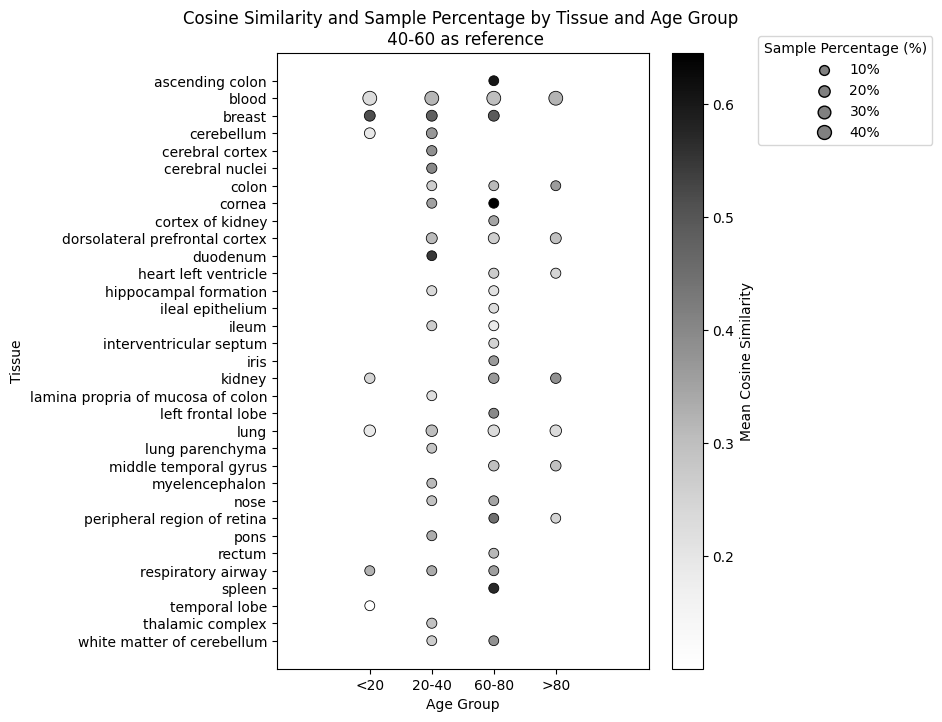

In [ ]:
age_order = ['<20', '20-40', '60-80', '>80']

# Create the DataFrame with ordered Age Labels
combined_df = cal_cosine_sim(pd.DataFrame({
    'Embedding': age_embs,
    'Age Label': [age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],
    'Tissue Type': tissue_types
}), "40-60", ['<20', '20-40', '60-80', '>80'])

# Convert 'Age Label' to a categorical type with the defined order
combined_df['Age Label'] = pd.Categorical(combined_df['Age Label'], categories=age_order, ordered=True)

# Ensure that 'Age Group' is treated as a categorical variable
grouped_df = combined_df.groupby(['Age Label', 'Tissue']).agg({
    'Mean Cosine Similarity': 'mean',
    'Sample Percentage': 'mean'
}).reset_index()

# Plotting
plt.figure(figsize=(6, 8))

# Define the white-gray-black colormap
cmap = sns.color_palette("Greys", as_cmap=True)

# Create the scatterplot with a black edge color for visibility
scatter = sns.scatterplot(
    data=grouped_df,  # Pass the aggregated DataFrame here
    x='Age Label',  # Use Age Group for x-axis
    y='Tissue',  # Use Tissue for y-axis
    size='Sample Percentage',  # Size of the points
    hue='Mean Cosine Similarity',  # Color of the points
    sizes=(50, 100),  # Adjust the size range for better visibility
    palette=cmap,  # Use the defined colormap
    legend=False,  # Disable the default legend
    edgecolor='black'  # Black border around circles
)

# Add the colorbar for mean cosine similarity
norm = plt.Normalize(grouped_df['Mean Cosine Similarity'].min(), grouped_df['Mean Cosine Similarity'].max())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, label='Mean Cosine Similarity')

# Define specific fractions for the legend
fractions = [10, 20, 30, 40]
handles = [plt.scatter([], [], s=size, edgecolor='black', facecolor='gray')
           for size in np.linspace(50, 100, len(fractions))]

labels = [f'{frac}%' for frac in fractions]
plt.legend(handles, labels, title='Sample Percentage (%)', loc='upper right', borderaxespad=1, bbox_to_anchor=(1.8, 1.05))
plt.margins(x=0.5)

# Adjust plot aesthetics
plt.title('Cosine Similarity and Sample Percentage by Tissue and Age Group \n 40-60 as reference')
plt.xlabel('Age Group')
plt.ylabel('Tissue')

# Display the plot
plt.show()

Skipping tissue type 'cerebral nuclei' because it has only 20-40 age group.
Skipping tissue type 'cerebral nuclei' because it has only 20-40 age group.
Skipping tissue type 'cerebral nuclei' because it has only 20-40 age group.
Skipping tissue type 'thymus' because it has only <20 age group.
Skipping tissue type 'thymus' because it has only 40-60 age group.
Skipping tissue type 'thymus' because it has only 60-80 age group.
Skipping tissue type 'thymus' because it has only >80 age group.
Skipping tissue type 'spleen' because it has only <20 age group.
Skipping tissue type 'spleen' because it has only 40-60 age group.
Skipping tissue type 'spleen' because it has only 60-80 age group.
Skipping tissue type 'spleen' because it has only >80 age group.
Skipping tissue type 'transition zone of prostate' because it has only <20 age group.
Skipping tissue type 'transition zone of prostate' because it has only 40-60 age group.
Skipping tissue type 'transition zone of prostate' because it has only

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1055/3458716709.py:42: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label='Mean Cosine Similarity')


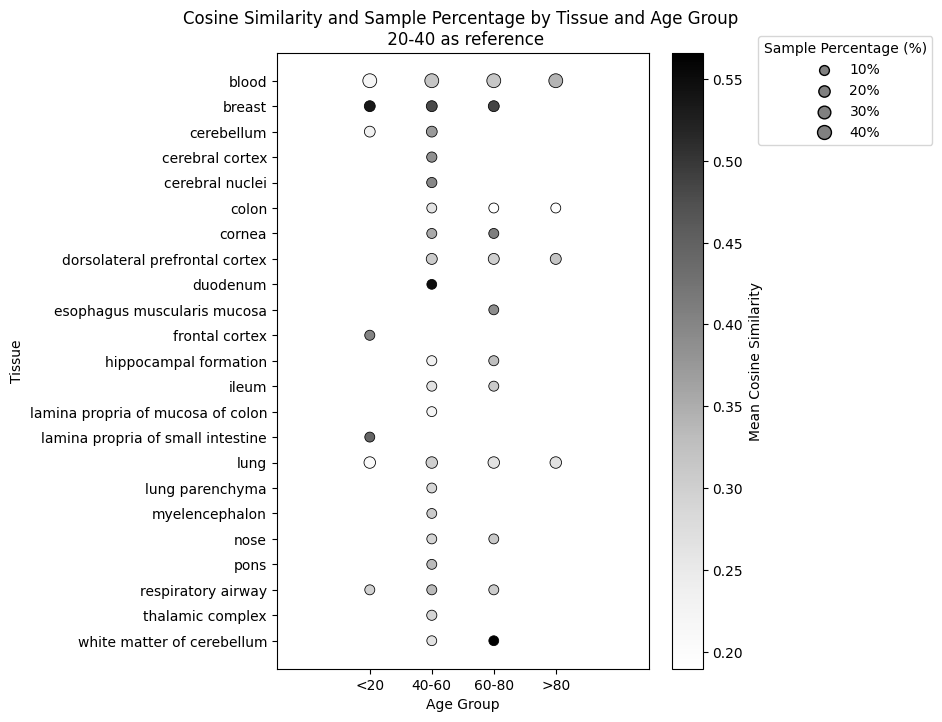

In [ ]:
age_order = ['<20', '40-60', '60-80', '>80']

# Create the DataFrame with ordered Age Labels
combined_df = cal_cosine_sim(pd.DataFrame({
    'Embedding': age_embs,
    'Age Label': [age_label_mapping_20[label] for label in validation_data.obs["development_stage"].to_list()],
    'Tissue Type': tissue_types
}), "20-40", ['<20', '40-60', '60-80', '>80'])

# Convert 'Age Label' to a categorical type with the defined order
combined_df['Age Label'] = pd.Categorical(combined_df['Age Label'], categories=age_order, ordered=True)

# Ensure that 'Age Group' is treated as a categorical variable
grouped_df = combined_df.groupby(['Age Label', 'Tissue']).agg({
    'Mean Cosine Similarity': 'mean',
    'Sample Percentage': 'mean'
}).reset_index()

# Plotting
plt.figure(figsize=(6, 8))

# Define the white-gray-black colormap
cmap = sns.color_palette("Greys", as_cmap=True)

# Create the scatterplot with a black edge color for visibility
scatter = sns.scatterplot(
    data=grouped_df,  # Pass the aggregated DataFrame here
    x='Age Label',  # Use Age Group for x-axis
    y='Tissue',  # Use Tissue for y-axis
    size='Sample Percentage',  # Size of the points
    hue='Mean Cosine Similarity',  # Color of the points
    sizes=(50, 100),  # Adjust the size range for better visibility
    palette=cmap,  # Use the defined colormap
    legend=False,  # Disable the default legend
    edgecolor='black'  # Black border around circles
)

# Add the colorbar for mean cosine similarity
norm = plt.Normalize(grouped_df['Mean Cosine Similarity'].min(), grouped_df['Mean Cosine Similarity'].max())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, label='Mean Cosine Similarity')

# Define specific fractions for the legend
fractions = [10, 20, 30, 40]
handles = [plt.scatter([], [], s=size, edgecolor='black', facecolor='gray')
           for size in np.linspace(50, 100, len(fractions))]

labels = [f'{frac}%' for frac in fractions]
plt.legend(handles, labels, title='Sample Percentage (%)', loc='upper right', borderaxespad=1, bbox_to_anchor=(1.8, 1.05))
plt.margins(x=0.5)

# Adjust plot aesthetics
plt.title('Cosine Similarity and Sample Percentage by Tissue and Age Group \n 20-40 as reference')
plt.xlabel('Age Group')
plt.ylabel('Tissue')

# Display the plot
plt.show()

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_3110/1373336642.py:40: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label='Mean Cosine Similarity')


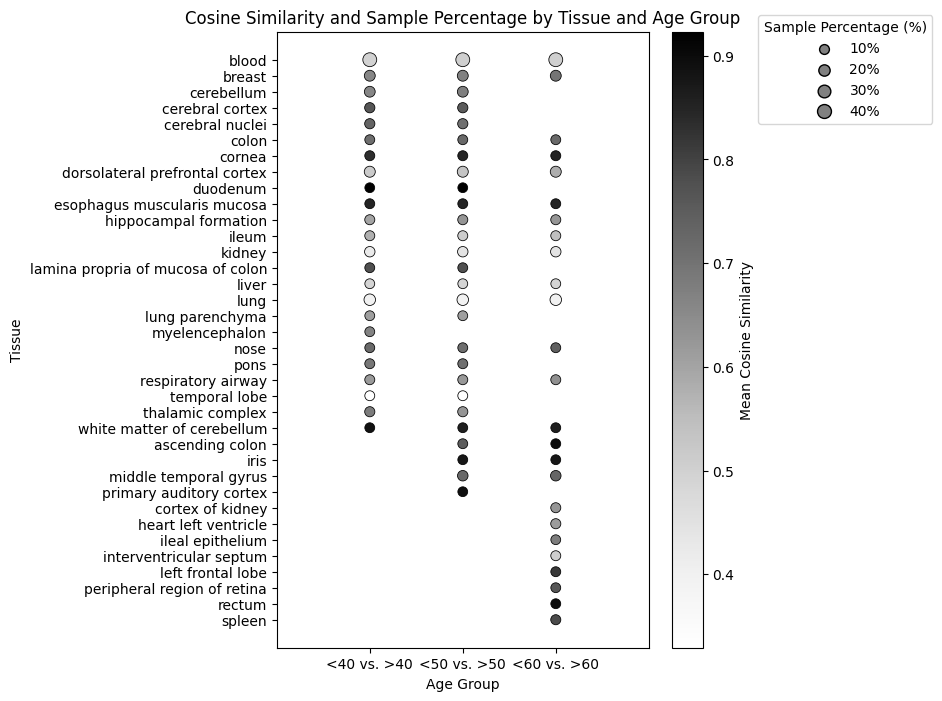

In [ ]:
combined_df = filtered_data_20

# Ensure that 'Age Group' is treated as a categorical variable
grouped_df = combined_df.groupby(['Age Label', 'Tissue']).agg({
    'Mean Cosine Similarity': 'mean',
    'Sample Percentage': 'mean'
}).reset_index()

# Plotting
plt.figure(figsize=(6, 8))

# Define the white-gray-black colormap
cmap = sns.color_palette("Greys", as_cmap=True)

# Create the scatterplot with a black edge color for visibility
scatter = sns.scatterplot(
    data=grouped_df,  # Pass the aggregated DataFrame here
    x='Age Group',  # Use Age Group for x-axis
    y='Tissue',  # Use Tissue for y-axis
    size='Sample Percentage',  # Size of the points
    hue='Mean Cosine Similarity',  # Color of the points
    sizes=(50, 100),  # Adjust the size range for better visibility
    palette=cmap,  # Use the defined colormap
    legend=False,  # Disable the default legend
    edgecolor='black'  # Black border around circles
)

# Add the colorbar for mean cosine similarity
norm = plt.Normalize(grouped_df['Mean Cosine Similarity'].min(), grouped_df['Mean Cosine Similarity'].max())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, label='Mean Cosine Similarity')

# Define specific fractions for the legend
fractions = [10, 20, 30, 40]
handles = [plt.scatter([], [], s=size, edgecolor='black', facecolor='gray')
           for size in np.linspace(50, 100, len(fractions))]

labels = [f'{frac}%' for frac in fractions]
plt.legend(handles, labels, title='Sample Percentage (%)', loc='upper right', borderaxespad=1, bbox_to_anchor=(1.8, 1.05))
plt.margins(x=0.5)

# Adjust plot aesthetics
plt.title('Cosine Similarity and Sample Percentage by Tissue and Age Group')
plt.xlabel('Age Group')
plt.ylabel('Tissue')

# Display the plot
plt.show()

In [ ]:

# Plotting
x_value = ["<40 vs. >40", "<50 vs. >50", "<60 vs. >60"]

plt.figure(figsize=(10, 6))

# Define the white-gray-black colormap
cmap = sns.color_palette("Greys", as_cmap=True)

# Create the scatterplot with a black edge color for visibility
scatter = sns.scatterplot(
    x=[x_value] * len(filtered_data),  # Use a constant x value for all tissues
    y=filtered_data['Tissue'],
    size=filtered_data['Sample Percentage'],
    hue=filtered_data['Mean Cosine Similarity'],
    sizes=(10, 100),  # Adjust the sizes for better visibility
    palette=cmap,  # Use the defined colormap
    legend=False,  # Disable the default legend
    edgecolor='black'  # Black border around circles
)

# Add the colorbar for mean cosine similarity
norm = plt.Normalize(filtered_data['Mean Cosine Similarity'].min(), filtered_data['Mean Cosine Similarity'].max())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, label='Mean Cosine Similarity (Change Most)')

# Define specific fractions for the legend
fractions = [5, 10, 15, 20]
handles = [plt.scatter([], [], s=size, edgecolor='black', facecolor='gray')
           for size in np.linspace(10, 100, len(fractions))]

labels = [f'{frac}%' for frac in fractions]
plt.legend(handles, labels, title='Fraction of cells in group (%)', loc='upper right', borderaxespad=1)
plt.margins(y=0.01) 
# Adjust plot aesthetics
plt.title('Cosine Similarity between Young and Old Embeddings by Tissue Type')
plt.xlabel('Age Group')
plt.ylabel('Tissue Type')

# Display the plot
plt.show()

### 

### Aging genes 

In [5]:
import torch
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_2464/1724759396.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=np.arange(num_tissues), y=tissue_variances, palette='viridis')


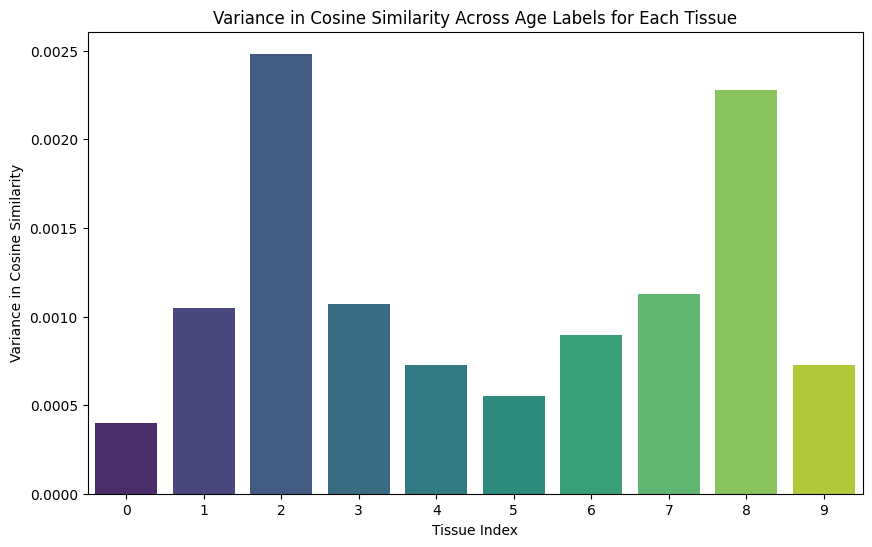

In [ ]:
import torch
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import seaborn as sns

# Simulated data parameters
num_tissues = 10
num_age_labels = 5
num_samples_per_label = 100
embedding_dim = 768

# Simulate tissue embeddings (replace with your actual data)
# Shape: (num_tissues, num_age_labels, num_samples_per_label, embedding_dim)
embeddings = torch.randn(num_tissues, num_age_labels, num_samples_per_label, embedding_dim)

# Function to compute cosine similarity for each tissue across age labels
def compute_cosine_variance(embeddings):
    tissue_variances = []
    for tissue in range(num_tissues):
        age_cosine_similarities = []
        # Compare each age label's mean embedding with every other age label
        for i in range(num_age_labels):
            for j in range(i + 1, num_age_labels):
                mean_embedding_i = embeddings[tissue, i].mean(dim=0)
                mean_embedding_j = embeddings[tissue, j].mean(dim=0)
                # Calculate cosine similarity between the two age group embeddings
                cosine_sim = cosine_similarity(mean_embedding_i.unsqueeze(0), mean_embedding_j.unsqueeze(0)).item()
                age_cosine_similarities.append(cosine_sim)
        # Compute the variance of the cosine similarities across age groups
        variance = np.var(age_cosine_similarities)
        tissue_variances.append(variance)
    return tissue_variances

# Calculate the variance for each tissue
tissue_variances = compute_cosine_variance(embeddings)

# Visualize the variances to identify tissues with the highest changes
plt.figure(figsize=(10, 6))
sns.barplot(x=np.arange(num_tissues), y=tissue_variances, palette='viridis')
plt.title('Variance in Cosine Similarity Across Age Labels for Each Tissue')
plt.xlabel('Tissue Index')
plt.ylabel('Variance in Cosine Similarity')
plt.show()


### Aging genes

In [3]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import pickle

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1270/3413148363.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, ha="left", rotation_mode='anchor')


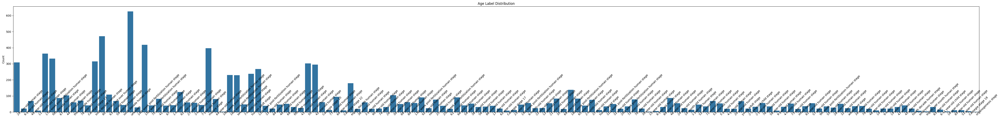

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example list of age labels (replace with your actual data)
age_labels = validation_data.obs["development_stage"].to_list()

# Create a seaborn plot for the distribution of age labels
plt.figure(figsize=(50, 6))
ax = sns.countplot(x=age_labels)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, ha="left", rotation_mode='anchor') 
# Rotate x-axis labels by 45 degrees to the left
#plt.xticks(rotation=45, ha='left')

# Set y-axis label and title
plt.ylabel('Count')
plt.title('Age Label Distribution')

# Show the plot
plt.tight_layout()
plt.show()


### lowest cosine simliairty between young and old

In [4]:
adata

AnnData object with n_obs × n_vars = 10000 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status', 'RBX1_embedding_status', 'FBXO7_embedding_status', 'CUL1_embedding_status', 'PINK1_embedding_status', 'PARK7_embedding_status', 'GIGYF2_embedding_status', 'ATP13A2_embedding_status', 'PRKN_embedding_status', 'PLA2G6_embedding_status', 'SKP1_embedding_status', 'LONP2_embedding_status', 'CNTNAP2_embe

In [32]:
# List of gene names
gene_names = [
    "LONP2", "CNTNAP2", "PPP1CB", "CNTN1", "KCNH7", "SNX29", "EXOC4", "FOXJ3", 
    "CACYBP", "CNTN5", "PPP3CA", "HIVEP2", "IMMP2L", "IFITM3", "COA1", "UBAC2", 
    "MAGI3", "MIR99AHG", "CAMTA1", "NAGK", "ARHGAP21", "COX7A2", "CDKAL1", "ZBTB20"
]

# Dictionary to store the results for each gene
gene_embeddings = {}

# Iterate through the gene names and apply the adata2cos_gene function
for gene in gene_names:
    gene_embeddings[gene] = adata2cos_gene(
        adata[(adata.obs[f'{gene}_embedding_status'] == "present") & (adata.obs["disease"] == "normal")],
        gene,
        age_label_mapping_10,
        "20-30"
    )


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1092/4136882294.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1092/4136882294.py:20: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['cosine_similarity_with_<20'] = cos_sim_results
/U

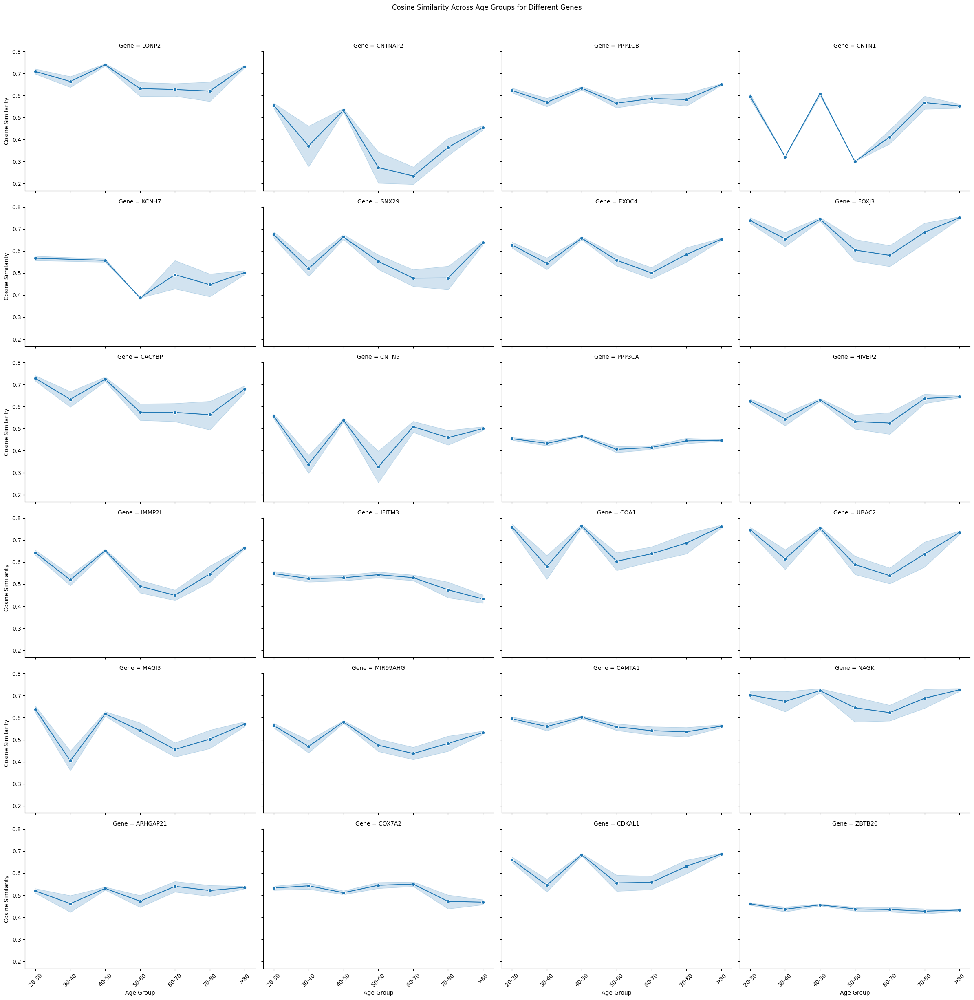

In [38]:
data = []

# Loop through each gene's AnnData object in the dictionary
for gene, adata in gene_embeddings.items():
    # Extract age groups and cosine similarities for <20
    age_groups = adata.obs['age_group'].to_list()
    cosine_similarities = adata.obs['cosine_similarity_with_<20'].to_list()
    
    # Append gene, age groups, and cosine similarities to the data list
    for age, cosine in zip(age_groups, cosine_similarities):
        data.append([gene, age, cosine])

# Convert the list into a DataFrame
df = pd.DataFrame(data, columns=['Gene', 'Age Group', 'Cosine Similarity'])

# Define the order of age groups
age_group_order = ["20-30", "30-40", "40-50", "50-60", "60-70", "70-80", ">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Create a FacetGrid for each gene
g = sns.FacetGrid(df, col="Gene", col_wrap=4, height=4, aspect=1.5)

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Set x-axis labels for each subplot
for ax in g.axes.flat:
    ax.set_xticks(range(len(age_group_order)))  # Ensure ticks for each age group
    ax.set_xticklabels(age_group_order, rotation=45)  # Set tick labels with rotation

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.show()

In [31]:
LONP2 = adata2cos_gene(adata[adata.obs['LONP2_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"LONP2", age_label_mapping_10, "20-30")
CNTNAP2 = adata2cos_gene(adata[adata.obs['CNTNAP2_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CNTNAP2", age_label_mapping_10, "20-30")
PPP1CB = adata2cos_gene(adata[adata.obs['PPP1CB_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"PPP1CB", age_label_mapping_10, "20-30")
CNTN1 = adata2cos_gene(adata[adata.obs['CNTN1_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CNTN1", age_label_mapping_10, "20-30")
KCNH7 = adata2cos_gene(adata[adata.obs['KCNH7_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"KCNH7", age_label_mapping_10, "20-30")
SNX29 = adata2cos_gene(adata[adata.obs['SNX29_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"SNX29", age_label_mapping_10, "20-30")
EXOC4 = adata2cos_gene(adata[adata.obs['EXOC4_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"EXOC4", age_label_mapping_10, "20-30")
FOXJ3 = adata2cos_gene(adata[adata.obs['FOXJ3_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"FOXJ3", age_label_mapping_10, "20-30")
CACYBP = adata2cos_gene(adata[adata.obs['CACYBP_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CACYBP", age_label_mapping_10, "20-30")
CNTN5 = adata2cos_gene(adata[adata.obs['CNTN5_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CNTN5", age_label_mapping_10, "20-30")
PPP3CA = adata2cos_gene(adata[adata.obs['PPP3CA_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"PPP3CA", age_label_mapping_10, "20-30")
HIVEP2 = adata2cos_gene(adata[adata.obs['HIVEP2_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"HIVEP2", age_label_mapping_10, "20-30")
IMMP2L = adata2cos_gene(adata[adata.obs['IMMP2L_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"IMMP2L", age_label_mapping_10, "20-30")
IFITM3 = adata2cos_gene(adata[adata.obs['IFITM3_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"IFITM3", age_label_mapping_10, "20-30")
COA1 = adata2cos_gene(adata[adata.obs['COA1_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"COA1", age_label_mapping_10, "20-30")
UBAC2 = adata2cos_gene(adata[adata.obs['UBAC2_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"UBAC2", age_label_mapping_10, "20-30")
MAGI3 = adata2cos_gene(adata[adata.obs['MAGI3_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"MAGI3", age_label_mapping_10, "20-30")
MIR99AHG = adata2cos_gene(adata[adata.obs['MIR99AHG_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"MIR99AHG", age_label_mapping_10, "20-30")
CAMTA1 = adata2cos_gene(adata[adata.obs['CAMTA1_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CAMTA1", age_label_mapping_10, "20-30")
NAGK = adata2cos_gene(adata[adata.obs['NAGK_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"NAGK", age_label_mapping_10, "20-30")
ARHGAP21 = adata2cos_gene(adata[adata.obs['ARHGAP21_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"ARHGAP21", age_label_mapping_10, "20-30")
COX7A2 = adata2cos_gene(adata[adata.obs['COX7A2_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"COX7A2", age_label_mapping_10, "20-30")
CDKAL1 = adata2cos_gene(adata[adata.obs['CDKAL1_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"CDKAL1", age_label_mapping_10, "20-30")
ZBTB20 = adata2cos_gene(adata[adata.obs['ZBTB20_embedding_status'] == "present" and adata.obs["disease"] == "normal"],"ZBTB20", age_label_mapping_10, "20-30")

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [29]:
adata.obs["disease"] == "normal"

,soma_joinid_column,dataset_id,assay,assay_ontology_term_id,cell_type,cell_type_ontology_term_id,development_stage,development_stage_ontology_term_id,disease,disease_ontology_term_id,...,COA1_embedding_status,UBAC2_embedding_status,MAGI3_embedding_status,MIR99AHG_embedding_status,CAMTA1_embedding_status,NAGK_embedding_status,ARHGAP21_embedding_status,COX7A2_embedding_status,CDKAL1_embedding_status,ZBTB20_embedding_status
soma_joinid,,,,,,,,,,,,,,,,,,,,,
27387386,27387386,43b7e156-65b3-4a7b-8c7a-08528e4b21d0,10x 3' v3,EFO:0009922,neuron,CL:0000540,29-year-old human stage,HsapDv:0000123,normal,PATO:0000461,...,present,present,missing,present,present,missing,present,missing,present,present
46492259,46492259,ebc2e1ff-c8f9-466a-acf4-9d291afaf8b3,10x 5' v1,EFO:0011025,classical monocyte,CL:0000860,6-year-old human stage,HsapDv:0000100,COVID-19,MONDO:0100096,...,missing,missing,missing,missing,missing,missing,missing,present,missing,missing
53966434,53966434,9dbab10c-118d-496b-966a-67f1763a6b7d,10x 5' v2,EFO:0009900,"CD8-positive, alpha-beta T cell",CL:0000625,49-year-old human stage,HsapDv:0000143,normal,PATO:0000461,...,missing,missing,missing,missing,missing,missing,missing,missing,missing,missing
3060050,3060050,cf83c98a-3791-4537-bbde-a719f6d73c13,10x 3' v3,EFO:0009922,common lymphoid progenitor,CL:0000051,11-month-old human stage,HsapDv:0000184,B-cell acute lymphoblastic leukemia,MONDO:0004947,...,missing,missing,missing,missing,missing,missing,missing,present,missing,missing
39447246,39447246,cda2c8cd-be1c-42e5-b2cd-162caa1c4ce7,10x 5' v1,EFO:0011025,"double-positive, alpha-beta thymocyte",CL:0000809,17th week post-fertilization human stage,HsapDv:0000054,normal,PATO:0000461,...,present,present,missing,missing,present,missing,missing,present,present,present
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40379221,40379221,82f6af6d-5313-439a-9936-5e844be49a70,Drop-seq,EFO:0008722,glutamatergic neuron,CL:0000679,7-month-old human stage,HsapDv:0000180,normal,PATO:0000461,...,missing,missing,missing,missing,missing,missing,present,missing,present,missing
32787844,32787844,4e74d843-8d7a-497a-918a-f079ef141b6d,10x 3' v2,EFO:0009899,colon goblet cell,CL:0009039,67-year-old human stage,HsapDv:0000161,adenocarcinoma,MONDO:0004970,...,missing,present,missing,missing,present,missing,missing,present,missing,missing
3739413,3739413,07760522-707a-4a1c-8891-dbd1226d6b27,10x 3' v3,EFO:0009922,astrocyte,CL:0000127,76-year-old human stage,HsapDv:0000170,Parkinson disease,MONDO:0005180,...,missing,present,present,present,missing,missing,missing,missing,present,present


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1092/2946712969.py:38: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)


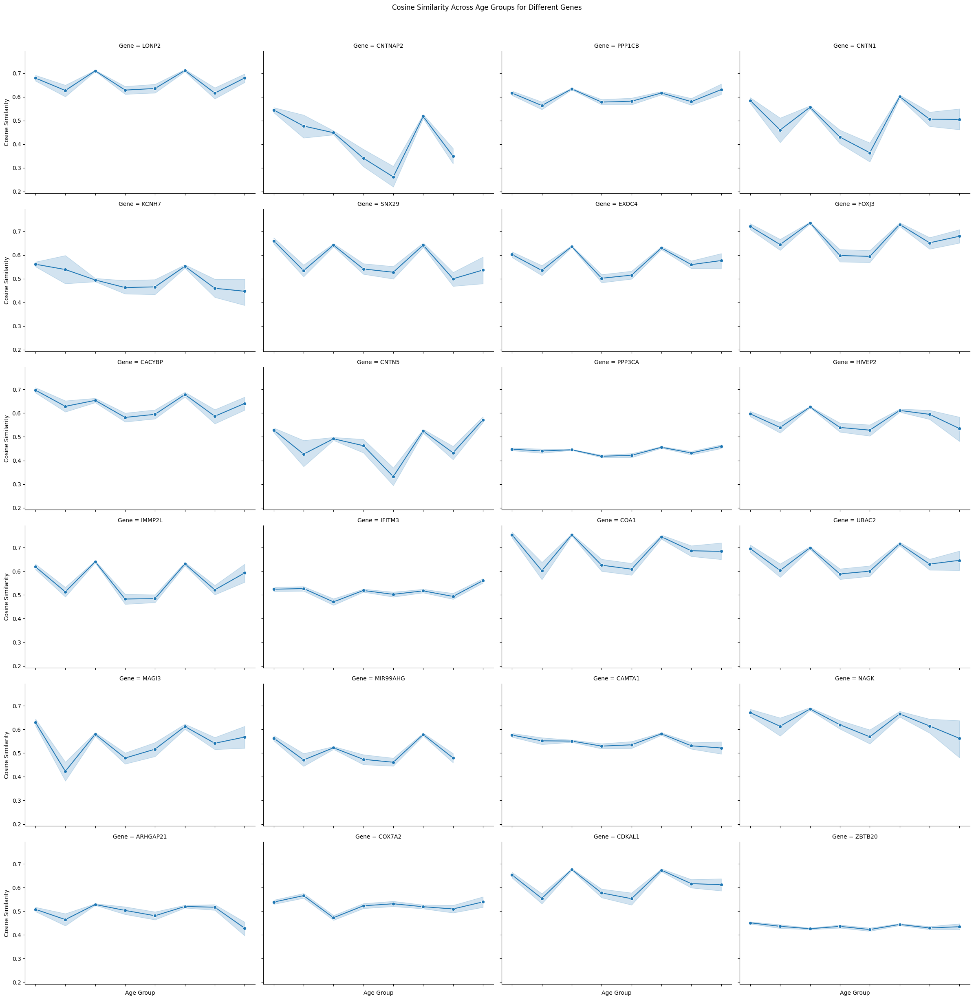

In [36]:
df = pd.DataFrame({
    'Age Group': LONP2.obs['age_group'].to_list() + CNTNAP2.obs['age_group'].to_list() + PPP1CB.obs['age_group'].to_list() 
    + CNTN1.obs["age_group"].to_list()+ KCNH7.obs["age_group"].to_list()+ SNX29.obs["age_group"].to_list()+ EXOC4.obs["age_group"].to_list()
    + FOXJ3.obs["age_group"].to_list()+ CACYBP.obs["age_group"].to_list()+ CNTN5.obs["age_group"].to_list()+ PPP3CA.obs["age_group"].to_list()
    + HIVEP2.obs["age_group"].to_list()+ IMMP2L.obs["age_group"].to_list()+ IFITM3.obs["age_group"].to_list()+ COA1.obs["age_group"].to_list()
    + UBAC2.obs["age_group"].to_list()+ MAGI3.obs["age_group"].to_list()+ MIR99AHG.obs["age_group"].to_list()+ CAMTA1.obs["age_group"].to_list()
    + NAGK.obs["age_group"].to_list()+ ARHGAP21.obs["age_group"].to_list()+ COX7A2.obs["age_group"].to_list()+ CDKAL1.obs["age_group"].to_list()
    +ZBTB20.obs["age_group"].to_list(),
    'Cosine Similarity': LONP2.obs['cosine_similarity_with_<20'].to_list() + CNTNAP2.obs['cosine_similarity_with_<20'].to_list()
    +PPP1CB.obs['cosine_similarity_with_<20'].to_list() + CNTN1.obs['cosine_similarity_with_<20'].to_list()
    + KCNH7.obs['cosine_similarity_with_<20'].to_list() + SNX29.obs['cosine_similarity_with_<20'].to_list()
    + EXOC4.obs['cosine_similarity_with_<20'].to_list()+ FOXJ3.obs['cosine_similarity_with_<20'].to_list()
    + CACYBP.obs['cosine_similarity_with_<20'].to_list()+ CNTN5.obs['cosine_similarity_with_<20'].to_list()
    + PPP3CA.obs['cosine_similarity_with_<20'].to_list()+ HIVEP2.obs['cosine_similarity_with_<20'].to_list()
    + IMMP2L.obs['cosine_similarity_with_<20'].to_list()+ IFITM3.obs['cosine_similarity_with_<20'].to_list()
    + COA1.obs['cosine_similarity_with_<20'].to_list()+ UBAC2.obs['cosine_similarity_with_<20'].to_list()
    + MAGI3.obs['cosine_similarity_with_<20'].to_list()+ MIR99AHG.obs['cosine_similarity_with_<20'].to_list()
    + CAMTA1.obs['cosine_similarity_with_<20'].to_list()+ NAGK.obs['cosine_similarity_with_<20'].to_list()
    + ARHGAP21.obs['cosine_similarity_with_<20'].to_list()+ COX7A2.obs['cosine_similarity_with_<20'].to_list() 
    + CDKAL1.obs['cosine_similarity_with_<20'].to_list() + ZBTB20.obs['cosine_similarity_with_<20'].to_list(),
    'Gene': ["LONP2"]*len(LONP2) + ["CNTNAP2"]*len(CNTNAP2) + ["PPP1CB"]*len(PPP1CB) + ["CNTN1"]*len(CNTN1)+ ["KCNH7"]*len(KCNH7)
     + ["SNX29"]*len(SNX29)+ ["EXOC4"]*len(EXOC4)+ ["FOXJ3"]*len(FOXJ3)+ ["CACYBP"]*len(CACYBP)+ ["CNTN5"]*len(CNTN5)
     + ["PPP3CA"]*len(PPP3CA) + ["HIVEP2"]*len(HIVEP2)+ ["IMMP2L"]*len(IMMP2L)+ ["IFITM3"]*len(IFITM3)+ ["COA1"]*len(COA1)
     + ["UBAC2"]*len(UBAC2)+ ["MAGI3"]*len(MAGI3)+ ["MIR99AHG"]*len(MIR99AHG)+ ["CAMTA1"]*len(CAMTA1)+ ["NAGK"]*len(NAGK)
     + ["ARHGAP21"]*len(ARHGAP21)+ ["COX7A2"]*len(COX7A2)+ ["CDKAL1"]*len(CDKAL1)+ ["ZBTB20"]*len(ZBTB20)# Assuming the gene info is stored in obs or manually added
})
age_group_order = ["10-20","20-30","30-40", "40-50", "50-60","60-70","70-80", ">80"]
#age_group_order = ["<20","20-40", "40-60","60-80",">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
g = sns.FacetGrid(df, col="Gene", col_wrap=4, height=4, aspect=1.5)  # col_wrap controls number of plots per row

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Rotate x-axis labels for readability
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.show()

In [34]:
data = []

# Loop through each gene's AnnData object in the dictionary
for gene, adata in gene_embedding.items():
    # Extract age groups and cosine similarities for <20
    age_groups = adata.obs['age_group'].to_list()
    cosine_similarities = adata.obs['cosine_similarity_with_<20'].to_list()
    
    # Append gene, age groups, and cosine similarities to the data list
    for age, cosine in zip(age_groups, cosine_similarities):
        data.append([gene, age, cosine])

# Convert the list into a DataFrame
df = pd.DataFrame(data, columns=['Gene', 'Age Group', 'Cosine Similarity'])

# Define the order of age groups
age_group_order = ["10-20", "20-30", "30-40", "40-50", "50-60", "60-70", "70-80", ">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Create a FacetGrid for each gene
g = sns.FacetGrid(df, col="Gene", col_wrap=4, height=4, aspect=1.5)

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Rotate x-axis labels for readability
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.show()

NameError: name 'gene_embedding' is not defined

### '29-year-old human stage' most

In [ ]:
adata

In [8]:
FBXL19 = adata[adata.obs['FBXL19_embedding_status'] == "present"]
FBXL19

View of AnnData object with n_obs × n_vars = 668 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'FBXL19_embeddings', 'GSK3A_embeddings', 'TRAF5_e

In [9]:
GSK3A = adata[adata.obs['GSK3A_embedding_status'] == "present"]
GSK3A

View of AnnData object with n_obs × n_vars = 1112 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'FBXL19_embeddings', 'GSK3A_embeddings', 'TRAF5_

In [10]:
TRAF5= adata[adata.obs['TRAF5_embedding_status'] == "present"]
TRAF5

View of AnnData object with n_obs × n_vars = 999 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'FBXL19_embeddings', 'GSK3A_embeddings', 'TRAF5_e

In [59]:
adata

AnnData object with n_obs × n_vars = 10000 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status', 'RBX1_embedding_status', 'FBXO7_embedding_status', 'CUL1_embedding_status', 'PINK1_embedding_status', 'PARK7_embedding_status', 'GIGYF2_embedding_status', 'ATP13A2_embedding_status', 'PRKN_embedding_status', 'PLA2G6_embedding_status', 'SKP1_embedding_status', 'LONP2_embedding_status', 'CNTNAP2_embe

In [86]:
for cell_type in ["neuron"]:
    cell_type_changes = {}
    
    # Subset data for the current cell type
    cells_of_type = adata[adata.obs['cell_type'] == cell_type]
    
    for gene in genes:
        if f'{gene}_embedding_status' in cells_of_type.obs.columns:
            # Filter cells that have valid embeddings for the gene
            valid_cells = cells_of_type[cells_of_type.obs[f'{gene}_embedding_status'] == 'present']
            valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
            
            if valid_cells.n_obs > 0:
                age_embeddings = {}
                
                # Get embeddings for both specified age groups
                for age_group in [age_group_1, age_group_2]:
                    age_group_cells = valid_cells[valid_cells.obs['age_group'] == age_group]
                    
                    if age_group_cells.n_obs > 0:
                        # Store the gene embeddings for the given age group
                        age_embeddings[age_group] = age_group_cells.obsm[f'{gene}_embeddings']
                
                # Ensure both age groups have data
                if age_group_1 in age_embeddings and age_group_2 in age_embeddings:
                    # Get embeddings for the two groups
                    emb_g1 = age_embeddings[age_group_1]
                    emb_g2 = age_embeddings[age_group_2]
                    
                    # Compute pairwise cosine similarity between the two groups
                    cos_sim = cosine_similarity(emb_g1, emb_g2).mean()
                    
                    # Store the similarity result for the gene
                    cell_type_changes[gene] = cos_sim

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/805642763.py:11: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/805642763.py:11: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = valid

In [84]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity

# Initialize a dictionary to store results for each cell type
cell_type_gene_changes = {}

# List of cell types and genes, after stripping '_embeddings' from obsm keys
cell_types = adata.obs['cell_type'].unique()
genes = [key.replace('_embeddings', '') for key in adata.obsm.keys() if "_embeddings" in key][:-2]

# Define the age groups to compare
age_group_1 = '10-20'
age_group_2 = '70-80'

for cell_type in cell_types:
    cell_type_changes = {}
    
    # Subset data for the current cell type
    cells_of_type = adata[adata.obs['cell_type'] == cell_type]
    
    for gene in genes:
        if f'{gene}_embedding_status' in cells_of_type.obs.columns:
            # Filter cells that have valid embeddings for the gene
            valid_cells = cells_of_type[cells_of_type.obs[f'{gene}_embedding_status'] == 'present']
            valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
            
            if valid_cells.n_obs > 0:
                age_embeddings = {}
                
                # Get embeddings for both specified age groups
                for age_group in [age_group_1, age_group_2]:
                    age_group_cells = valid_cells[valid_cells.obs['age_group'] == age_group]
                    
                    if age_group_cells.n_obs > 0:
                        # Store the gene embeddings for the given age group
                        age_embeddings[age_group] = age_group_cells.obsm[f'{gene}_embeddings']
                
                # Ensure both age groups have data
                if age_group_1 in age_embeddings and age_group_2 in age_embeddings:
                    # Get embeddings for the two groups
                    emb_g1 = age_embeddings[age_group_1]
                    emb_g2 = age_embeddings[age_group_2]
                    
                    # Compute pairwise cosine similarity between the two groups
                    cos_sim = cosine_similarity(emb_g1, emb_g2).mean()
                    
                    # Store the similarity result for the gene
                    cell_type_changes[gene] = cos_sim
    
    # Sort genes by the lowest cosine similarity (indicating the most change between the two age groups)
    cell_type_gene_changes[cell_type] = sorted(cell_type_changes.items(), key=lambda x: x[1])

# Summary
for cell_type, gene_changes in cell_type_gene_changes.items():
    print(f"Top changing genes for cell type {cell_type} (lowest similarity between {age_group_1} and {age_group_2}):")
    for gene, similarity in gene_changes[:5]:  # Show top 5 genes with the lowest similarity
        print(f"Gene: {gene}, Cosine Similarity: {similarity}")


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/3372574152.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/3372574152.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = val

Top changing genes for cell type neuron (lowest similarity between 10-20 and 70-80):
Top changing genes for cell type classical monocyte (lowest similarity between 10-20 and 70-80):
Top changing genes for cell type CD8-positive, alpha-beta T cell (lowest similarity between 10-20 and 70-80):
Gene: LONP2, Cosine Similarity: 0.6021435260772705
Gene: CUL1, Cosine Similarity: 0.6204456090927124
Gene: IFITM3, Cosine Similarity: 0.6587220430374146
Gene: TRAF5, Cosine Similarity: 0.7324415006956756
Gene: FOXJ3, Cosine Similarity: 0.7328698039054871
Top changing genes for cell type common lymphoid progenitor (lowest similarity between 10-20 and 70-80):
Top changing genes for cell type double-positive, alpha-beta thymocyte (lowest similarity between 10-20 and 70-80):
Top changing genes for cell type CD4-positive, alpha-beta T cell (lowest similarity between 10-20 and 70-80):
Top changing genes for cell type CD4-positive, alpha-beta thymocyte (lowest similarity between 10-20 and 70-80):
Top chang

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/3372574152.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/3372574152.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique

In [8]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity

# Initialize a dictionary to store results for each cell type
cell_type_gene_changes = {}

# List of cell types and genes
cell_types = adata.obs['cell_type'].unique()
genes = [key.replace('_embeddings', '') for key in adata.obsm.keys() if "_embeddings" in key][:-2]  # Assuming each gene's embedding is in obsm

for cell_type in cell_types:
    cell_type_changes = {}
    
    # Subset data for the current cell type
    cells_of_type = adata[adata.obs['cell_type'] == cell_type]
    
    for gene in genes:
        if f'{gene}_embedding_status' in cells_of_type.obs.columns:
            # Filter cells that have valid embeddings for the gene
            valid_cells = cells_of_type[cells_of_type.obs[f'{gene}_embedding_status'] == 'present']
            
            if valid_cells.n_obs > 0:
                # Group the data by age
                valid_cells.obs["age_group"] = valid_cells.obs["development_stage"].map(age_label_mapping_10).to_list()
                age_groups = valid_cells.obs['age_group'].unique()
                age_embeddings = {}
                
                for age_group in age_groups:
                    age_group_cells = valid_cells[valid_cells.obs['age_group'] == age_group]
                    
                    if age_group_cells.n_obs > 0:
                        # Get gene embeddings for the current age group
                        age_embeddings[age_group] = age_group_cells.obsm[f'{gene}_embeddings']
                
                # Calculate cosine similarity between age groups
                age_group_pairs = [(g1, g2) for i, g1 in enumerate(age_groups) for g2 in age_groups[i+1:]]
                similarities = []
                
                for g1, g2 in age_group_pairs:
                    emb_g1 = age_embeddings[g1]
                    emb_g2 = age_embeddings[g2]
                    
                    # Compute pairwise cosine similarity
                    cos_sim = cosine_similarity(emb_g1, emb_g2).mean()
                    similarities.append(abs(cos_sim))
                
                # Compute the average similarity change for the gene
                avg_similarity_change = np.mean(similarities)
                
                # Store the result for the gene
                cell_type_changes[gene] = avg_similarity_change
    
    # Rank genes by the change in cosine similarity
    cell_type_gene_changes[cell_type] = sorted(cell_type_changes.items(), key=lambda x: x[1], reverse=True)

# Summary
for cell_type, gene_changes in cell_type_gene_changes.items():
    print(f"Top changing genes for cell type {cell_type}:")
    for gene, change in gene_changes[:5]:  # Top 5 genes
        print(f"Gene: {gene}, Average Change in Cosine Similarity: {change}")


NameError: name 'age_label_mapping_10' is not defined

In [3]:
def adata2cos_gene_cell_type(adata, cell_type, gene, age_map, reference="10-20"):
    adata = adata[(adata.obs[f'{gene}_embedding_status'] == "present") & (adata.obs["cell_type"] == cell_type)]
    adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
    adata = adata[~adata.obs["age_group"].isin(["unknown"])]
    embeddings = adata.obsm[f'{gene}_embeddings']  # Assuming embeddings are stored in 'gene_embeddings'
    age_groups = adata.obs['age_group']
    reference_embeddings = embeddings[age_groups == reference]

    if len(reference_embeddings) == 0:
        print(f"no embedding left for {gene}")
        return

    cos_sim_results = np.full(len(adata), np.nan)  # To handle cases where no similarity can be computed

    # Iterate through every single cell in adata
    for i in range(len(adata)):
        current_cell_embedding = embeddings[i].reshape(1, -1)  # Reshape to match dimensions for cosine_similarity
        
        cos_sim = cosine_similarity(current_cell_embedding, reference_embeddings).mean()

        # Store the computed similarity for the current cell
        cos_sim_results[i] = cos_sim

    adata.obs['cosine_similarity_with_<20'] = cos_sim_results
    return adata

In [4]:
def adata2cos_gene(adata, gene, age_map, reference="10-20"):
    adata = adata[(adata.obs[f'{gene}_embedding_status'] == "present")]
    adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
    adata = adata[~adata.obs["age_group"].isin(["unknown"])]
    embeddings = adata.obsm[f'{gene}_embeddings']  # Assuming embeddings are stored in 'gene_embeddings'
    age_groups = adata.obs['age_group']
    reference_embeddings = embeddings[age_groups == reference]

    if len(reference_embeddings) == 0:
        print(f"no embedding left for {gene}")
        return

    cos_sim_results = np.full(len(adata), np.nan)  # To handle cases where no similarity can be computed

    # Iterate through every single cell in adata
    for i in range(len(adata)):
        current_cell_embedding = embeddings[i].reshape(1, -1)  # Reshape to match dimensions for cosine_similarity
        
        cos_sim = cosine_similarity(current_cell_embedding, reference_embeddings).mean()

        # Store the computed similarity for the current cell
        cos_sim_results[i] = cos_sim

    adata.obs['cosine_similarity_with_<20'] = cos_sim_results
    return adata

In [5]:
def adata2cos_gene_healthy(adata, gene, age_map, reference="10-20"):
    adata = adata[(adata.obs[f'{gene}_embedding_status'] == "present") & (adata.obs["disease"] == "normal")]
    adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
    adata = adata[~adata.obs["age_group"].isin(["unknown"])]
    embeddings = adata.obsm[f'{gene}_embeddings']  # Assuming embeddings are stored in 'gene_embeddings'
    age_groups = adata.obs['age_group']
    reference_embeddings = embeddings[age_groups == reference]

    if len(reference_embeddings) == 0:
        print(f"no embedding left for {gene}")
        return

    cos_sim_results = np.full(len(adata), np.nan)  # To handle cases where no similarity can be computed

    # Iterate through every single cell in adata
    for i in range(len(adata)):
        current_cell_embedding = embeddings[i].reshape(1, -1)  # Reshape to match dimensions for cosine_similarity
        
        cos_sim = cosine_similarity(current_cell_embedding, reference_embeddings).mean()

        # Store the computed similarity for the current cell
        cos_sim_results[i] = cos_sim

    adata.obs['cosine_similarity_with_<20'] = cos_sim_results
    return adata

In [7]:
data = []

for cell_type, gene_cos in cell_type_gene_changes.items():
    if len(gene_cos) > 0:
        for genes in gene_cos:
            if genes[1] <= 0.5:
                present_cells = adata[adata.obs[f'{genes[0]}_embedding_status'] == "present"]
                if present_cells.n_obs > 0:  # Ensure there are cells with embeddings
                    gene_data = adata2cos_gene(present_cells, genes[0], age_label_mapping_10, "10-20")
                    if gene_data is not None:  # Check if adata2cos_gene returned non-empty data
                        # Append the data to the list
                        data.append({
                            'Age Group': gene_data.obs['age_group'].to_list(),
                            'Cosine Similarity': gene_data.obs['cosine_similarity_with_<20'].to_list(),
                            'Gene': [genes[0]] * len(gene_data),
                            "Cell Type": [cell_type] * len(gene_data)
                        })
df = pd.DataFrame({
    'Age Group': [item for sublist in [d['Age Group'] for d in data] for item in sublist],
    'Cosine Similarity': [item for sublist in [d['Cosine Similarity'] for d in data] for item in sublist],
    'Gene': [item for sublist in [d['Gene'] for d in data] for item in sublist],
    'Cell Type': [item for sublist in [d['Cell Type'] for d in data] for item in sublist]
})

# Convert the 'Age Group' column to a categorical type with the specified order
age_group_order = ["10-20", "20-30", "40-50","50-60", "60-70", "70-80",">80"]
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)               

NameError: name 'cell_type_gene_changes' is not defined

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/750893928.py:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)


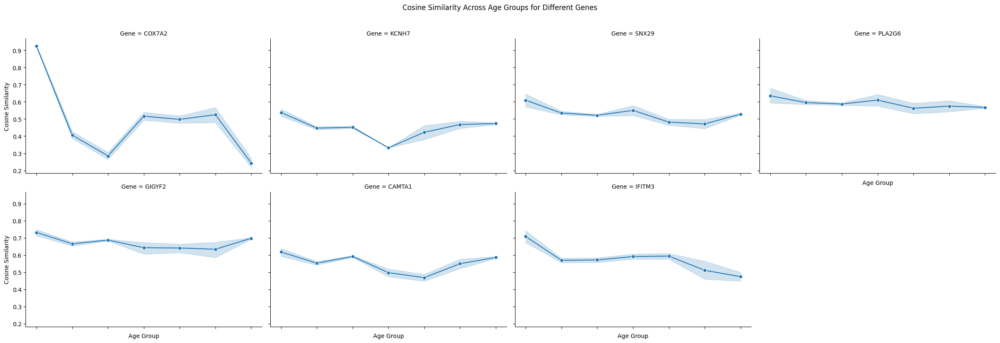

In [ ]:
g = sns.FacetGrid(df, col="Gene", col_wrap=4, height=4, aspect=1.5)  # col_wrap controls number of plots per row

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Rotate x-axis labels for readability
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.savefig("genes_yound&old<0.5_all.png")

In [138]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the FacetGrid with both row for Cell Type and column for Gene
g = sns.FacetGrid(df, row="Cell Type", col="Gene", height=4, aspect=1.5)

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Rotate x-axis labels for readability
for ax in g.axes.flat:
    ax.set_xticks(range(len(age_group_order)))  # Set x-axis ticks based on the number of age groups
    ax.set_xticklabels(age_group_order, rotation=45)  # Set the labels explicitly to age group names

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes and Cell Types', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.savefig("genes_yound&old<1_celltype.png")

In [46]:
import pandas as pd

In [3]:
age_label_mapping_10 = {'1-month-old human stage':"unknown",
 '1-year-old human stage':"unknown",
 '10-month-old human stage':"unknown",
 '10-year-old human stage':"10-20",
 '10th week post-fertilization human stage':"unknown",
 '11-month-old human stage':"unknown",
 '12-year-old human stage':"10-20",
 '12th week post-fertilization human stage':"unknown",
 '13th week post-fertilization human stage':"unknown",
 '14th week post-fertilization human stage':"unknown",
 '15-year-old human stage':"10-20",
 '15th week post-fertilization human stage':"unknown",
 '16-year-old human stage':"10-20",
 '16th week post-fertilization human stage':"unknown",
 '17-year-old human stage':"10-20",
 '17th week post-fertilization human stage':"unknown",
 '18th week post-fertilization human stage':"unknown",
 '19-year-old human stage':"10-20",
 '19th week post-fertilization human stage':"unknown",
 '2-5 year-old child stage':"unknown",
 '2-month-old human stage':"unknown",
 '2-year-old human stage':"unknown",
 '20-year-old human stage':"20-30",
 '20th week post-fertilization human stage':"unknown",
 '21-year-old human stage':"20-30",
 '22-year-old human stage':"20-30",
 '23-year-old human stage':"20-30",
 '24-year-old human stage':"20-30",
 '25-year-old human stage':"20-30",
 '25th week post-fertilization human stage':"unknown",
 '26-year-old human stage':"20-30",
 '27-year-old human stage':"20-30",
 '28-year-old human stage':"20-30",
 '29-year-old human stage':"20-30",
 '3-month-old human stage':"unknown",
 '3-year-old human stage':"unknown",
 '30-year-old human stage':"20-30",
 '31-year-old human stage':"30-40",
 '31st week post-fertilization human stage':"unknown",
 '32-year-old human stage':"30-40",
 '33-year-old human stage':"30-40",
 '34-year-old human stage':"30-40",
 '35-year-old human stage':"30-40",
 '36-year-old human stage':"30-40",
 '37-year-old human stage':"30-40",
 '38-year-old human stage':"30-40",
 '39-year-old human stage':"30-40",
 '4-month-old human stage':"unknown",
 '4-year-old human stage':"unknown",
 '40-year-old human stage':"40-50",
 '41-year-old human stage':"40-50",
 '42-year-old human stage':"40-50",
 '43-year-old human stage':"40-50",
 '44-year-old human stage':"40-50",
 '45-year-old human stage':"40-50",
 '46-year-old human stage':"40-50",
 '47-year-old human stage':"40-50",
 '48-year-old human stage':"40-50",
 '49-year-old human stage':"40-50",
 '5-year-old human stage':"unknown",
 '50-year-old human stage':"40-50",
 '51-year-old human stage':"50-60",
 '52-year-old human stage':"50-60",
 '53-year-old human stage':"50-60",
 '54-year-old human stage':"50-60",
 '55-year-old human stage':"50-60",
 '56-year-old human stage':"50-60",
 '57-year-old human stage':"50-60",
 '58-year-old human stage':"50-60",
 '59-year-old human stage':"50-60",
 '6-12 year-old child stage':"unknown",
 '6-month-old human stage':"unknown",
 '6-year-old human stage':"unknown",
 '60-year-old human stage':"60-70",
 '61-year-old human stage':"60-70",
 '62-year-old human stage':"60-70",
 '63-year-old human stage':"60-70",
 '64-year-old human stage':"60-70",
 '65-year-old human stage':"60-70",
 '66-year-old human stage':"60-70",
 '67-year-old human stage':"60-70",
 '68-year-old human stage':"60-70",
 '69-year-old human stage':"60-70",
 '7-month-old human stage':"unknown",
 '7-year-old human stage':"unknown",
 '70-year-old human stage':"60-70",
 '71-year-old human stage':"70-80",
 '72-year-old human stage':"70-80",
 '73-year-old human stage':"70-80",
 '74-year-old human stage':"70-80",
 '75-year-old human stage':"70-80",
 '76-year-old human stage':"70-80",
 '77-year-old human stage':"70-80",
 '78-year-old human stage':"70-80",
 '79-year-old human stage':"70-80",
 '8-year-old human stage':"unknown",
 '80 year-old and over human stage':">80",
 '80-year-old human stage':">80",
 '81-year-old human stage':">80",
 '82-year-old human stage':">80",
 '83-year-old human stage':">80",
 '84-year-old human stage':">80",
 '85-year-old human stage':">80",
 '86-year-old human stage':">80",
 '87-year-old human stage':">80",
 '88-year-old human stage':">80",
 '89-year-old human stage':">80",
 '9-month-old human stage':"unknown",
 '9-year-old human stage':"unknown",
 '90-year-old human stage':">80",
 '92-year-old human stage':">80",
 '9th week post-fertilization human stage':"unknown",
 'Carnegie stage 17':"unknown",
 'Carnegie stage 18':"unknown",
 'Carnegie stage 20':"unknown",
 'Carnegie stage 22':"unknown",
 'Carnegie stage 23':"unknown",
 'adolescent stage':"unknown",
 'eighth LMP month human stage':"unknown",
 'eighth decade human stage':">80",
 'embryonic human stage':"unknown",
 'fifth LMP month human stage':"unknown",
 'fifth decade human stage':"50-60",
 'fourth decade human stage':"40-50",
 'human adult stage':"unknown",
 'human aged stage':"unknown",
 'infant stage':"unknown",
 'mature stage':"unknown",
 'newborn human stage':"unknown",
 'ninth decade human stage':">80",
 'organogenesis stage':"unknown",
 'seventh decade human stage':"70-80",
 'sixth decade human stage':"60-70",
 'third decade human stage':"30-40",
 'unknown':"unknown",
 'young adult stage':"unknown"}

In [65]:
genes = ['IGHG2',
 'IGKV1-5',
 'IGLC3',
 'IGKV4-1',
 'IGLV1-51',
 'IGHG4',
 'IGHM',
 'IGLC2',
 'IGLL5',
 'IGKV3-20',
 'IGKV3-11',
 'IGHG1',
 'IGLV3-21',
 'IGLV2-14',
 'IGHV4-59',
 'IGKV3-15',
 'IGHV1-18',
 'IGHV3-7',
 'IGLV1-44',
 'IGLV3-1',
 'IGLV2-11',
 'IGHA1',
 'IGHV3-21',
 'IGKV2D-28',
 'IGLV3-25',
 'IGHG3',
 'IGKV1-17',
 'IGKV3D-20',
 'IGHV3-11',
 'IGLV2-23',
 'IGKC',
 'IGLV8-61',
 'IGHV1-3',
 'IGLV4-69',
 'IGHV4-39',
 'IGLV1-47',
 'IGHA2',
 'IGLV6-57',
 'IGKV1-9',
 'IGHV2-5',
 'IGKV1-12',
 'IGHV5-10-1',
 'IGHV2-26',
 'IGLV3-19',
 'IGLV7-46',
 'IGHV3-15',
 'IGHV3-48',
 'IGHV1-2',
 'IGLV3-10',
 'IGKV1D-33',
 'IGHV1-24',
 'IGHV3-30',
 'IGHV3-23',
 'IGHV3-73',
 'IGHV4-34',
 'IGKV2-28',
 'IGHV5-51',
 'IGHV1-46',
 'IGHV4-61',
 'IGLV3-9',
 'IGHV4-4',
 'IGHV3-66',
 'IGHD',
 'IGLV1-36',
 'IGKV1D-43',
 'IGHV4-28',
 'IGHV3-33',
 'IGKV1-33',
 'IGHV4-31',
 'IGHV3-53',
 'IGHV3-13',
 'IGKV1-8',
 'IGKV6D-21',
 'IGKV1D-8',
 'IGLV7-43',
 'IGHGP',
 'IGLV3-16',
 'IGFBP5',
 'IGLV5-52',
 'IGF2',
 'IGDCC3']

data = []
excluded_genes = []

for gene in genes:
    # Check if the gene embedding is present
    present_cells = adata[adata.obs[f'{gene}_embedding_status'] == "present"]
    
    if present_cells.n_obs > 0:  # Ensure there are cells with embeddings
        gene_data = adata2cos_gene(present_cells, gene, age_label_mapping_10, "10-20")
        
        if gene_data is not None:  # Check if adata2cos_gene returned non-empty data
            # Append the data to the list
            data.append({
                'Age Group': gene_data.obs['age_group'].to_list(),
                'Cosine Similarity': gene_data.obs['cosine_similarity_with_<20'].to_list(),
                'Gene': [gene] * len(gene_data)
            })
        else:
            # Add to excluded list if adata2cos_gene returned empty
            excluded_genes.append(gene)
    else:
        # Add to excluded list if no cells had the embedding present
        excluded_genes.append(gene)

# Combine all valid gene data into a DataFrame
df = pd.DataFrame({
    'Age Group': [item for sublist in [d['Age Group'] for d in data] for item in sublist],
    'Cosine Similarity': [item for sublist in [d['Cosine Similarity'] for d in data] for item in sublist],
    'Gene': [item for sublist in [d['Gene'] for d in data] for item in sublist]
})

# Convert the 'Age Group' column to a categorical type with the specified order
age_group_order = ["10-20", "20-30", "40-50","50-60", "60-70", "70-80",">80"]
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)
if excluded_genes:
    print(f"The following genes were excluded due to missing or empty data: {', '.join(excluded_genes)}")
else:
    print("All genes were processed successfully.")

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGHG2
no embedding left for IGKV1-5
no embedding left for IGLC3


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGKV4-1
no embedding left for IGLV1-51
no embedding left for IGHG4


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


no embedding left for IGHM
no embedding left for IGLC2
no embedding left for IGLL5


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGKV3-20
no embedding left for IGKV3-11
no embedding left for IGHG1
no embedding left for IGLV3-21


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGLV2-14
no embedding left for IGHV4-59
no embedding left for IGKV3-15
no embedding left for IGHV1-18
no embedding left for IGHV3-7


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGLV1-44
no embedding left for IGLV3-1
no embedding left for IGLV2-11
no embedding left for IGHA1


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


no embedding left for IGHV3-21
no embedding left for IGKV2D-28
no embedding left for IGLV3-25


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


no embedding left for IGHG3
no embedding left for IGKV1-17
no embedding left for IGKV3D-20
no embedding left for IGHV3-11
no embedding left for IGLV2-23


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGKC
no embedding left for IGLV8-61
no embedding left for IGHV1-3
no embedding left for IGLV4-69
no embedding left for IGHV4-39


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGLV1-47
no embedding left for IGHA2
no embedding left for IGLV6-57
no embedding left for IGKV1-9


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGHV2-5
no embedding left for IGKV1-12
no embedding left for IGHV5-10-1
no embedding left for IGHV2-26
no embedding left for IGLV3-19


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGLV7-46
no embedding left for IGHV3-15
no embedding left for IGHV3-48
no embedding left for IGHV1-2
no embedding left for IGLV3-10


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGKV1D-33
no embedding left for IGHV1-24
no embedding left for IGHV3-30
no embedding left for IGHV3-23
no embedding left for IGHV3-73


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGHV4-34
no embedding left for IGKV2-28
no embedding left for IGHV5-51
no embedding left for IGHV1-46
no embedding left for IGHV4-61


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


no embedding left for IGLV3-9
no embedding left for IGHV4-4
no embedding left for IGHV3-66
no embedding left for IGHD
no embedding left for IGLV1-36


/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGKV1D-43
no embedding left for IGHV4-28
no embedding left for IGHV3-33
no embedding left for IGKV1-33
no embedding left for IGHV4-31


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGHV3-53
no embedding left for IGHV3-13
no embedding left for IGKV1-8
no embedding left for IGKV6D-21
no embedding left for IGKV1D-8


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGLV7-43
no embedding left for IGHGP
no embedding left for IGLV3-16
no embedding left for IGFBP5
no embedding left for IGLV5-52


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age

no embedding left for IGF2
no embedding left for IGDCC3
The following genes were excluded due to missing or empty data: IGHG2, IGKV1-5, IGLC3, IGKV4-1, IGLV1-51, IGHG4, IGHM, IGLC2, IGLL5, IGKV3-20, IGKV3-11, IGHG1, IGLV3-21, IGLV2-14, IGHV4-59, IGKV3-15, IGHV1-18, IGHV3-7, IGLV1-44, IGLV3-1, IGLV2-11, IGHA1, IGHV3-21, IGKV2D-28, IGLV3-25, IGHG3, IGKV1-17, IGKV3D-20, IGHV3-11, IGLV2-23, IGKC, IGLV8-61, IGHV1-3, IGLV4-69, IGHV4-39, IGLV1-47, IGHA2, IGLV6-57, IGKV1-9, IGHV2-5, IGKV1-12, IGHV5-10-1, IGHV2-26, IGLV3-19, IGLV7-46, IGHV3-15, IGHV3-48, IGHV1-2, IGLV3-10, IGKV1D-33, IGHV1-24, IGHV3-30, IGHV3-23, IGHV3-73, IGHV4-34, IGKV2-28, IGHV5-51, IGHV1-46, IGHV4-61, IGLV3-9, IGHV4-4, IGHV3-66, IGHD, IGLV1-36, IGKV1D-43, IGHV4-28, IGHV3-33, IGKV1-33, IGHV4-31, IGHV3-53, IGHV3-13, IGKV1-8, IGKV6D-21, IGKV1D-8, IGLV7-43, IGHGP, IGLV3-16, IGFBP5, IGLV5-52, IGF2, IGDCC3


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/111601724.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [67]:
df

,Age Group,Cosine Similarity,Gene


/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/827932150.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')


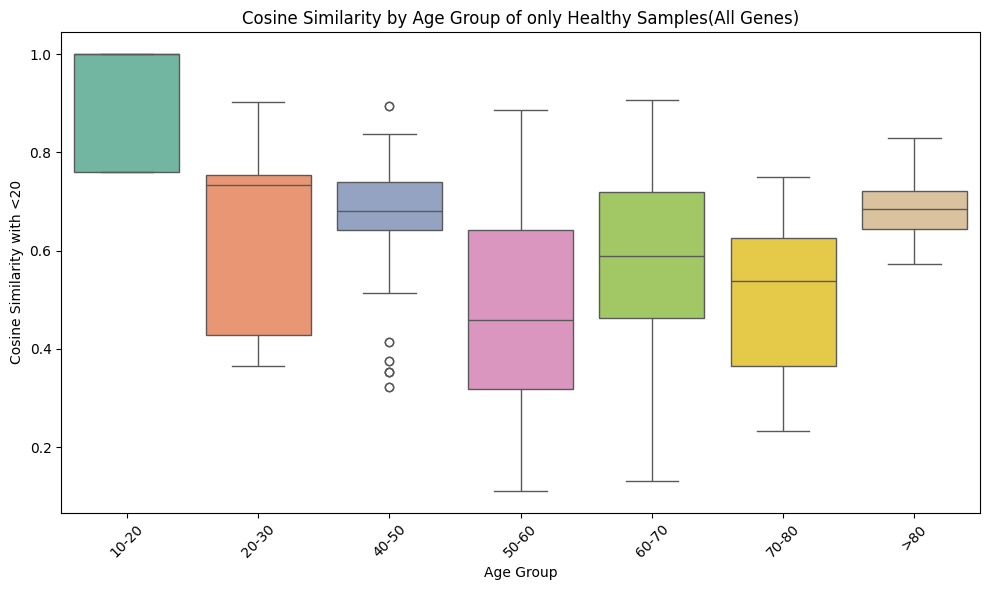

In [58]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')

# Optionally, overlay individual data points
#sns.stripplot(x='Age Group', y='Cosine Similarity', data=df, color='black', alpha=0.3, jitter=True)

# Customize the plot
plt.title('Cosine Similarity by Age Group of only Healthy Samples(All Genes)')
plt.xlabel('Age Group')
plt.ylabel('Cosine Similarity with <20')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/2331572459.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')


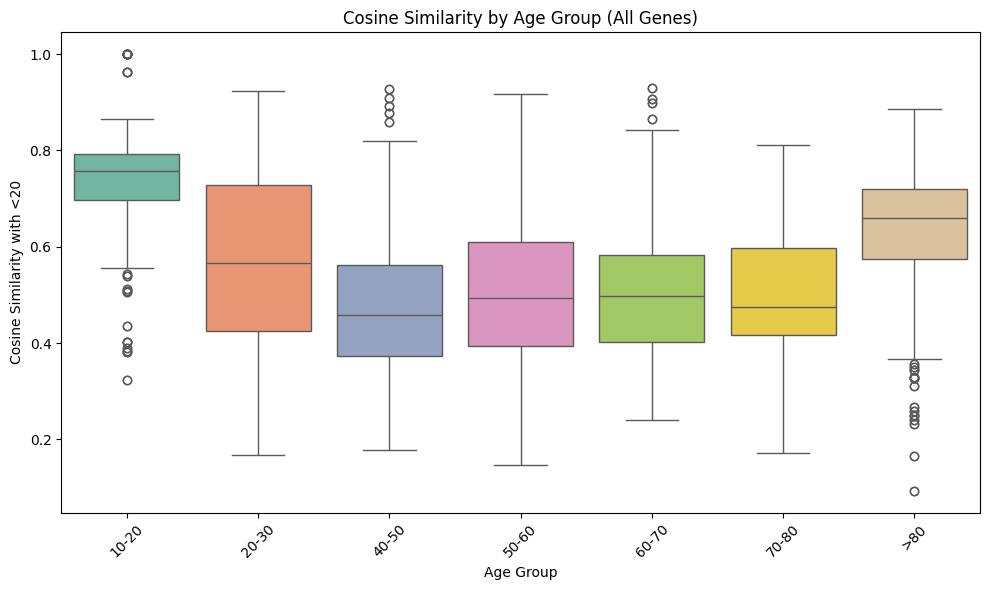

In [54]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')

# Optionally, overlay individual data points
#sns.stripplot(x='Age Group', y='Cosine Similarity', data=df, color='black', alpha=0.3, jitter=True)

# Customize the plot
plt.title('Cosine Similarity by Age Group (All Genes)')
plt.xlabel('Age Group')
plt.ylabel('Cosine Similarity with <20')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/2332224546.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')


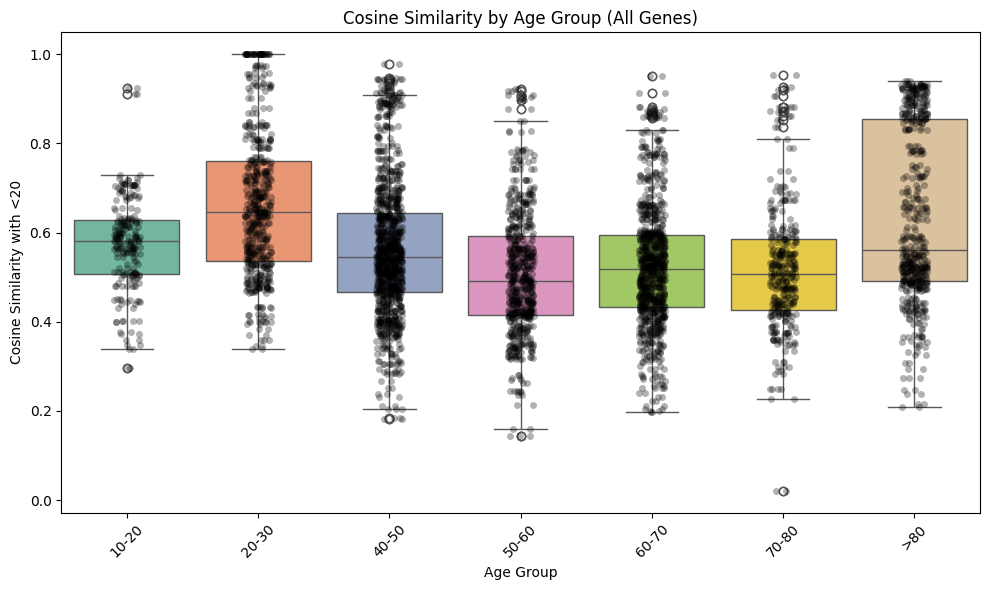

In [51]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Age Group', y='Cosine Similarity', data=df, palette='Set2')

# Optionally, overlay individual data points
sns.stripplot(x='Age Group', y='Cosine Similarity', data=df, color='black', alpha=0.3, jitter=True)

# Customize the plot
plt.title('Cosine Similarity by Age Group (All Genes)')
plt.xlabel('Age Group')
plt.ylabel('Cosine Similarity with <20')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1113/3076230193.py:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)


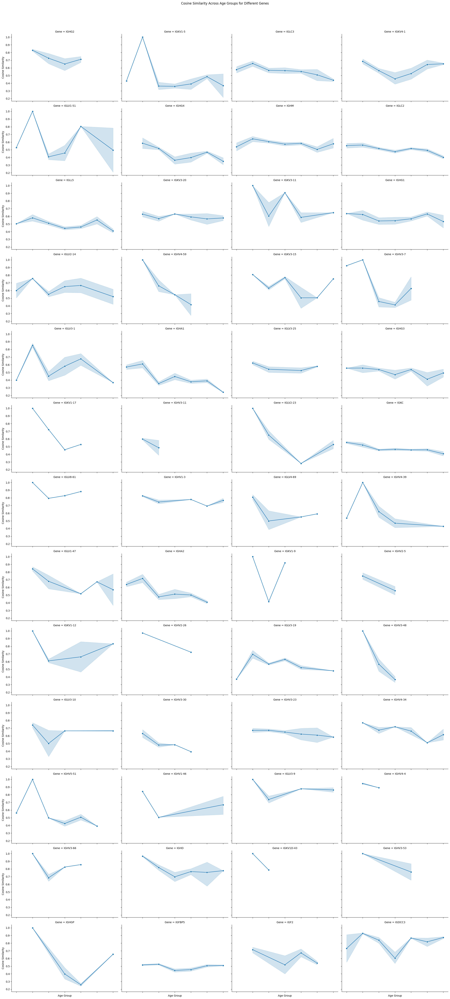

In [49]:
g = sns.FacetGrid(df, col="Gene", col_wrap=4, height=4, aspect=1.5)  # col_wrap controls number of plots per row

# Map the lineplot onto the FacetGrid
g.map(sns.lineplot, "Age Group", "Cosine Similarity", marker='o')

# Rotate x-axis labels for readability
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Add title and adjust layout
g.fig.suptitle('Cosine Similarity Across Age Groups for Different Genes', y=1.02)
g.set_axis_labels('Age Group', 'Cosine Similarity')

# Show the plot
plt.tight_layout()
plt.show()

In [115]:
ZBED1 = adata2cos_gene(adata[adata.obs['ZBED1_embedding_status'] == "present"],"ZBED1", age_label_mapping_10, "20-30")
TRAF5 = adata2cos_gene(adata[adata.obs['TRAF5_embedding_status'] == "present"], "TRAF5", age_label_mapping_10, "20-30")
FBXL19 = adata2cos_gene(adata[adata.obs['FBXL19_embedding_status'] == "present"], "FBXL19", age_label_mapping_10, "20-30")
GSK3A = adata2cos_gene(adata[adata.obs['GSK3A_embedding_status'] == "present"], "GSK3A", age_label_mapping_10, "20-30")

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1077/4136882294.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["age_group"] = adata.obs["development_stage"].map(age_map).to_list()
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/yufanxia/Documents/GitHub/perturbgene/venv/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1077/4136882294.py:20: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['cosine_similarity_with_<20'] = cos_sim_results
/U

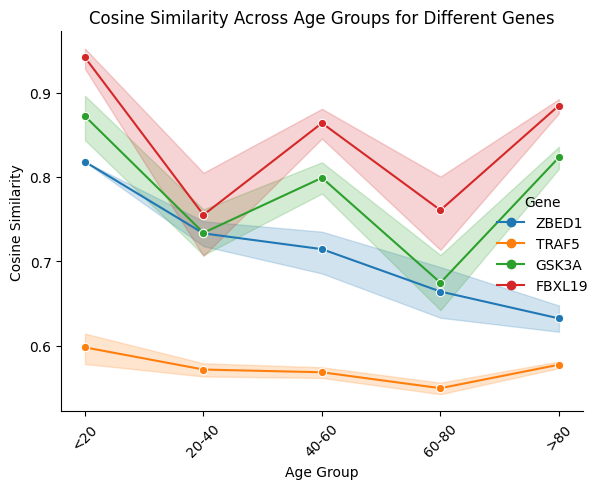

In [57]:
df = pd.DataFrame({
    'Age Group': ZBED1.obs['age_group'].to_list() + TRAF5.obs['age_group'].to_list() + GSK3A.obs['age_group'].to_list() + FBXL19.obs["age_group"].to_list(),
    'Cosine Similarity': ZBED1.obs['cosine_similarity_with_<20'].to_list() + TRAF5.obs['cosine_similarity_with_<20'].to_list()+GSK3A.obs['cosine_similarity_with_<20'].to_list() + FBXL19.obs['cosine_similarity_with_<20'].to_list(),
    'Gene': ["ZBED1"]*len(ZBED1) + ["TRAF5"]*len(TRAF5) + ["GSK3A"]*len(GSK3A) + ["FBXL19"]*len(FBXL19) # Assuming the gene info is stored in obs or manually added
})
age_group_order = ["<20", "20-40", "40-60", "60-80", ">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Plot using sns.relplot
sns.relplot(data=df, x="Age Group", y="Cosine Similarity", kind="line", hue="Gene", marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Cosine Similarity Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show the plot
plt.tight_layout()
plt.show()

In [111]:
ZBED1.obs['age_group'].value_counts().keys()

Index(['>80', '60-70', '50-60', '20-30', '70-80', '40-50', '30-40', '10-20'], dtype='object')

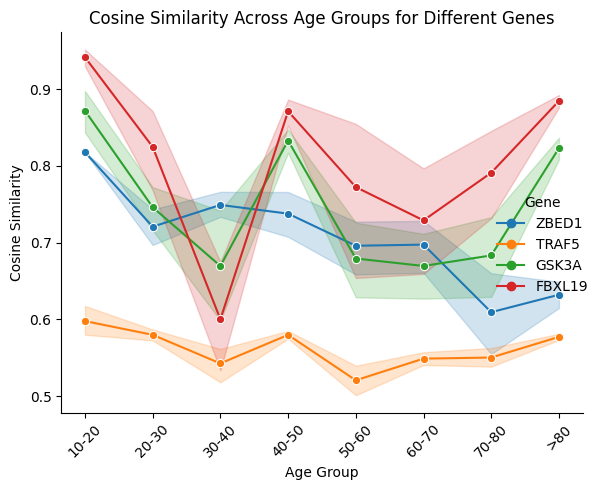

In [113]:
df = pd.DataFrame({
    'Age Group': ZBED1.obs['age_group'].to_list() + TRAF5.obs['age_group'].to_list() + GSK3A.obs['age_group'].to_list() + FBXL19.obs["age_group"].to_list(),
    'Cosine Similarity': ZBED1.obs['cosine_similarity_with_<20'].to_list() + TRAF5.obs['cosine_similarity_with_<20'].to_list()+GSK3A.obs['cosine_similarity_with_<20'].to_list() + FBXL19.obs['cosine_similarity_with_<20'].to_list(),
    'Gene': ["ZBED1"]*len(ZBED1) + ["TRAF5"]*len(TRAF5) + ["GSK3A"]*len(GSK3A) + ["FBXL19"]*len(FBXL19) # Assuming the gene info is stored in obs or manually added
})
age_group_order = ["10-20", "20-30","30-40","40-50", "50-60","60-70","70-80",">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Plot using sns.relplot
sns.relplot(data=df, x="Age Group", y="Cosine Similarity", kind="line", hue="Gene", marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Cosine Similarity Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show the plot
plt.tight_layout()
plt.show()

In [119]:
adata

AnnData object with n_obs × n_vars = 10000 × 58604
    obs: 'soma_joinid_column', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'batch', 'ZBED1_embedding_status', 'TRAF5_embedding_status', 'GSK3A_embedding_status', 'FBXL19_embedding_status'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs', 'feature_type', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'FBXL19_embeddings', 'GSK3A_embeddings', 'TRAF5_embeddi

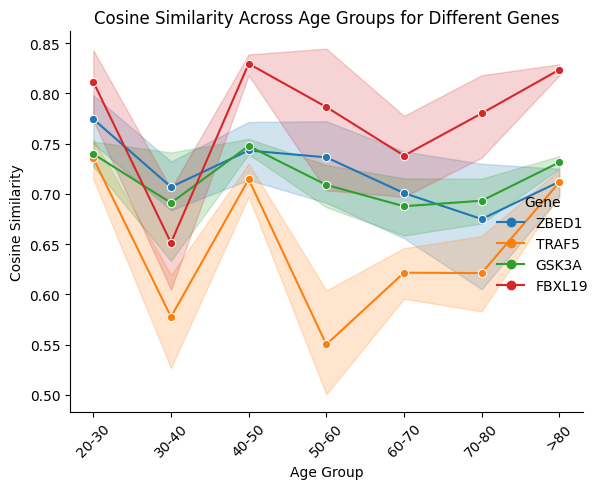

In [117]:
df = pd.DataFrame({
    'Age Group': ZBED1.obs['age_group'].to_list() + TRAF5.obs['age_group'].to_list() + GSK3A.obs['age_group'].to_list() + FBXL19.obs["age_group"].to_list(),
    'Cosine Similarity': ZBED1.obs['cosine_similarity_with_<20'].to_list() + TRAF5.obs['cosine_similarity_with_<20'].to_list()+GSK3A.obs['cosine_similarity_with_<20'].to_list() + FBXL19.obs['cosine_similarity_with_<20'].to_list(),
    'Gene': ["ZBED1"]*len(ZBED1) + ["TRAF5"]*len(TRAF5) + ["GSK3A"]*len(GSK3A) + ["FBXL19"]*len(FBXL19) # Assuming the gene info is stored in obs or manually added
})
age_group_order = ["20-30","30-40","40-50", "50-60","60-70","70-80",">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Plot using sns.relplot
sns.relplot(data=df, x="Age Group", y="Cosine Similarity", kind="line", hue="Gene", marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Cosine Similarity Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show the plot
plt.tight_layout()
plt.show()

In [1]:
df

NameError: name 'df' is not defined

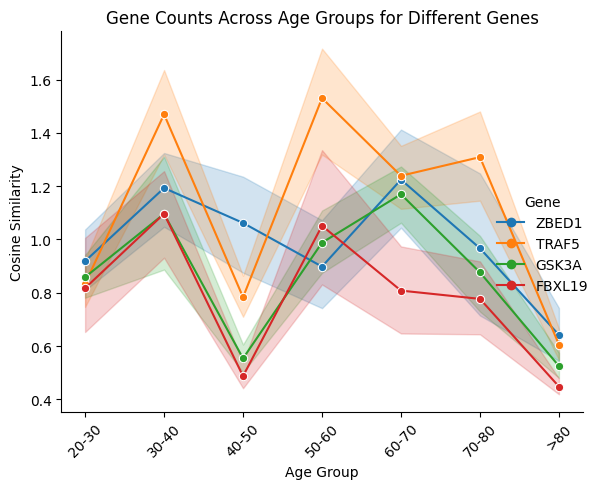

In [118]:
df = pd.DataFrame({
    'Age Group': ZBED1.obs['age_group'].to_list() + TRAF5.obs['age_group'].to_list() + GSK3A.obs['age_group'].to_list() + FBXL19.obs["age_group"].to_list(),
    'Gene Count': np.concatenate([ZBED1.X.todense()[:,51221].A1, TRAF5.X.todense()[:,35521].A1,GSK3A.X.todense()[:,53436].A1,FBXL19.X.todense()[:,54097].A1]),
    'Gene': ["ZBED1"]*len(ZBED1) + ["TRAF5"]*len(TRAF5) + ["GSK3A"]*len(GSK3A) + ["FBXL19"]*len(FBXL19) # Assuming the gene info is stored in obs or manually added
})
age_group_order = ["20-30","30-40","40-50", "50-60","60-70","70-80",">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Plot using sns.relplot
sns.relplot(data=df, x="Age Group", y="Gene Count", kind="line", hue="Gene", marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Gene Counts Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show the plot
plt.tight_layout()
plt.show()

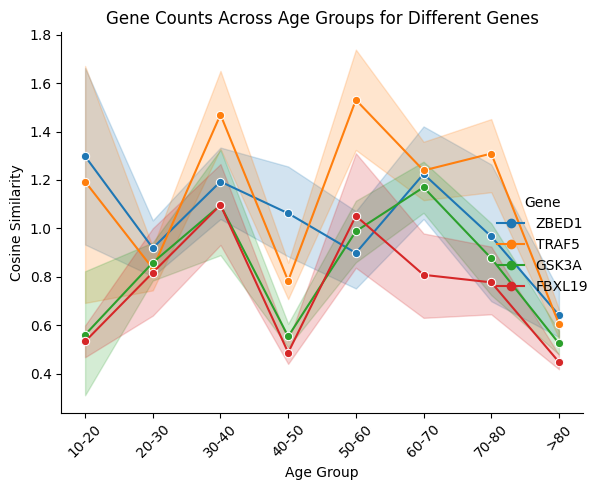

In [114]:
df = pd.DataFrame({
    'Age Group': ZBED1.obs['age_group'].to_list() + TRAF5.obs['age_group'].to_list() + GSK3A.obs['age_group'].to_list() + FBXL19.obs["age_group"].to_list(),
    'Gene Count': np.concatenate([ZBED1.X.todense()[:,51221].A1, TRAF5.X.todense()[:,35521].A1,GSK3A.X.todense()[:,53436].A1,FBXL19.X.todense()[:,54097].A1]),
    'Gene': ["ZBED1"]*len(ZBED1) + ["TRAF5"]*len(TRAF5) + ["GSK3A"]*len(GSK3A) + ["FBXL19"]*len(FBXL19) # Assuming the gene info is stored in obs or manually added
})
age_group_order = ["10-20", "20-30","30-40","40-50", "50-60","60-70","70-80",">80"]

# Convert the 'Age Group' column to a categorical type with the specified order
df['Age Group'] = pd.Categorical(df['Age Group'], categories=age_group_order, ordered=True)

# Plot using sns.relplot
sns.relplot(data=df, x="Age Group", y="Gene Count", kind="line", hue="Gene", marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Gene Counts Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show the plot
plt.tight_layout()
plt.show()

In [38]:
# Group the adata.obs DataFrame by the column 'grouping_column' and compute the mean of 'target_column'
grouped_means = ZBED1.obs.groupby('age_group')['cosine_similarity_with_<20'].mean()

# Print the resulting grouped means
print(grouped_means)


age_group
20-40    0.733049
40-60    0.714337
60-80    0.664055
<20      0.817969
>80      0.632188
Name: cosine_similarity_with_<20, dtype: float64


In [33]:
ZBED1.obs["age_group"].value_counts().keys()

Index(['>80', '60-80', '40-60', '20-40', '<20'], dtype='object')

In [ ]:
for age_label, embeddings in age_group_embeddings.items():
    if age_label == reference_age:
        continue
    # Pairwise cosine similarity between reference and current age label
    cos_sim = cosine_similarity(embeddings, reference_embeddings)
    # Take the mean similarity across all cells
    mean_cosine_similarities[age_label] = cos_sim.mean()
mean_cosine_similarities

{'1-month-old human stage': 0.66741884,
 '1-year-old human stage': 0.5369821,
 '10-month-old human stage': 0.5487526,
 '10-year-old human stage': 0.6910497,
 '10th week post-fertilization human stage': 0.5186709,
 '11-month-old human stage': 0.64975953,
 '12-year-old human stage': 0.628484,
 '12th week post-fertilization human stage': 0.3304863,
 '13th week post-fertilization human stage': 0.3687937,
 '14th week post-fertilization human stage': 0.20338736,
 '15-year-old human stage': 0.6020987,
 '15th week post-fertilization human stage': 0.2973547,
 '16-year-old human stage': 0.60334915,
 '16th week post-fertilization human stage': 0.40690678,
 '17-year-old human stage': 0.58973867,
 '17th week post-fertilization human stage': 0.35843572,
 '18th week post-fertilization human stage': 0.68950325,
 '19-year-old human stage': 0.5912304,
 '19th week post-fertilization human stage': 0.6524743,
 '2-5 year-old child stage': 0.55795,
 '2-month-old human stage': 0.68262935,
 '2-year-old human s

In [ ]:
pd.DataFrame([mean_cosine_similarities, mean_cosine_similarities], index = ["gene1","gene2"])

,1-month-old human stage,1-year-old human stage,10-month-old human stage,10-year-old human stage,10th week post-fertilization human stage,11-month-old human stage,12-year-old human stage,12th week post-fertilization human stage,13th week post-fertilization human stage,14th week post-fertilization human stage,...,infant stage,mature stage,newborn human stage,ninth decade human stage,organogenesis stage,seventh decade human stage,sixth decade human stage,third decade human stage,unknown,young adult stage
gene1,0.667419,0.536982,0.548753,0.69105,0.518671,0.64976,0.628484,0.330486,0.368794,0.203387,...,0.582765,0.649025,0.519861,0.542123,0.62811,0.596381,0.534866,0.557054,0.58547,0.60614
gene2,0.667419,0.536982,0.548753,0.69105,0.518671,0.64976,0.628484,0.330486,0.368794,0.203387,...,0.582765,0.649025,0.519861,0.542123,0.62811,0.596381,0.534866,0.557054,0.58547,0.60614


In [13]:
import numpy as np
import pickle
from sklearn.metrics.pairwise import cosine_similarity

def gene2cos(gene_path, reference_ages, age_labels = validation_data.obs["development_stage"].to_list()):
    # Load gene embeddings from file
    with open(gene_path, 'rb') as f:
        gene1_embeddings = pickle.load(f)

    gene1_embeddings = np.concatenate(gene1_embeddings, axis=0)

    # Exclude embeddings that are all zeros
    non_zero_indices = np.where(np.any(gene1_embeddings != 0, axis=1))[0]
    valid_embeddings = gene1_embeddings[non_zero_indices]
    valid_age_labels = np.array(age_labels)[non_zero_indices]

    # Group cells by age label
    age_group_embeddings = {}
    for age_label in np.unique(valid_age_labels):
        if age_label not in age_group_embeddings:
            age_group_embeddings[age_label] = []
        # Append embeddings for the current age label
        age_group_embeddings[age_label].append(valid_embeddings[valid_age_labels == age_label])

    # Convert lists of embeddings to numpy arrays
    for age_label in age_group_embeddings:
        age_group_embeddings[age_label] = np.vstack(age_group_embeddings[age_label])

    # Initialize dictionary to store cumulative cosine similarities
    cumulative_cosine_similarities = {}

    # Loop over each reference age and accumulate cosine similarities for each age label
    for reference_age in reference_ages:
        # Skip if there are no embeddings for the reference age
        if reference_age not in age_group_embeddings:
            print(f"Skipping {reference_age} as no embeddings found for this age label.")
            continue
        
        reference_embeddings = age_group_embeddings[reference_age]
        
        # Calculate mean cosine similarity for each age label compared to this reference
        for age_label, embeddings in age_group_embeddings.items():
            if age_label == reference_age:
                continue
            # Pairwise cosine similarity between reference and current age label
            cos_sim = cosine_similarity(embeddings, reference_embeddings)
            # Take the mean similarity across all cells
            mean_cos_sim = cos_sim.mean()
            
            # Accumulate cosine similarity for this age label
            if age_label not in cumulative_cosine_similarities:
                cumulative_cosine_similarities[age_label] = []
            cumulative_cosine_similarities[age_label].append(mean_cos_sim)

    # Calculate the final mean for each age label compared to all reference labels
    final_mean_cosine_similarities = {}
    for age_label, similarities in cumulative_cosine_similarities.items():
        final_mean_cosine_similarities[age_label] = np.mean(similarities)

    return final_mean_cosine_similarities, cumulative_cosine_similarities


In [ ]:
def gene2cos(gene_path, reference_age, age_labels = validation_data.obs["development_stage"].to_list()):
    with open(gene_path, 'rb') as f:
        gene1_embeddings = pickle.load(f)

    gene1_embeddings = np.concatenate(gene1_embeddings, axis=0)
    
    #age_labels = validation_data.obs["development_stage"].to_list()

    # Exclude embeddings that are all zeros
    non_zero_indices = np.where(np.any(gene1_embeddings != 0, axis=1))[0]
    valid_embeddings = gene1_embeddings[non_zero_indices]
    valid_age_labels = np.array(age_labels)[non_zero_indices]

    # Group cells by age label
    age_group_embeddings = {}
    for age_label in np.unique(valid_age_labels):
        if age_label not in age_group_embeddings:
            age_group_embeddings[age_label] = []
        # Append embeddings for the current age label
        age_group_embeddings[age_label].append(valid_embeddings[valid_age_labels == age_label])

    # Convert lists of embeddings to numpy arrays
    for age_label in age_group_embeddings:
        age_group_embeddings[age_label] = np.vstack(age_group_embeddings[age_label])

    # Calculate mean cosine similarity
    reference_embeddings = age_group_embeddings[reference_age]
    mean_cosine_similarities = {}

    for age_label, embeddings in age_group_embeddings.items():
        if age_label == reference_age:
            continue
        # Pairwise cosine similarity between reference and current age label
        cos_sim = cosine_similarity(embeddings, reference_embeddings)
        # Take the mean similarity across all cells
        mean_cosine_similarities[age_label] = cos_sim.mean()
    return mean

In [14]:
reference_age = [ '20-year-old human stage',
 '21-year-old human stage',
 '22-year-old human stage',
 '23-year-old human stage',
 '24-year-old human stage',
 '25-year-old human stage',
 '26-year-old human stage',
 '27-year-old human stage',
 '28-year-old human stage','29-year-old human stage']
zbed1 = gene2cos('/Users/yufanxia/Downloads/3562_ZBED1.pkl', reference_age)
traf5 = gene2cos('/Users/yufanxia/Downloads/3562_TRAF5.pkl', reference_age)
mir6750 = gene2cos('/Users/yufanxia/Downloads/3562_MIR6750.pkl', reference_age)
gsk3a = gene2cos('/Users/yufanxia/Downloads/3562_GSK3A.pkl', reference_age)
fbxl19 = gene2cos('/Users/yufanxia/Downloads/3562_FBXL19.pkl', reference_age)

Skipping 20-year-old human stage as no embeddings found for this age label.
Skipping 22-year-old human stage as no embeddings found for this age label.
Skipping 23-year-old human stage as no embeddings found for this age label.
Skipping 27-year-old human stage as no embeddings found for this age label.
Skipping 28-year-old human stage as no embeddings found for this age label.
Skipping 20-year-old human stage as no embeddings found for this age label.
Skipping 21-year-old human stage as no embeddings found for this age label.
Skipping 22-year-old human stage as no embeddings found for this age label.
Skipping 23-year-old human stage as no embeddings found for this age label.
Skipping 28-year-old human stage as no embeddings found for this age label.


In [15]:
df = pd.DataFrame([zbed1[0], traf5[0], mir6750[0], gsk3a[0], fbxl19[0]], index = ["ZBED1", "TRAF5", "MIR6750", "GSK3A", "FBXL19"])
df

,1-month-old human stage,1-year-old human stage,10-month-old human stage,10-year-old human stage,10th week post-fertilization human stage,11-month-old human stage,12-year-old human stage,12th week post-fertilization human stage,13th week post-fertilization human stage,14th week post-fertilization human stage,...,mature stage,newborn human stage,ninth decade human stage,organogenesis stage,seventh decade human stage,sixth decade human stage,third decade human stage,unknown,young adult stage,20-year-old human stage
ZBED1,0.608342,0.620248,0.608406,0.616456,0.515728,0.641244,0.586841,0.438768,0.470258,0.314901,...,0.646714,0.600875,0.604304,0.649794,0.592529,0.585376,0.601245,0.620234,0.588572,0.657775
TRAF5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.291033,0.275972,0.468740,...,0.323620,NaN,NaN,NaN,0.367457,0.379984,0.503388,0.366003,0.409029,NaN
MIR6750,0.507748,NaN,NaN,0.469348,NaN,NaN,0.493970,0.360394,0.343752,0.320089,...,0.375137,NaN,NaN,NaN,0.352139,0.399004,0.389931,0.313013,NaN,NaN
GSK3A,0.393154,0.491804,0.423689,0.194333,0.312866,0.486205,0.201074,0.298112,NaN,0.256409,...,0.501594,0.469673,0.481578,0.540894,0.416502,0.457055,0.497726,0.407412,0.494549,0.478910
FBXL19,0.327302,0.472153,0.405732,0.191542,NaN,0.420818,0.245372,0.298884,0.180436,0.284175,...,0.458505,0.429380,0.419655,0.425868,0.392675,0.429848,0.434463,0.358861,0.448916,0.462724


In [ ]:
df_more = pd.DataFrame([zbed1[1], traf5[1], mir6750[1], gsk3a[1], fbxl19[1]], index = ["ZBED1", "TRAF5", "MIR6750", "GSK3A", "FBXL19"])
df_more

In [79]:
adata.obs["development_stage"].value_counts().keys().to_list()

['unknown',
 '80 year-old and over human stage',
 '15th week post-fertilization human stage',
 'mature stage',
 '17th week post-fertilization human stage',
 'fifth decade human stage',
 'sixth decade human stage',
 '29-year-old human stage',
 '50-year-old human stage',
 '42-year-old human stage',
 '12th week post-fertilization human stage',
 'human adult stage',
 '16th week post-fertilization human stage',
 'seventh decade human stage',
 'eighth decade human stage',
 '18th week post-fertilization human stage',
 '82-year-old human stage',
 '63-year-old human stage',
 '30-year-old human stage',
 '44-year-old human stage',
 '60-year-old human stage',
 '92-year-old human stage',
 '66-year-old human stage',
 '46-year-old human stage',
 '67-year-old human stage',
 '65-year-old human stage',
 '35-year-old human stage',
 '41-year-old human stage',
 '64-year-old human stage',
 '70-year-old human stage',
 '25-year-old human stage',
 '37-year-old human stage',
 '78-year-old human stage',
 '53-yea

In [81]:
age_groups_10 = {'20-30': [ '20-year-old human stage',
 '21-year-old human stage',
 '22-year-old human stage',
 '23-year-old human stage',
 '24-year-old human stage',
 '25-year-old human stage',
 '26-year-old human stage',
 '27-year-old human stage',
 '28-year-old human stage','29-year-old human stage'],
    '30-40': [  '30-year-old human stage',
 '31-year-old human stage',
 '32-year-old human stage',
 '33-year-old human stage',
 '34-year-old human stage',
 '35-year-old human stage',
 '36-year-old human stage',
 '37-year-old human stage',
 '38-year-old human stage',
 '39-year-old human stage',
],
    '40-50': [ '40-year-old human stage',
 '41-year-old human stage',
 '42-year-old human stage',
 '43-year-old human stage',
 '44-year-old human stage',
 '45-year-old human stage',
 '46-year-old human stage',
 '47-year-old human stage',
 '48-year-old human stage',
 '49-year-old human stage',],
    '50-60': ['50-year-old human stage',
 '51-year-old human stage',
 '52-year-old human stage',
 '53-year-old human stage',
 '54-year-old human stage',
 '55-year-old human stage',
 '56-year-old human stage',
 '57-year-old human stage',
 '58-year-old human stage',
 '59-year-old human stage',],
 "60-70":['60-year-old human stage',
 '61-year-old human stage',
 '62-year-old human stage',
 '63-year-old human stage',
 '64-year-old human stage',
 '65-year-old human stage',
 '66-year-old human stage',
 '67-year-old human stage',
 '68-year-old human stage',
 '69-year-old human stage',],
"70-80":['70-year-old human stage',
 '71-year-old human stage',
 '72-year-old human stage',
 '73-year-old human stage',
 '74-year-old human stage',
 '75-year-old human stage',
 '76-year-old human stage',
 '77-year-old human stage',
 '78-year-old human stage',
 '79-year-old human stage',],
 ">80":['80-year-old human stage',
 '81-year-old human stage',
 '82-year-old human stage',
 '83-year-old human stage',
 '84-year-old human stage',
 '85-year-old human stage',
 '86-year-old human stage',
 '87-year-old human stage',
 '88-year-old human stage',
 '89-year-old human stage',
 '90-year-old human stage',
 '92-year-old human stage'],
}
"""
age_exclude = []
for key,value in age_groups.items():
    age_exclude = age_exclude + value
df_filtered = df.drop(columns=[x for x in df.columns if x not in age_exclude])


# Create a new DataFrame to store the mean of each group
grouped_df = pd.DataFrame(index=df_filtered.index)

for group_name, columns in age_groups.items():
    grouped_df[group_name] = df_filtered[columns].mean(axis=1)  # Mean across the columns in each group
grouped_df"""

'\nage_exclude = []\nfor key,value in age_groups.items():\n    age_exclude = age_exclude + value\ndf_filtered = df.drop(columns=[x for x in df.columns if x not in age_exclude])\n\n\n# Create a new DataFrame to store the mean of each group\ngrouped_df = pd.DataFrame(index=df_filtered.index)\n\nfor group_name, columns in age_groups.items():\n    grouped_df[group_name] = df_filtered[columns].mean(axis=1)  # Mean across the columns in each group\ngrouped_df'

In [ ]:
grouped_df

,30-40,40-50,50-60,60-70,70-80,>80
ZBED1,0.610827,0.597297,0.597729,0.609022,0.568546,0.562497
TRAF5,0.439454,0.401616,0.403841,0.385179,0.376344,0.389615
MIR6750,0.322212,0.349654,0.350363,0.400046,0.428412,0.467039


In [29]:
age_stay = []
for key,value in age_groups.items():
    age_stay = age_stay + value
age_stay

['30-year-old human stage',
 '31-year-old human stage',
 '32-year-old human stage',
 '33-year-old human stage',
 '34-year-old human stage',
 '35-year-old human stage',
 '36-year-old human stage',
 '37-year-old human stage',
 '38-year-old human stage',
 '39-year-old human stage',
 '40-year-old human stage',
 '41-year-old human stage',
 '42-year-old human stage',
 '43-year-old human stage',
 '44-year-old human stage',
 '45-year-old human stage',
 '46-year-old human stage',
 '47-year-old human stage',
 '48-year-old human stage',
 '49-year-old human stage',
 '50-year-old human stage',
 '51-year-old human stage',
 '52-year-old human stage',
 '53-year-old human stage',
 '54-year-old human stage',
 '55-year-old human stage',
 '56-year-old human stage',
 '57-year-old human stage',
 '58-year-old human stage',
 '59-year-old human stage',
 '60-year-old human stage',
 '61-year-old human stage',
 '62-year-old human stage',
 '63-year-old human stage',
 '64-year-old human stage',
 '65-year-old human 

In [87]:
age_group_10 = {}
for key,value in age_groups_10.items():
    for i in value:
        age_group_10[i] = key
age_group_10

{'20-year-old human stage': '20-30',
 '21-year-old human stage': '20-30',
 '22-year-old human stage': '20-30',
 '23-year-old human stage': '20-30',
 '24-year-old human stage': '20-30',
 '25-year-old human stage': '20-30',
 '26-year-old human stage': '20-30',
 '27-year-old human stage': '20-30',
 '28-year-old human stage': '20-30',
 '29-year-old human stage': '20-30',
 '30-year-old human stage': '30-40',
 '31-year-old human stage': '30-40',
 '32-year-old human stage': '30-40',
 '33-year-old human stage': '30-40',
 '34-year-old human stage': '30-40',
 '35-year-old human stage': '30-40',
 '36-year-old human stage': '30-40',
 '37-year-old human stage': '30-40',
 '38-year-old human stage': '30-40',
 '39-year-old human stage': '30-40',
 '40-year-old human stage': '40-50',
 '41-year-old human stage': '40-50',
 '42-year-old human stage': '40-50',
 '43-year-old human stage': '40-50',
 '44-year-old human stage': '40-50',
 '45-year-old human stage': '40-50',
 '46-year-old human stage': '40-50',
 

In [39]:
df = df[df["Age Group"].isin(age_stay)]
df = df.replace({"Age Group": new_age_groups})
df

,Gene,Age Group,Cosine Similarity
341,ZBED1,30-40,0.662831
342,ZBED1,30-40,0.564775
343,ZBED1,30-40,0.626697
344,ZBED1,30-40,0.639845
345,ZBED1,30-40,0.620380
...,...,...,...
4511,FBXL19,>80,0.159826
4512,FBXL19,>80,0.142917
4513,FBXL19,>80,0.115679
4514,FBXL19,>80,0.137494


In [56]:
gene_data_dict = {
    'ZBED1':zbed1[1],
    'TRAF5': traf5[1],
    'MIR6750': mir6750[1],
    'GSK3A':gsk3a[1],
    'FBXL19':fbxl19[1]
}
all_data = []
min_max_data = []

for gene, age_data in gene_data_dict.items():
    for age_group, values in age_data.items():
        mean_value = sum(values) / len(values)
        # Append mean values for line plot
        all_data.append([gene, age_group, mean_value])
df = pd.DataFrame( all_data, columns=['Gene', 'Age Group', 'Cosine Similarity'])
df = df[df["Age Group"].isin(age_stay)]
df = df.replace({"Age Group": new_age_groups})
df

ValueError: cannot use columns parameter with orient='columns'

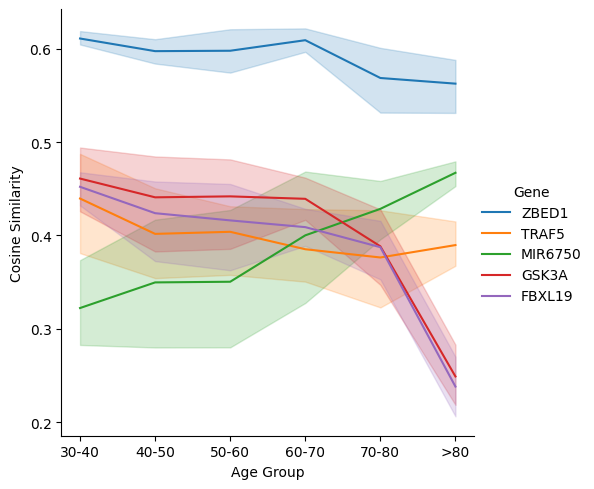

In [51]:
sns.relplot(data=df, x="Age Group", y="Cosine Similarity", kind="line", hue="Gene")

In [6]:
import pickle
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import anndata as ad

In [104]:
import pickle
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import anndata as ad

def gene2cos(gene_path, reference_ages, age_labels = validation_data.obs["development_stage"].to_list()):
    # Load gene embeddings from file
    with open(gene_path, 'rb') as f:
        gene1_embeddings = pickle.load(f)

    gene1_embeddings = np.concatenate(gene1_embeddings, axis=0)

    # Exclude embeddings that are all zeros
    non_zero_indices = np.where(np.any(gene1_embeddings != 0, axis=1))[0]
    valid_embeddings = gene1_embeddings[non_zero_indices]
    valid_age_labels = np.array(age_labels)[non_zero_indices]

    gene_counts = validation_data.X[non_zero_indices]

    # Group cells by age label
    age_group_embeddings = {}
    for age_label in np.unique(valid_age_labels):
        if age_label not in age_group_embeddings:
            age_group_embeddings[age_label] = []
        # Append embeddings for the current age label
        age_group_embeddings[age_label].append(valid_embeddings[valid_age_labels == age_label])

    # Convert lists of embeddings to numpy arrays
    for age_label in age_group_embeddings:
        age_group_embeddings[age_label] = np.vstack(age_group_embeddings[age_label])

    # Initialize dictionary to store cumulative cosine similarities
    cumulative_cosine_similarities = {}

    # Loop over each reference age and accumulate cosine similarities for each age label
    for reference_age in reference_ages:
        # Skip if there are no embeddings for the reference age
        if reference_age not in age_group_embeddings:
            print(f"Skipping {reference_age} as no embeddings found for this age label.")
            continue
        
        reference_embeddings = age_group_embeddings[reference_age]
        
        # Calculate mean cosine similarity for each age label compared to this reference
        for age_label, embeddings in age_group_embeddings.items():
            if age_label == reference_age:
                continue
            # Pairwise cosine similarity between reference and current age label
            cos_sim = cosine_similarity(embeddings, reference_embeddings)
            # Take the mean similarity across all cells
            mean_cos_sim = cos_sim.mean()
            
            # Accumulate cosine similarity for this age label
            if age_label not in cumulative_cosine_similarities:
                cumulative_cosine_similarities[age_label] = []
            cumulative_cosine_similarities[age_label].append(mean_cos_sim)

    # Calculate the final mean for each age label compared to all reference labels
    final_mean_cosine_similarities = {}
    for age_label, similarities in cumulative_cosine_similarities.items():
        final_mean_cosine_similarities[age_label] = np.mean(similarities)

    # Create AnnData object with valid_embeddings
    adata = ad.AnnData(X=gene_counts)

    # Store embeddings in layers
    adata.obsm["embeddings"] = valid_embeddings

    adata.var["feature_name"] = validation_data.var["feature_name"].to_list()

    # Add cosine similarities and age labels to the obs of AnnData
    adata.obs['age_labels'] = valid_age_labels
    adata.obs['cosine_similarity'] = [final_mean_cosine_similarities[age_label] for age_label in valid_age_labels]

    return adata, non_zero_indices

In [105]:
reference_age = [ '20-year-old human stage',
 '21-year-old human stage',
 '22-year-old human stage',
 '23-year-old human stage',
 '24-year-old human stage',
 '25-year-old human stage',
 '26-year-old human stage',
 '27-year-old human stage',
 '28-year-old human stage','29-year-old human stage']
zbed1 = gene2cos('/Users/yufanxia/Downloads/3562_ZBED1.pkl', reference_age)
traf5 = gene2cos('/Users/yufanxia/Downloads/3562_TRAF5.pkl', reference_age)
mir6750 = gene2cos('/Users/yufanxia/Downloads/3562_MIR6750.pkl', reference_age)
gsk3a = gene2cos('/Users/yufanxia/Downloads/3562_GSK3A.pkl', reference_age)
fbxl19 = gene2cos('/Users/yufanxia/Downloads/3562_FBXL19.pkl', reference_age)

Skipping 20-year-old human stage as no embeddings found for this age label.
Skipping 22-year-old human stage as no embeddings found for this age label.
Skipping 23-year-old human stage as no embeddings found for this age label.
Skipping 27-year-old human stage as no embeddings found for this age label.
Skipping 28-year-old human stage as no embeddings found for this age label.
Skipping 20-year-old human stage as no embeddings found for this age label.
Skipping 21-year-old human stage as no embeddings found for this age label.
Skipping 22-year-old human stage as no embeddings found for this age label.
Skipping 23-year-old human stage as no embeddings found for this age label.
Skipping 28-year-old human stage as no embeddings found for this age label.


In [106]:
zbed1[1]

array([   0,    1,    2, ..., 9997, 9998, 9999])

In [97]:
zbed1 = zbed1[zbed1.obs["age_labels"].isin(age_stay)]
df_zbed1 = zbed1.to_df()["51221"]
df_zbed1 

2       0.00000
6       0.00000
7       0.00000
10      0.00000
15      1.15037
         ...   
9578    0.00000
9582    0.00000
9583    0.00000
9584    0.00000
9585    0.00000
Name: 51221, Length: 3579, dtype: float32

In [91]:
"ZBED1" in zbed1.var["feature_name"].to_list()

True

In [94]:
zbed1.var["feature_name"][51221]

'ZBED1'

In [ ]:
sns.relplot(data=, x="Age Group", y="Cosine Similarity", kind="line", hue="Gene")

/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1004/2060480920.py:31: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='Age Group', y='Cosine Similarity', hue='Gene', marker='o', ci=None)
/var/folders/pz/x2v3y0f93k9d3nfx01z18ctr0000gn/T/ipykernel_1004/2060480920.py:34: UserWarning: The palette list has more values (10) than needed (5), which may not be intended.
  sns.scatterplot(data=df, x='Age Group', y='Cosine Similarity', hue='Gene', palette=sns.color_palette(), legend=False)


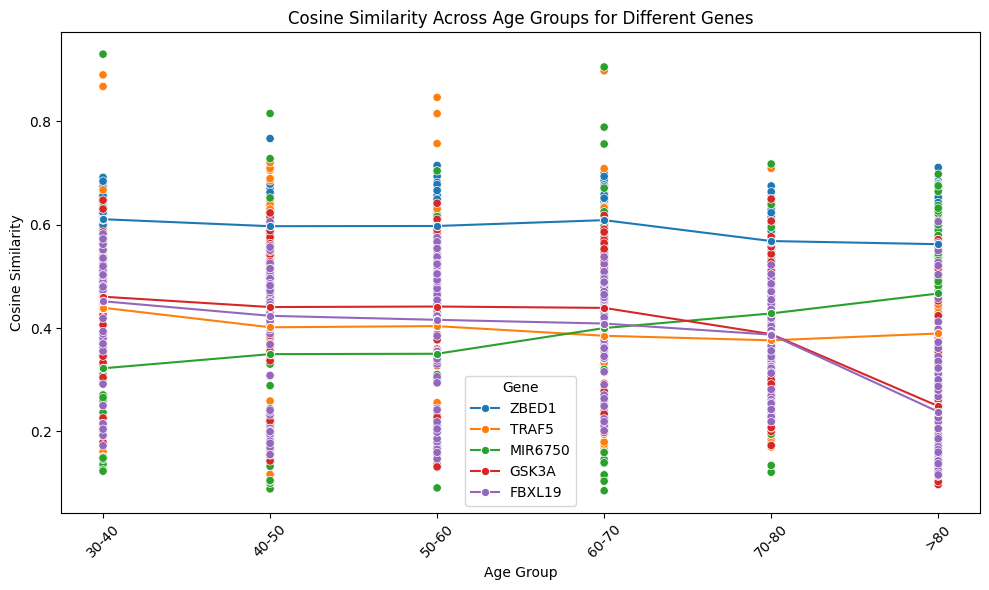

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
zbed1[1], traf5[1], mir6750[1], gsk3a[1], fbxl19[1]
# Example dictionaries with original cosine similarity values for each gene
gene_data_dict = {
    'ZBED1':zbed1[1],
    'TRAF5': traf5[1],
    'MIR6750': mir6750[1],
    'GSK3A':gsk3a[1],
    'FBXL19':fbxl19[1]
}

# Prepare data for plotting
all_data = []

for gene, age_data in gene_data_dict.items():
    for age_group, values in age_data.items():
        for value in values:
            all_data.append([gene, age_group, value])

# Convert data to DataFrame
df = pd.DataFrame(all_data, columns=['Gene', 'Age Group', 'Cosine Similarity'])
df = df[df["Age Group"].isin(age_stay)]
df = df.replace({"Age Group": new_age_groups})

# Plot the data
plt.figure(figsize=(10, 6))

# Line plot with scatter points
sns.lineplot(data=df, x='Age Group', y='Cosine Similarity', hue='Gene', marker='o', ci=None)

# Add scatter plot of original data points with same color
sns.scatterplot(data=df, x='Age Group', y='Cosine Similarity', hue='Gene', palette=sns.color_palette(), legend=False)

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add plot title and labels
plt.title('Cosine Similarity Across Age Groups for Different Genes')
plt.ylabel('Cosine Similarity')
plt.xlabel('Age Group')

# Show plot
plt.tight_layout()
plt.show()


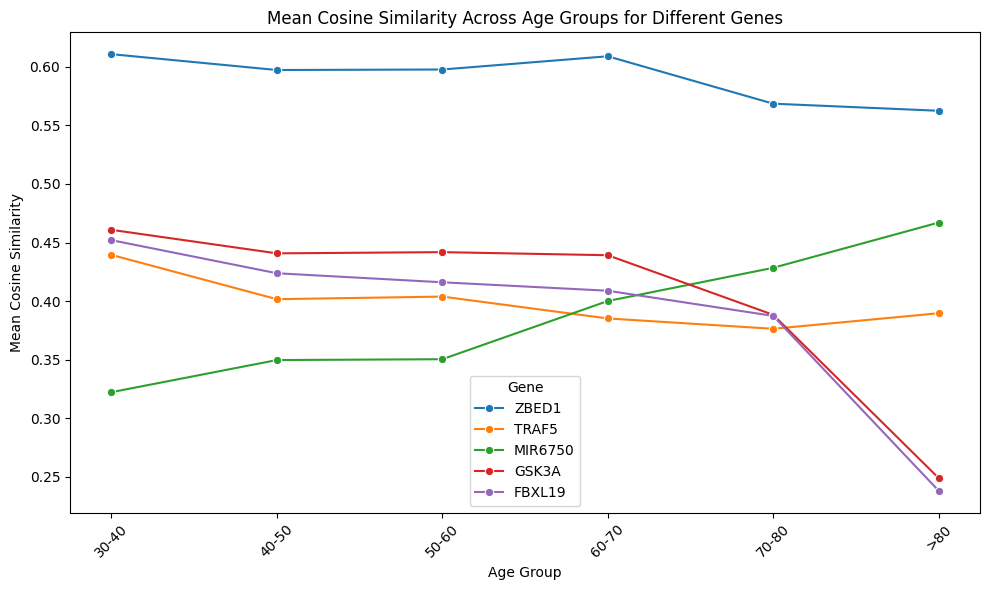

In [18]:
df_melted = grouped_df.reset_index().melt(id_vars='index', var_name='Age Group', value_name='Mean Cosine Similarity')

# Rename columns for clarity
df_melted.rename(columns={'index': 'Gene'}, inplace=True)

# Plot the data using seaborn lineplot
plt.figure(figsize=(10, 6))
sns.lineplot(data=df_melted, x='Age Group', y='Mean Cosine Similarity', hue='Gene', marker='o')

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Add plot title and labels
plt.title('Mean Cosine Similarity Across Age Groups for Different Genes')
plt.ylabel('Mean Cosine Similarity')
plt.xlabel('Age Group')

# Show plot
plt.tight_layout()
plt.show()

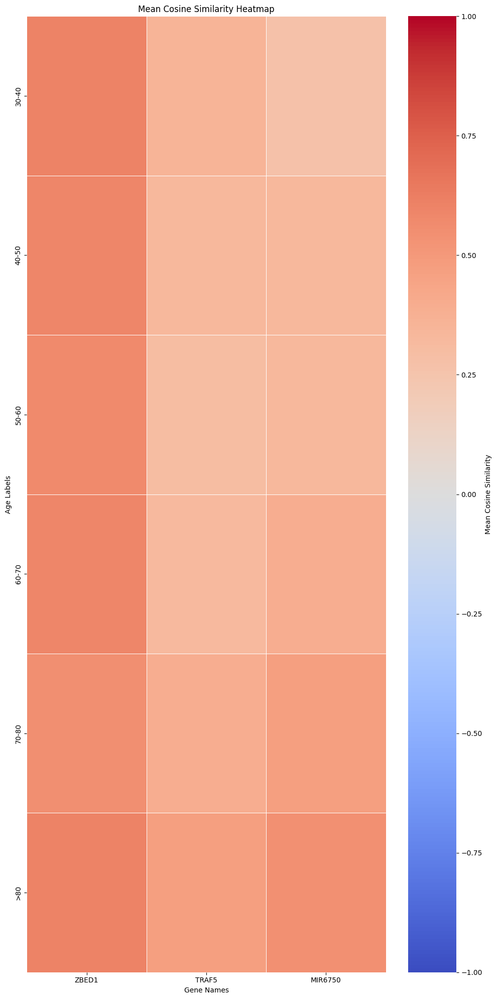

In [ ]:
plt.figure(figsize=(10, 20))
sns.heatmap(grouped_df.T, cmap='coolwarm', vmin=-1, vmax=1, cbar_kws={'label': 'Mean Cosine Similarity'}, 
            mask=grouped_df.T.isna(), linewidths=0.5, linecolor='white')

# Set axis labels and title
plt.xlabel('Gene Names')
plt.ylabel('Age Labels')
plt.title('Mean Cosine Similarity Heatmap')

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
filtered_df = 

plt.figure(figsize=(10, 6))
sns.heatmap(mean_similarity_df, cmap='coolwarm', vmin=-1, vmax=1, cbar_kws={'label': 'Mean Cosine Similarity'})
plt.xlabel('Genes')
plt.ylabel('Age Labels')
plt.title('Mean Cosine Similarity to Reference Age (Young)')
plt.xticks(rotation=90)
plt.show()

In [ ]:
with open('/Users/yufanxia/Downloads/3562_ZBED1.pkl', 'rb') as f:
    gene1_embeddings = pickle.load(f)

gene1_embeddings = np.concatenate(gene1_embeddings, axis=0)
age_labels = validation_data.obs["development_stage"].to_list()

# Reference age label
reference_age = '29-year-old human stage'

# Exclude embeddings that are all zeros
non_zero_indices = np.where(np.any(gene1_embeddings != 0, axis=1))[0]
valid_embeddings = gene1_embeddings[non_zero_indices]
valid_age_labels = np.array(age_labels)[non_zero_indices]

# Group cells by age label
age_group_embeddings = {}
for age_label in np.unique(valid_age_labels):
    if age_label not in age_group_embeddings:
        age_group_embeddings[age_label] = []
    # Append embeddings for the current age label
    age_group_embeddings[age_label].append(valid_embeddings[valid_age_labels == age_label])

# Convert lists of embeddings to numpy arrays
for age_label in age_group_embeddings:
    age_group_embeddings[age_label] = np.vstack(age_group_embeddings[age_label])

# Calculate mean cosine similarity
reference_embeddings = age_group_embeddings[reference_age]
mean_cosine_similarities = {}

for age_label, embeddings in age_group_embeddings.items():
    if age_label == reference_age:
        continue
    # Pairwise cosine similarity between reference and current age label
    cos_sim = cosine_similarity(embeddings, reference_embeddings)
    # Take the mean similarity across all cells
    mean_cosine_similarities[age_label] = cos_sim.mean()

# Prepare data for heatmap
mean_similarity_df = pd.DataFrame.from_dict(mean_cosine_similarities, orient='index', columns=[f'Gene {i+1}' for i in range(valid_embeddings.shape[1])])

mean_similarity_df

ValueError: 768 columns passed, passed data had 570 columns

In [ ]:
def load_pickle(file_path):
    with open(file_path, 'rb') as f:
        return pickle.load(f)

# Load embeddings from pickle files for different genes
with open('/Users/yufanxia/Downloads/3562_ZBED1.pkl', 'rb') as f:
    gene1_embeddings = pickle.load(f)
with open('/Users/yufanxia/Downloads/3562_TRAF5.pkl', 'rb') as f:
    gene2_embeddings = pickle.load(f)
#with open('/Users/yufanxia/Downloads/3562_MIR6750.pkl', 'rb') as f:
    #gene3_embeddings = pickle.load(f)

# Assume age_labels is a list of age labels corresponding to each cell
age_labels = validation_data.obs["development_stage"].to_list()

# Reference age label
reference_age = '29-year-old human stage'

# Combine the two gene embeddings (optional, depending on how you want to handle multi-gene data)
all_embeddings = np.concatenate([gene1_embeddings, gene2_embeddings], axis=1)

# Exclude embeddings that are all zeros
non_zero_indices = np.where(np.any(all_embeddings != 0, axis=1))[0]
valid_embeddings = all_embeddings[non_zero_indices]
valid_age_labels = np.array(age_labels)[non_zero_indices]

"""
# Group cells by age label
age_group_embeddings = {}
for age_label in np.unique(valid_age_labels):
    if age_label not in age_group_embeddings:
        age_group_embeddings[age_label] = []
    # Append embeddings for the current age label
    age_group_embeddings[age_label].append(valid_embeddings[valid_age_labels == age_label])

# Convert lists of embeddings to numpy arrays
for age_label in age_group_embeddings:
    age_group_embeddings[age_label] = np.vstack(age_group_embeddings[age_label])

# Calculate mean cosine similarity
reference_embeddings = age_group_embeddings[reference_age]
mean_cosine_similarities = {}

for age_label, embeddings in age_group_embeddings.items():
    if age_label == reference_age:
        continue
    # Pairwise cosine similarity between reference and current age label
    cos_sim = cosine_similarity(embeddings, reference_embeddings)
    # Take the mean similarity across all cells
    mean_cosine_similarities[age_label] = np.mean(cos_sim, axis=1)

# Prepare data for heatmap
mean_similarity_df = pd.DataFrame.from_dict(mean_cosine_similarities, orient='index', columns=[f'Gene {i+1}' for i in range(valid_embeddings.shape[1])])

mean_similarity_df"""

: 

In [ ]:
# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(mean_similarity_df, cmap='coolwarm', vmin=-1, vmax=1, cbar_kws={'label': 'Mean Cosine Similarity'})
plt.xlabel('Genes')
plt.ylabel('Age Labels')
plt.title('Mean Cosine Similarity to Reference Age (Young)')
plt.xticks(rotation=90)
plt.show()

In [45]:
adata.obsm

AxisArrays with keys: ARHGAP21_embeddings, ATP13A2_embeddings, CACYBP_embeddings, CAMTA1_embeddings, CDKAL1_embeddings, CNTN1_embeddings, CNTN5_embeddings, CNTNAP2_embeddings, COA1_embeddings, COX7A2_embeddings, CUL1_embeddings, EXOC4_embeddings, FBXL19_embeddings, FBXO7_embeddings, FOXJ3_embeddings, GIGYF2_embeddings, GSK3A_embeddings, HIVEP2_embeddings, IFITM3_embeddings, IMMP2L_embeddings, KCNH7_embeddings, LONP2_embeddings, MAGI3_embeddings, MIR99AHG_embeddings, NAGK_embeddings, PARK7_embeddings, PINK1_embeddings, PLA2G6_embeddings, PPP1CB_embeddings, PPP3CA_embeddings, PRKN_embeddings, RBX1_embeddings, SKP1_embeddings, SNX29_embeddings, TRAF5_embeddings, UBAC2_embeddings, ZBED1_embeddings, ZBTB20_embeddings, development_stage_embeddings, tissue_embeddings

In [60]:
adata.obs["FBXO7_embedding_status"]

soma_joinid
27387386    missing
46492259    missing
53966434    missing
3060050     missing
39447246    missing
             ...   
40379221    missing
32787844    missing
3739413     missing
56242973    missing
49468748    missing
Name: FBXO7_embedding_status, Length: 10000, dtype: category
Categories (1, object): ['missing']

In [68]:
fbxo7_embeddings = adata.obsm['FBXO7_embeddings']

# Check if each row (embedding) is all zeros
fbxo7_status = np.any(fbxo7_embeddings == 0, axis=1)

adata.obs['FBXO7_embedding_status'] = [
    "present" if status else "missing" for status in fbxo7_status
]
# False indicates the embedding is valid (not all zeros)
print(adata.obs['FBXO7_embedding_status'].value_counts())

present    10000
Name: FBXO7_embedding_status, dtype: int64


In [7]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

# List of gene names
gene_names = ["RBX1", "FBXO7","CUL1", "SKP1", "PINK1", "PARK7", "GIGYF2", "ATP13A2", "PRKN", "PLA2G6"]

# Initialize a dictionary to store valid embeddings
valid_embeddings = {}

# Filter cells with valid embeddings for each gene
for gene in gene_names:
    # Filter cells where the gene embedding is present
    gene_status = f"{gene}_embedding_status"
    valid_cells = adata.obs[gene_status] == "present"
    
    # Store valid embeddings
    valid_embeddings[gene] = adata.obsm[f"{gene}_embeddings"][valid_cells]

# Initialize a matrix to store cosine similarities
similarity_matrix = np.zeros((len(gene_names), len(gene_names)))

# Compute cosine similarity between gene pairs
for i, gene1 in enumerate(gene_names):
    for j, gene2 in enumerate(gene_names):
        if i <= j:
            # Get the valid embeddings for gene1 and gene2
            embeddings_gene1 = valid_embeddings[gene1]
            embeddings_gene2 = valid_embeddings[gene2]
            
            # Compute cosine similarity
            cos_sim = cosine_similarity(embeddings_gene1, embeddings_gene2)
            
            # Get the mean cosine similarity for the pair
            mean_cos_sim = np.mean(cos_sim)
            
            # Store in the matrix (symmetrical)
            similarity_matrix[i, j] = mean_cos_sim
            similarity_matrix[j, i] = mean_cos_sim

# Output the similarity matrix
print("Cosine similarity matrix:")
print(similarity_matrix)


Cosine similarity matrix:
[[0.57427889 0.50988597 0.52487242 0.47859892 0.48145711 0.51751471
  0.53091109 0.47371933 0.40317121 0.44629341]
 [0.50988597 0.65826833 0.60901815 0.39809799 0.62222648 0.45618671
  0.56589633 0.61552447 0.30392078 0.58567387]
 [0.52487242 0.60901815 0.66819543 0.4134793  0.59528726 0.46994409
  0.60982758 0.60094553 0.34459564 0.54541814]
 [0.47859892 0.39809799 0.4134793  0.5455752  0.35448641 0.50673997
  0.45194009 0.34987599 0.4609715  0.34727314]
 [0.48145711 0.62222648 0.59528726 0.35448641 0.729909   0.42264789
  0.52236086 0.68120664 0.2561684  0.64771533]
 [0.51751471 0.45618671 0.46994409 0.50673997 0.42264789 0.56815541
  0.50004244 0.41347435 0.4576284  0.40273041]
 [0.53091109 0.56589633 0.60982758 0.45194009 0.52236086 0.50004244
  0.63815933 0.5321604  0.41056049 0.4809458 ]
 [0.47371933 0.61552447 0.60094553 0.34987599 0.68120664 0.41347435
  0.5321604  0.71358371 0.25695431 0.62219536]
 [0.40317121 0.30392078 0.34459564 0.4609715  0.256168

In [5]:
import seaborn as sns

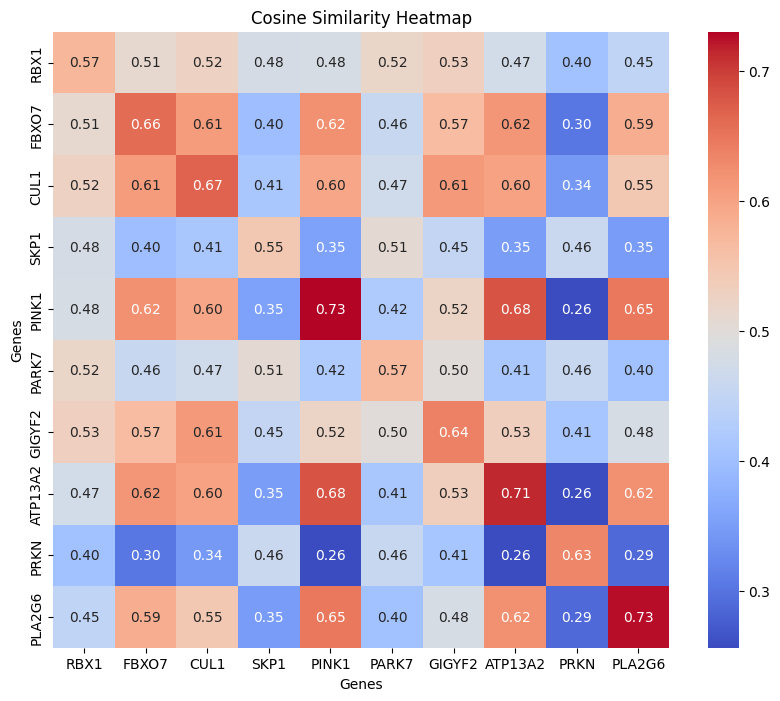

In [8]:
plt.figure(figsize=(10, 8))
sns.heatmap(similarity_matrix, 
            annot=True, 
            fmt=".2f", 
            xticklabels=gene_names, 
            yticklabels=gene_names, 
            cmap='coolwarm', 
            square=True)

# Set the title and labels
plt.title("Cosine Similarity Heatmap")
plt.xlabel("Genes")
plt.ylabel("Genes")

# Show the plot
plt.show()

In [11]:
similarity_matrix

array([[0.57427889, 0.50988597, 0.52487242, 0.47859892, 0.48145711,
        0.51751471, 0.53091109, 0.47371933, 0.40317121, 0.44629341],
       [0.50988597, 0.65826833, 0.60901815, 0.39809799, 0.62222648,
        0.45618671, 0.56589633, 0.61552447, 0.30392078, 0.58567387],
       [0.52487242, 0.60901815, 0.66819543, 0.4134793 , 0.59528726,
        0.46994409, 0.60982758, 0.60094553, 0.34459564, 0.54541814],
       [0.47859892, 0.39809799, 0.4134793 , 0.5455752 , 0.35448641,
        0.50673997, 0.45194009, 0.34987599, 0.4609715 , 0.34727314],
       [0.48145711, 0.62222648, 0.59528726, 0.35448641, 0.729909  ,
        0.42264789, 0.52236086, 0.68120664, 0.2561684 , 0.64771533],
       [0.51751471, 0.45618671, 0.46994409, 0.50673997, 0.42264789,
        0.56815541, 0.50004244, 0.41347435, 0.4576284 , 0.40273041],
       [0.53091109, 0.56589633, 0.60982758, 0.45194009, 0.52236086,
        0.50004244, 0.63815933, 0.5321604 , 0.41056049, 0.4809458 ],
       [0.47371933, 0.61552447, 0.6009455

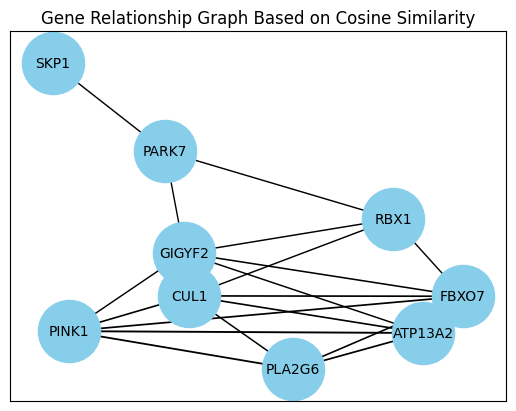

In [15]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Cosine similarity threshold for connecting nodes
threshold = 0.5

# Create a graph
G = nx.Graph()

# Add nodes (genes)
G.add_nodes_from([gene for gene in gene_names if gene != "PRKN"])

# Add edges based on cosine similarity above the threshold
for i, gene1 in enumerate(gene_names):
    for j, gene2 in enumerate(gene_names):
        if i != j and similarity_matrix[i, j] >= threshold:
            # Add an edge with weight equal to the cosine similarity
            G.add_edge(gene1, gene2, weight=similarity_matrix[i, j])

# Draw the graph
pos = nx.spring_layout(G, seed=42)  # Positions for nodes

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color='skyblue', node_size=2000)

# Draw edges with edge thickness based on cosine similarity (weight)
edges = G.edges(data=True)
nx.draw_networkx_edges(
    G, pos, edgelist=[(u, v) for u, v, d in edges], 
    width=[d['weight'] * 2 for u, v, d in edges]  # Scale the weight for better visibility
)

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')

# Display the graph
plt.title("Gene Relationship Graph Based on Cosine Similarity")
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

# Specify the two genes you want to compare
gene1 = 'ZBED1'
gene2 = 'TRAF5'  # Replace with your second gene

# List of age groups to compare
age_groups = ['<20', '20-40', '40-60', '60-80', '>80']

# Initialize a list to store results
cosine_similarities = []

# Loop through each age group and compute cosine similarity between the two genes
for age_group in age_groups:
    # Filter cells that belong to the current age group and have valid embeddings for both genes
    
    age_group_cells = adata[adata.obs['age_group'] == age_group]
    
    if all(f'{gene}_embedding_status' in age_group_cells.obs.columns for gene in [gene1, gene2]):
        # Get the embeddings for both genes
        gene1_embeddings = age_group_cells.obsm[f'{gene1}_embeddings']
        gene2_embeddings = age_group_cells.obsm[f'{gene2}_embeddings']
        
        # Ensure there are valid embeddings
        valid_cells_gene1 = age_group_cells[age_group_cells.obs[f'{gene1}_embedding_status'] == 'present']
        valid_cells_gene2 = age_group_cells[age_group_cells.obs[f'{gene2}_embedding_status'] == 'present']
        
        if valid_cells_gene1.n_obs > 0 and valid_cells_gene2.n_obs > 0:
            # Calculate cosine similarity between the two gene embeddings
            cos_sim = cosine_similarity(gene1_embeddings, gene2_embeddings).mean()
            
            # Append the result
            cosine_similarities.append({
                'age_group': age_group,
                'cosine_similarity': cos_sim
            })

# Convert to DataFrame for easier plotting
cosine_sim_df = pd.DataFrame(cosine_similarities)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(cosine_sim_df['age_group'], cosine_sim_df['cosine_similarity'], marker='o', linestyle='-', color='b', label=f'{gene1} vs {gene2}')
plt.xlabel('Age Group')
plt.ylabel('Cosine Similarity')
plt.title(f'Cosine Similarity Between {gene1} and {gene2} Across Age Groups')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()
